In [1]:
import torch
import pandas as pd

from datasets import Dataset
from transformers import AutoTokenizer, AutoModelForCausalLM
from trl import RLOOConfig, RLOOTrainer
from trl import GRPOConfig, GRPOTrainer

#from llarm.src.environment.reinforcement_learning import calculate_reward, get_prompts
#from llarm.src.environment.reinforcement_learning import get_prompts
from llarm.src.environment import Base
from llarm.src.utility import PyBulletContext
from pybullet import saveState, restoreState
import random
from openai import AzureOpenAI

from llarm.src.workflow.core import WorkflowFunctionSignatureFormatter
from threading import Thread, Event, Lock
from asyncio import run

import os

os.environ["CUDA_VISIBLE_DEVICES"] = "0"

pybullet build time: Jan 29 2025 23:17:20


In [2]:
def format_system_role_content():
    return """
You are a Python 3 code generator. You are the controller of an robotic arm, that uses Python for interaction.
Please write and call your written Python 3 function with the name main for the command. 
Provide the code using python``` and ```.

Example:
    World:
    cube [blue] (size=[0.07, 0.07, 0.07]; center_position=[0.07, 0.11, 0.66])

    Intention:
    Lift blue

    Output:
    python```
    def main():
        move_gripper_to((0.07, 0.11, 0.66))
        close_gripper()
        move_gripper_to((0.07, 0.11, 0.75))

    main()
    ```

Use only the provided functions.
Functions:
{functions_prompt}""".format(
    functions_prompt="\n".join(
        map(
            WorkflowFunctionSignatureFormatter().format,
            [*base.workflow_manager.functions.functions],
        )
    ),
)
    
def format_user_role_content(intention, objects):
    return """
World:
{world_prompt}

Intention:
{intention}""".format(
    world_prompt="\n".join(
        map(
            lambda object: "{name} [{tags}] (size={size}; center_position={center_position})\n".format(
                name="cube",
                tags=", ".join([object["color"]]),
                size=[object["size"], object["size"], object["size"]],
                center_position=object["position"],
            ),
            objects,
        ),
    ),
    intention=intention,
)

def format_prompt(intention, objects):
    return [
        {
            "role": "system",
            "content": format_system_role_content(),
        },
        {
            "role": "user",
            "content": format_user_role_content(intention, objects),
        }
    ]

def generate_lift_train_dataset():
    verbs = [
        "Lift {}", "Pick {}", "Take {}", "Grab {}", "Raise {}",
        "Hoist {}", "Fetch {}", "Collect {}", "Retrieve {}", "Grasp {}",
        "Seize {}", "Get {}", "Acquire {}", "Carry {}", "Hold {}",
    ]
    data = []

    for verb in verbs:
        for _i in range(2):
            colors = [
                "red",
                "blue",
                "green",
            ]
            random.shuffle(colors)
            
            objects = []
            object_size = 0.07
            maximum_attemps = 100
            
            for i in range(random.randrange(1, 4)):
                placed = False

                for _ in range(maximum_attemps):
                    x = round(random.uniform(-0.30, 0.1), 2)
                    y = round(random.uniform(-0.35, 0.35), 2)

                    intersection = False

                    for object in objects:
                        if (x - object["position"][0]) ** 2 + (y - object["position"][1]) ** 2 < object_size:
                            intersection = True
                            break
    
                    if intersection is False:
                        placed = True

                if placed:
                    objects.append(
                        {
                            "position": [x, y, 0.66],
                            "color": colors[i],
                            "size": object_size,
                        },
                    )

            intention = verb.format(colors[0])
            
            data.append({
                "method_args": {
                    "objects": objects,
                    "intention_verb": verb,
                    "intention_object": colors[0],
                    "intention": intention,
                },
                "prompt": format_prompt(intention, objects),
            })
            
    return data

def generate_simple_train_dataset():
    data = []
    
    for _i in range(10):
        data.append(
            {
                "method_args": {
                    "objects": [],
                    "intention": "Do nothing",
                },
                "prompt": format_prompt("Do nothing", []),
            }
        )

    return data

def generate_train_dataset():
    return pd.DataFrame([
        #*generate_simple_train_dataset(),
        *generate_lift_train_dataset(),
    ])

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model_name = "Qwen/Qwen3-0.6B"
#model_name = "Qwen/Qwen3-4B-Instruct-2507"

tokenizer = AutoTokenizer.from_pretrained(model_name, cache_dir="/tf/llms/")
tokenizer.pad_token = tokenizer.eos_token
        
model = AutoModelForCausalLM.from_pretrained(model_name, cache_dir="/tf/llms/")
model = model.to(device)

from transformers import Qwen2_5_VLForConditionalGeneration, AutoTokenizer, AutoProcessor
from qwen_vl_utils import process_vision_info

model = Qwen2_5_VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2.5-VL-3B-Instruct", dtype="auto", device_map="auto"
)

processor = AutoProcessor.from_pretrained("Qwen/Qwen2.5-VL-3B-Instruct")

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

The image processor of type `Qwen2VLImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. Note that this behavior will be extended to all models in a future release.


In [4]:
def extract_with_marker(output):
    marker = "```"

    left_markers = [marker + "python3", marker + "python", marker]
    right_marker = marker

    output = output.strip("\n\r ")

    start = None
    start_padding = None

    for left_marker in left_markers:
        index = output.find(left_marker)

        if index < 0:
            continue

        start = index
        start_padding = len(left_marker)

        break

    if start is None:
        return None

    end = output.find(right_marker, start + start_padding)
    if end < 0:
        end = len(output)

    if end is None:
        return None

    return output[start + start_padding:end]

def calculate_reward(base, llm_completion, **kwargs):
    base.reload_objects(kwargs['objects'])
    llm_completion = extract_with_marker(llm_completion)

    if llm_completion is None:
        return -1, "extraction"

    event = Event()
    execution = {"value": None}
    
    def evaluate():
        try:
            execution["value"] = run(base.workflow_manager.execute(llm_completion, timeout_in_seconds=5))
        except TimeoutError as e:
            execution["value"] = "timeout"
        except Exception as e:
            execution["value"] = "exception"
            execution["exception"] = e
        finally:
            event.set()
    
    def update():
        while not event.is_set():
            base.update()
    
    evaluate_thread = Thread(target=evaluate)
    evaluate_thread.start()
    
    update_thread = Thread(target=update)
    update_thread.start()

    evaluate_thread.join()
    update_thread.join()

    image = base.create_front_image(width=640, height=480)
    base.show_image(image)

    if execution["value"] == "timeout":
        return -1, "timeout"
        
    if execution["value"] == "exception":
        return -1, "exception ({})".format(execution["exception"])

    from PIL import Image, ImageDraw
    from io import BytesIO
    from base64 import b64encode

    width = 640
    height = 480
        
    #image = base.create_front_image()
    img = Image.fromarray(image)
    buffer = BytesIO()
    img.save(buffer, format="JPEG")
    img_base64 = b64encode(buffer.getvalue()).decode("utf-8")
    image_data = f"data:image/jpeg;base64,{img_base64}"

    if False:
        text = """A robotic gripper arm had the following task:
{}
    
Please answer with 'yes' or 'no' only, whether the robotic arm addressed the intention correctly.""".format(
            kwargs["intention"]
        )
    
        response = client.chat.completions.create(
            model="gpt-4.1-mini",
            messages=[
                {
                    "role": "user",
                    "content": [
                        {"type": "text", "text": text},
                        {"type": "image_url", "image_url": {"url": image_data}},
                    ]
                }
            ]
        )
    
        if response.choices[0].message.content.strip().lower() == "yes":
            return 1
    
    text = """A robotic gripper arm had the following task:
{}
    
Please answer with 'yes' or 'no' only, whether the robotic arm addressed the intention correctly.""".format(
        kwargs["intention"]
    )
    
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "image", "image": image_data},
                {"type": "text", "text": text},
            ],
        }
    ]

    text = processor.apply_chat_template(
        messages, tokenize=False, add_generation_prompt=True
    )
    image_inputs, video_inputs = process_vision_info(messages)
    inputs = processor(
        text=[text],
        images=image_inputs,
        videos=video_inputs,
        padding=True,
        return_tensors="pt",
    )
    inputs = inputs.to("cuda")
    
    generated_ids = model.generate(**inputs, max_new_tokens=128)
    generated_ids_trimmed = [
        out_ids[len(in_ids) :] for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
    ]
    output_text = processor.batch_decode(
        generated_ids_trimmed, skip_special_tokens=True, clean_up_tokenization_spaces=False
    )

    if output_text[0].strip().lower() != "yes":
        return 0, "vlm ({})".format(output_text[0])
    
    return 1, None

def reward_function(completions, prompts, method_args, **kwargs):
    rewards = []
    for i, (compl, args) in enumerate(zip(completions, method_args)):
        reason = None
        
        if compl:
            reward, reason = calculate_reward(base, compl, **args)
        else:
            reward = 0
        rewards.append(reward)
        #print(compl)

        #print(prompts[i])
        #print(f"[Reward Debug] | Completion: {compl} | "
        #      f"Target: {args} | Reward: {reward}\n")
        print("Intention: {}; Reward: {}; Reason: {}".format(args["intention"], reward, reason))
    return rewards

In [5]:
def tokenize_dataset(tokenizer, train_dataset):
    train_dataset['prompt'] =  train_dataset['prompt'].apply(
        lambda prompt: tokenizer.apply_chat_template(
            prompt,
            tokenize=False,
            add_generation_prompt=True,
        )
    )

    return Dataset.from_pandas(train_dataset)

In [6]:
 # Training
"""
training_args = RLOOConfig(
    output_dir="Qwen3-0.6B-RLOO",
    learning_rate=1e-4,
    log_completions=True,
    num_completions_to_print=1,
    logging_strategy="steps",
    logging_steps=1,
    eval_steps=1,
    save_strategy="no",
    gradient_accumulation_steps=2,
    use_vllm=False,
    run_name="Qwen3-0.6B-RLOO-Test",

    max_prompt_length=256,
    max_completion_length=256,
    temperature=0.6,
    top_p=0.95,
    max_steps=10,
    steps_per_generation=1,
    num_generations=2
)
"""

training_args = GRPOConfig(
    gradient_accumulation_steps=2,
    max_prompt_length=1024,
    max_completion_length=1024,
    generation_batch_size=16,
    num_generations=2,
    num_train_epochs=10,
    logging_steps=1,
    logging_strategy="steps",
)

client = AzureOpenAI(
    api_version="2024-12-01-preview",
    azure_endpoint="",
    api_key=""
)

The tokenizer has new PAD/BOS/EOS tokens that differ from the model config and generation config. The model config and generation config were aligned accordingly, being updated with the tokenizer's values. Updated tokens: {'bos_token_id': None, 'pad_token_id': 151645}.


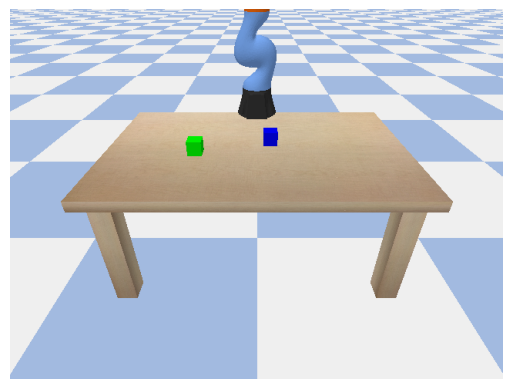

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


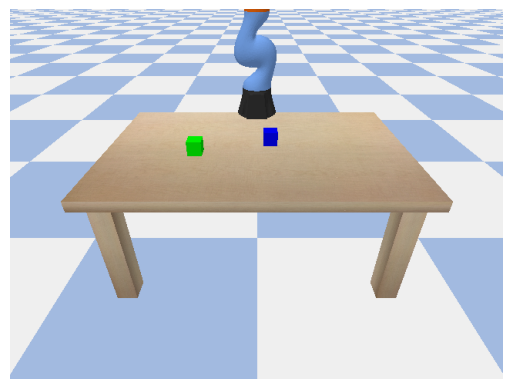

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


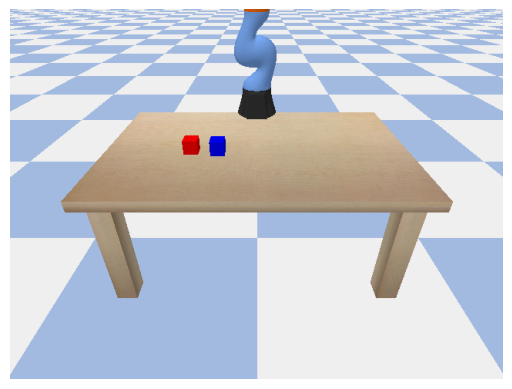

Intention: Lift blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


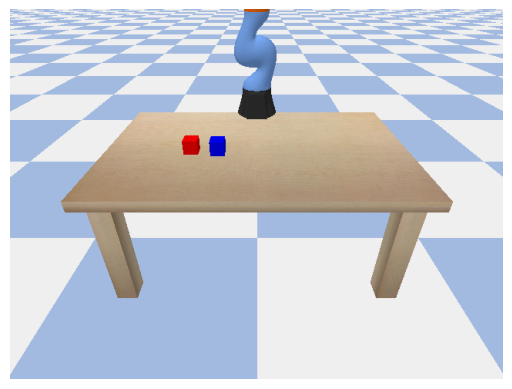

Intention: Lift blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


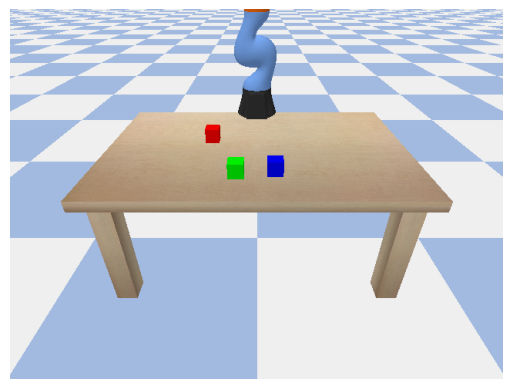

/tf/trl/trl-venv/lib/python3.11/site-packages/torch/utils/checkpoint.py:85: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(
`use_cache=True` is incompatible with gradient checkpointing. Setting `use_cache=False`...
Caching is incompatible with gradient checkpointing in Qwen2_5_VLDecoderLayer. Setting `past_key_values=None`.


Intention: Grab red; Reward: 1; Reason: None


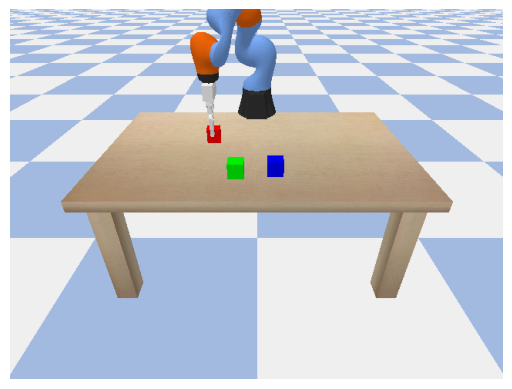

Intention: Grab red; Reward: 1; Reason: None


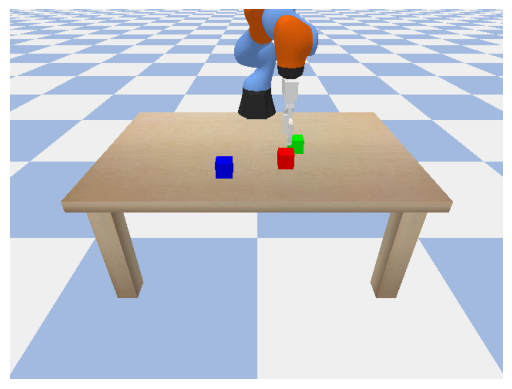

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


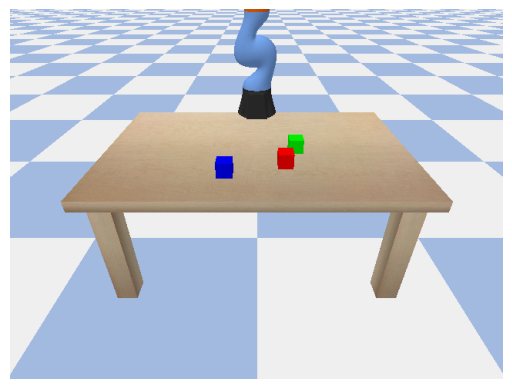

Intention: Acquire red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


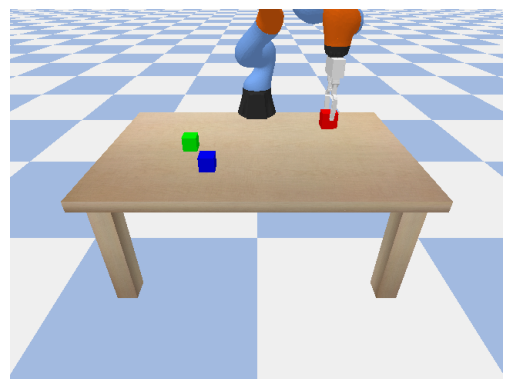

Intention: Raise red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


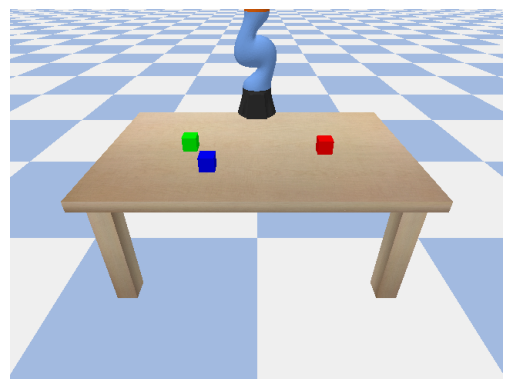

Intention: Raise red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


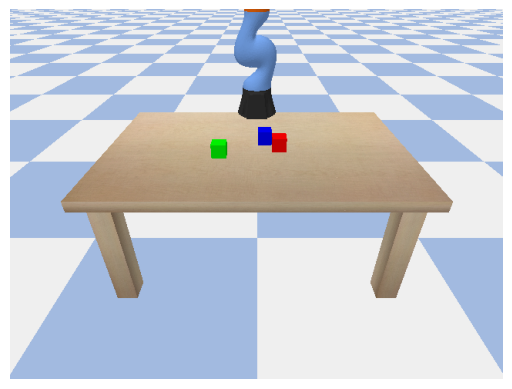

Intention: Collect blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Collect blue; Reward: -1; Reason: extraction


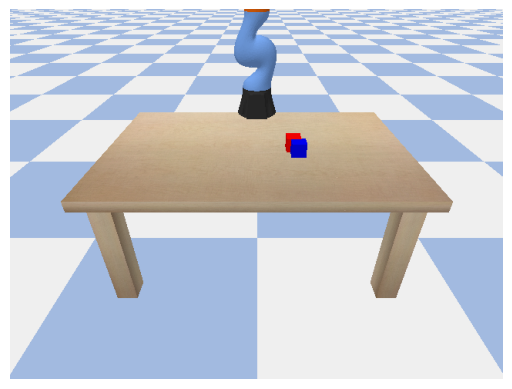

Intention: Hoist red; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


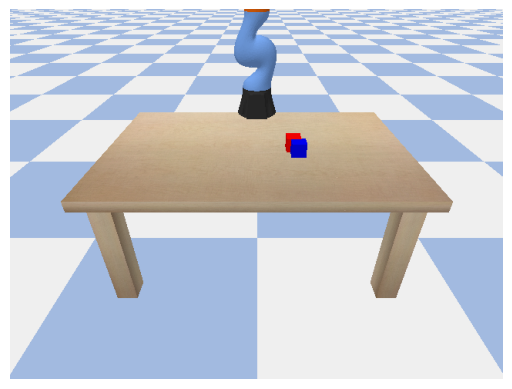

Intention: Hoist red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))
Grasp red ...


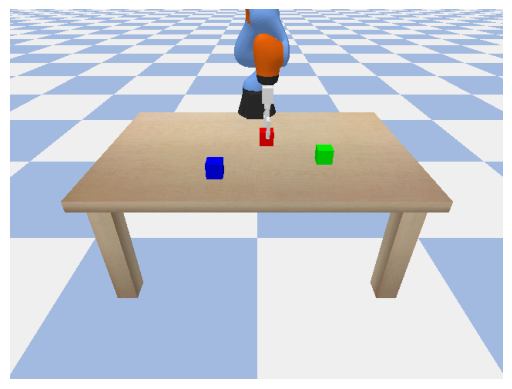

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


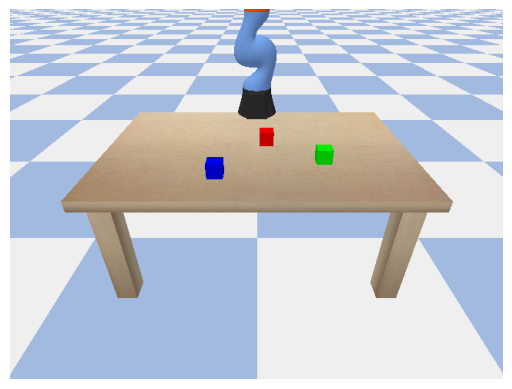

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


Step,Training Loss
1,-0.078800
2,-0.056100
3,0.000000
4,0.152600
5,0.080100
6,0.024300
7,0.152900
8,0.492200
9,0.156800
10,-0.011200


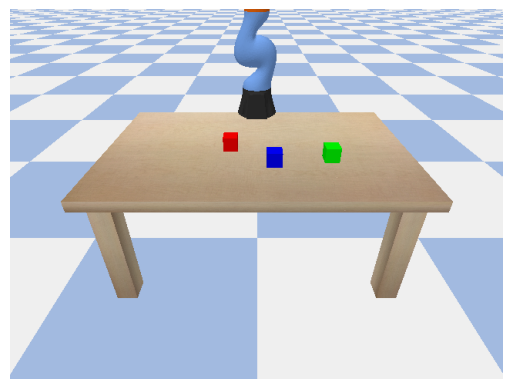

Intention: Retrieve blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


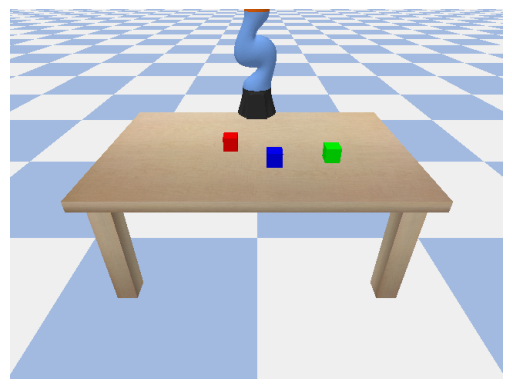

Intention: Retrieve blue; Reward: 0; Reason: vlm (No)
Intention: Get red; Reward: -1; Reason: extraction
Intention: Get red; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction


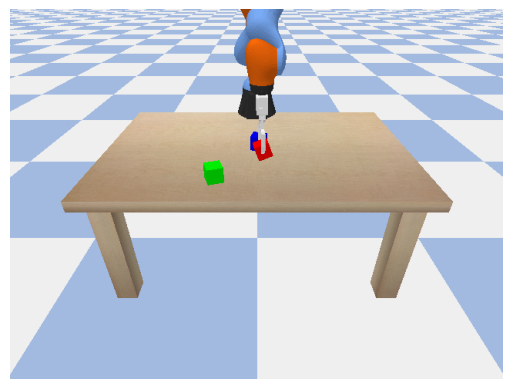

Intention: Carry blue; Reward: 0; Reason: vlm (No)


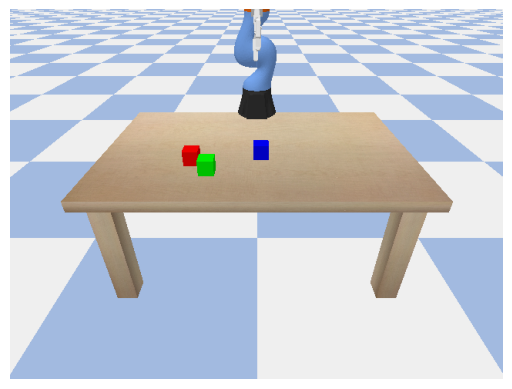

Intention: Carry blue; Reward: -1; Reason: exception (name 'carry_cube' is not defined)
Intention: Seize green; Reward: -1; Reason: extraction
Intention: Seize green; Reward: -1; Reason: extraction


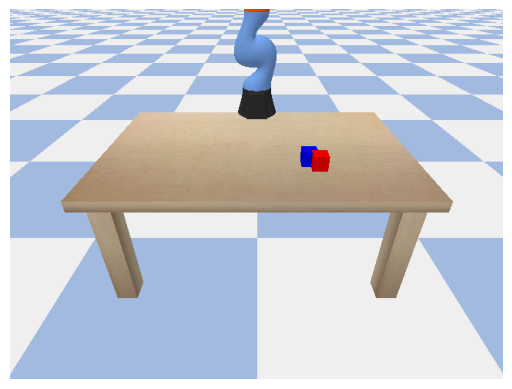

Intention: Grab blue; Reward: 0; Reason: vlm (No)


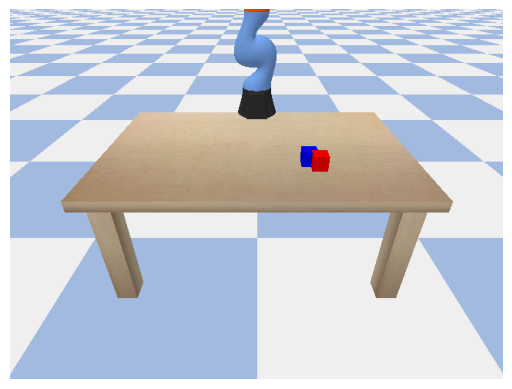

Intention: Grab blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


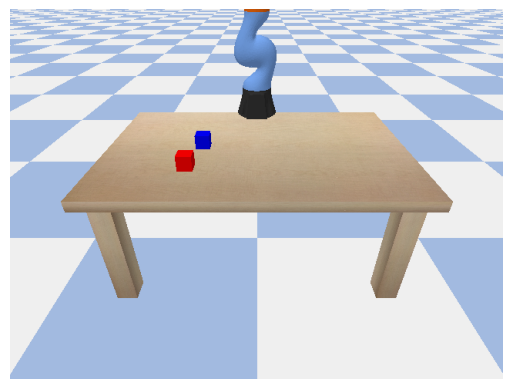

Intention: Seize red; Reward: -1; Reason: exception (invalid character '−' (U+2212) (<unknown>, line 3))


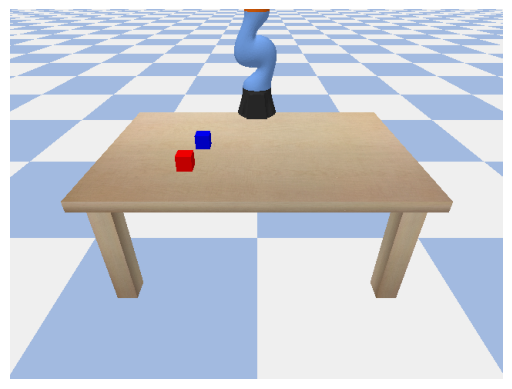

Intention: Seize red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


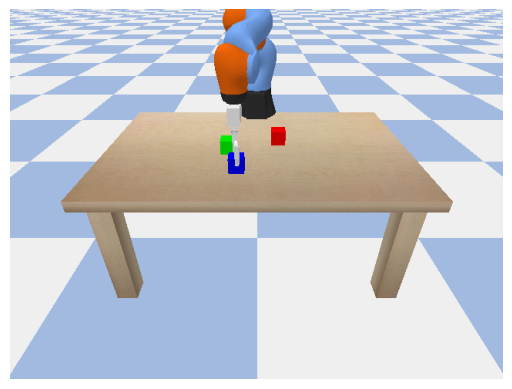

Intention: Get blue; Reward: 1; Reason: None


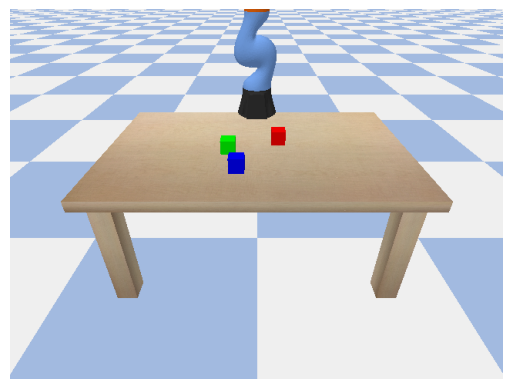

Intention: Get blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


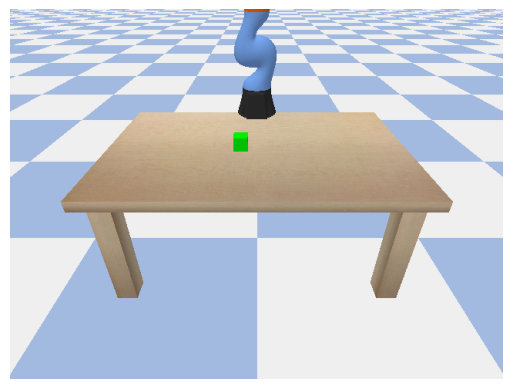

Intention: Hold green; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


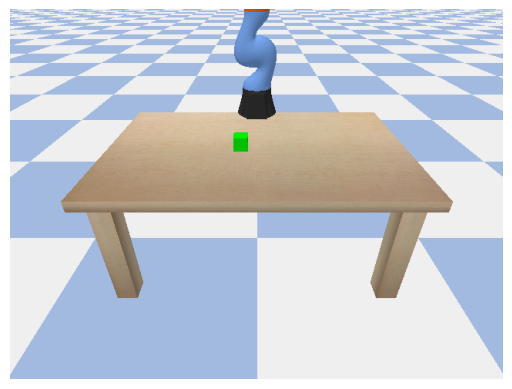

Intention: Hold green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


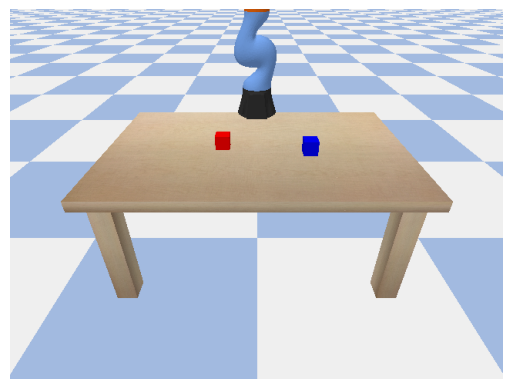

Intention: Fetch blue; Reward: -1; Reason: exception (closing parenthesis ']' does not match opening parenthesis '(' (<unknown>, line 3))


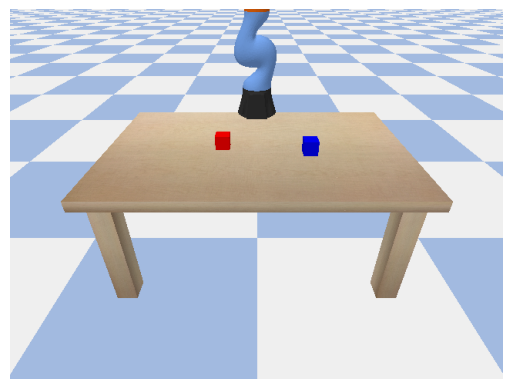

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


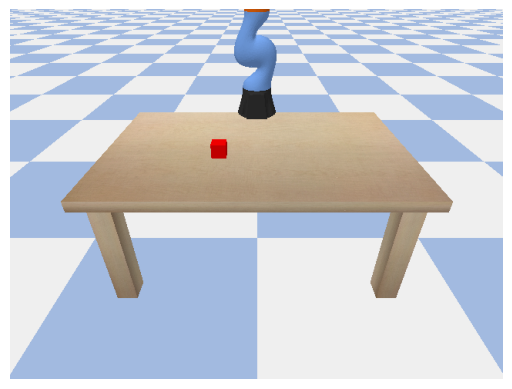

Intention: Collect red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


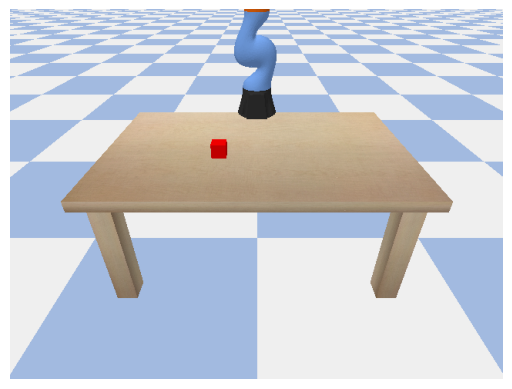

Intention: Collect red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


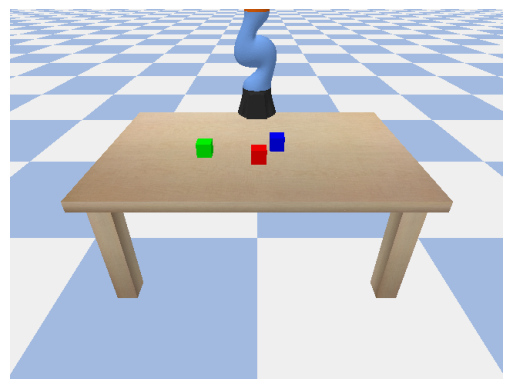

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


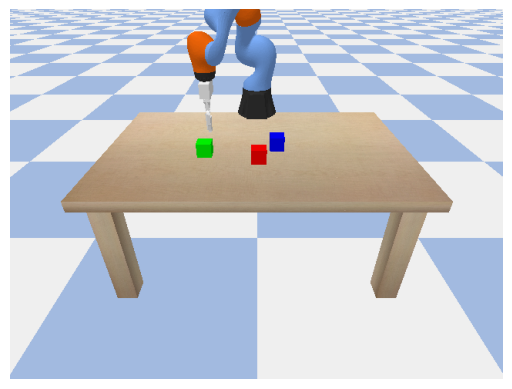

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


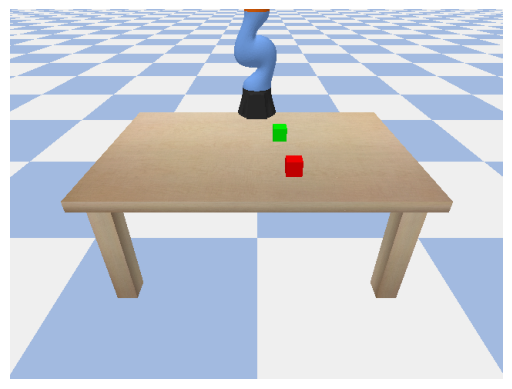

Intention: Take red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


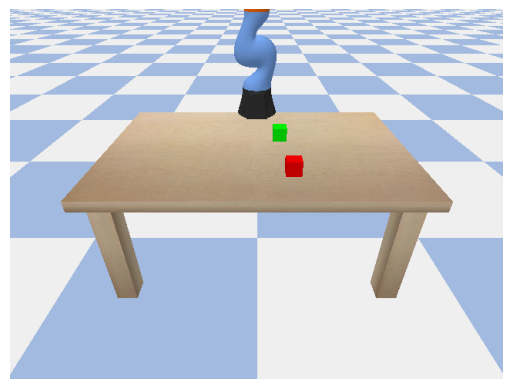

Intention: Take red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


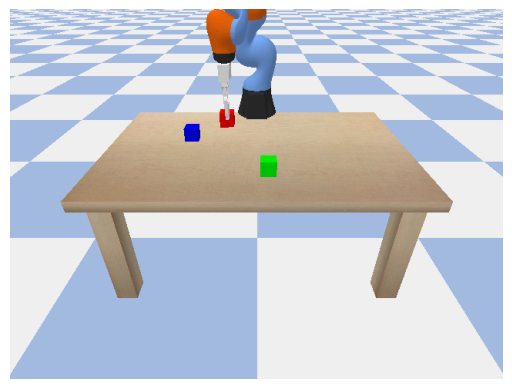

Intention: Lift red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


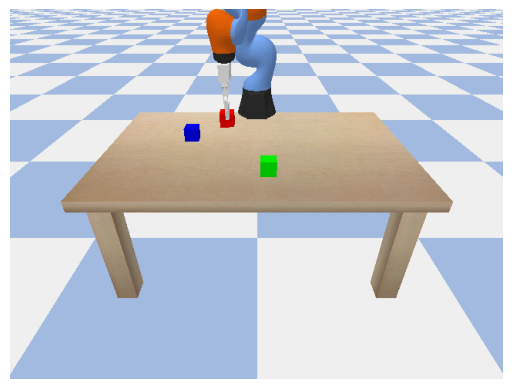

Intention: Lift red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


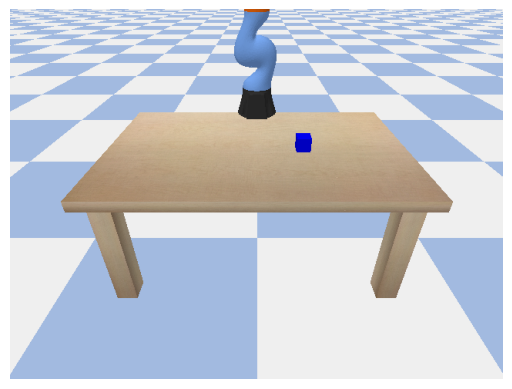

Intention: Raise blue; Reward: -1; Reason: exception ('[' was never closed (<unknown>, line 2))


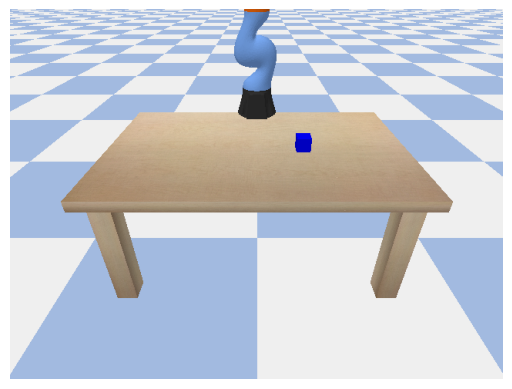

Intention: Raise blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


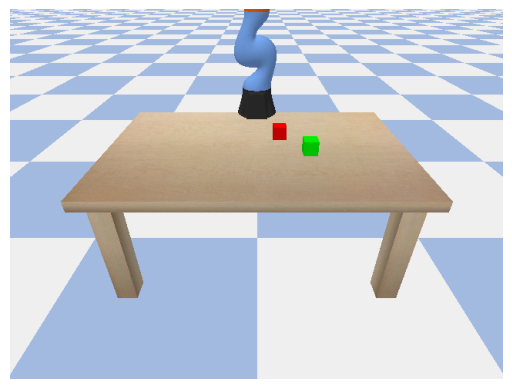

Intention: Hoist green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


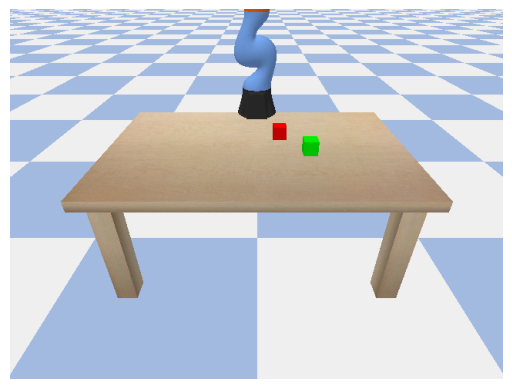

Intention: Hoist green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


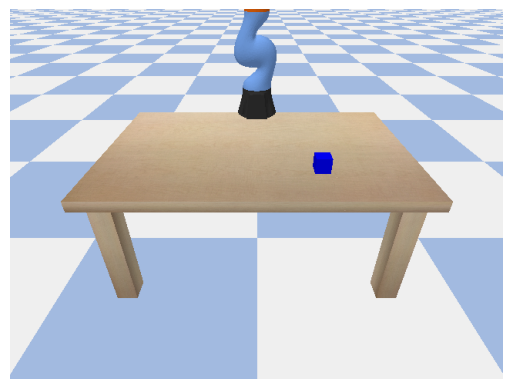

Intention: Grasp blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


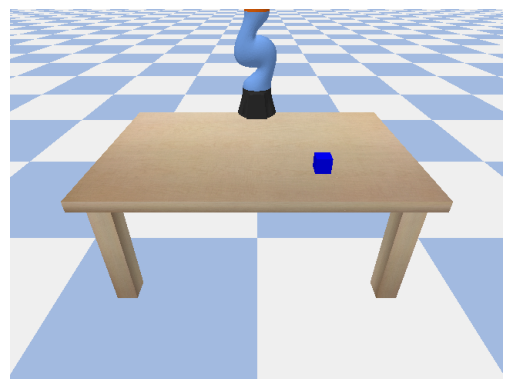

Intention: Grasp blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 3))
Intention: Retrieve blue; Reward: -1; Reason: extraction


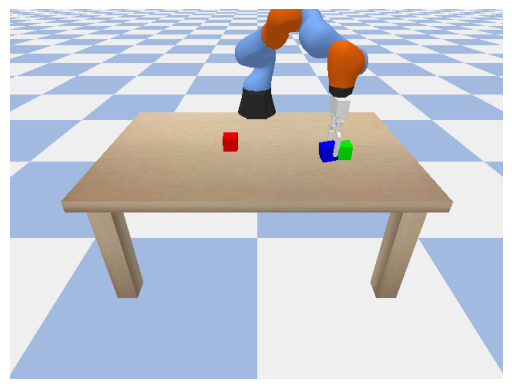

Intention: Retrieve blue; Reward: -1; Reason: timeout


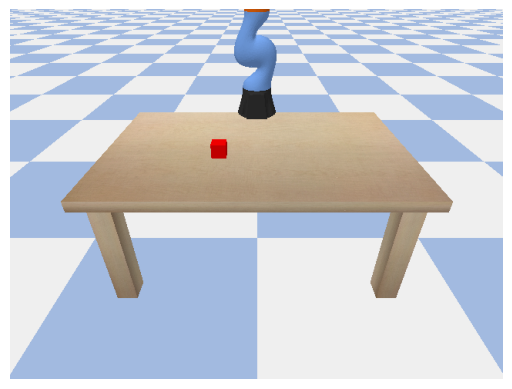

Intention: Collect red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


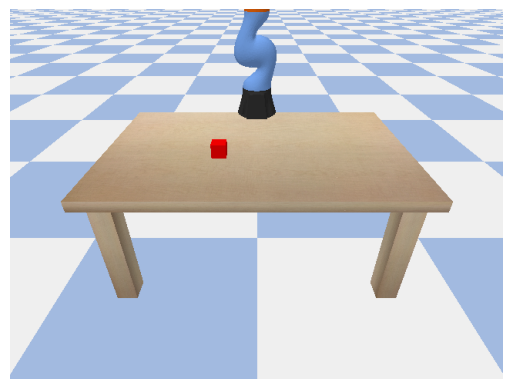

Intention: Collect red; Reward: -1; Reason: exception (expected ':' (<unknown>, line 2))


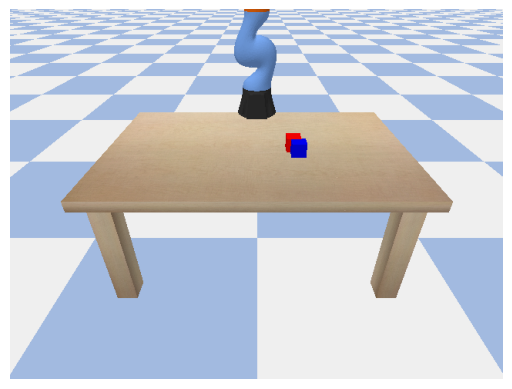

Intention: Hoist red; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 5))


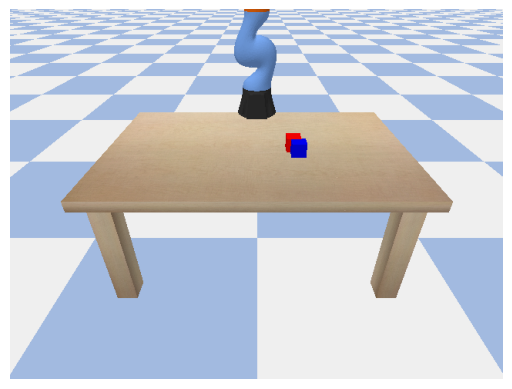

Intention: Hoist red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


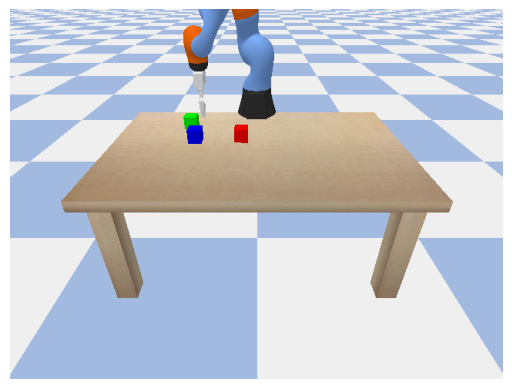

Intention: Take green; Reward: -1; Reason: timeout


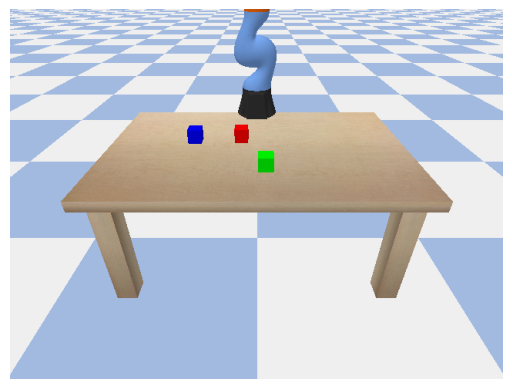

Intention: Take green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


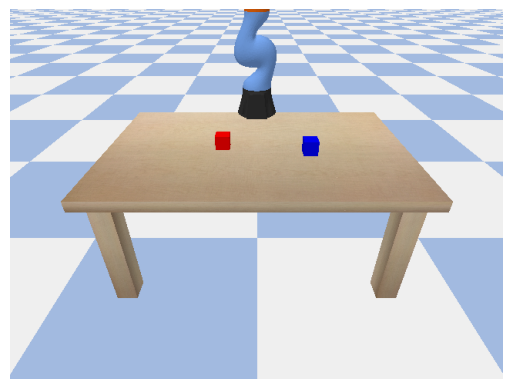

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


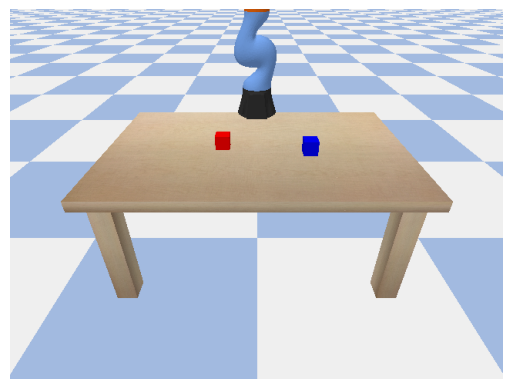

Intention: Fetch blue; Reward: -1; Reason: exception (invalid syntax. Perhaps you forgot a comma? (<unknown>, line 3))


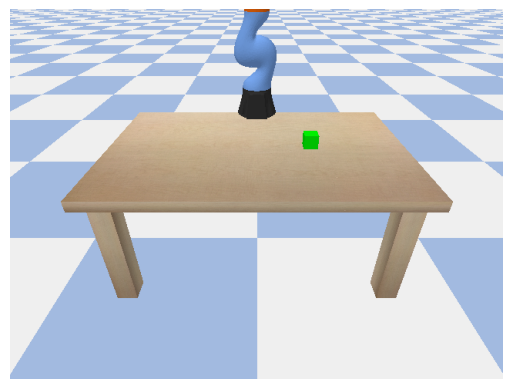

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


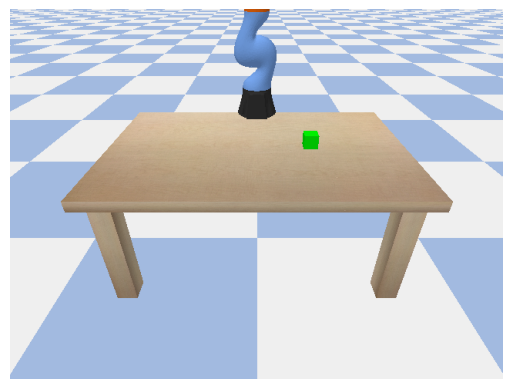

Intention: Pick green; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 2))


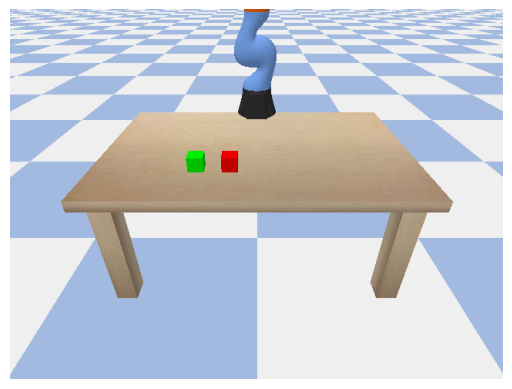

Intention: Retrieve green; Reward: -1; Reason: exception (closing parenthesis ']' does not match opening parenthesis '(' (<unknown>, line 3))


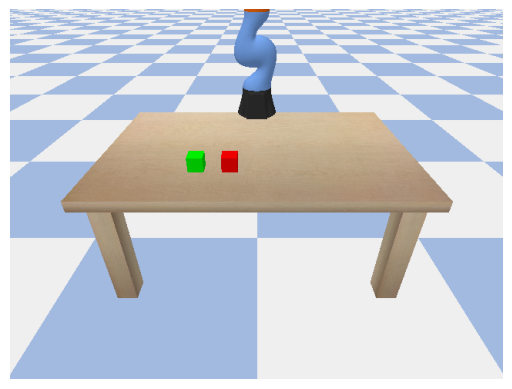

Intention: Retrieve green; Reward: -1; Reason: exception (name 'code' is not defined)


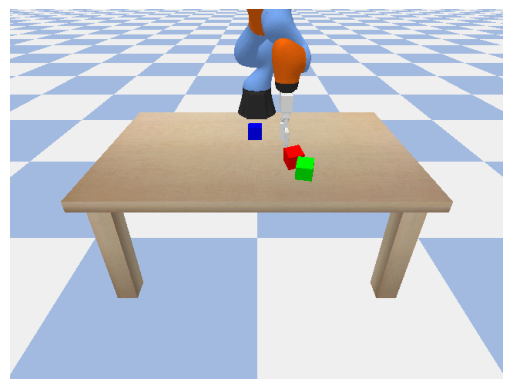

Intention: Acquire red; Reward: 1; Reason: None
Intention: Acquire red; Reward: -1; Reason: extraction


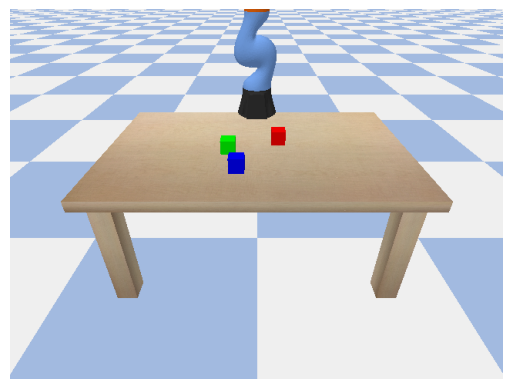

Intention: Get blue; Reward: 1; Reason: None


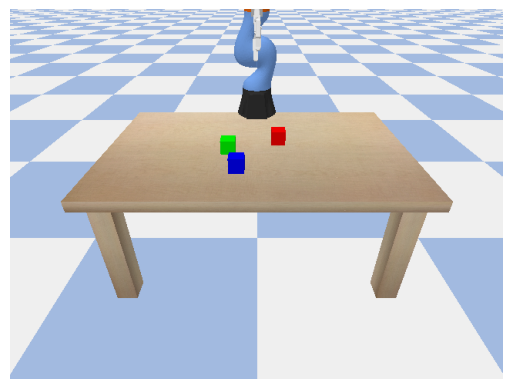

Intention: Get blue; Reward: -1; Reason: exception (name 'find_object' is not defined)


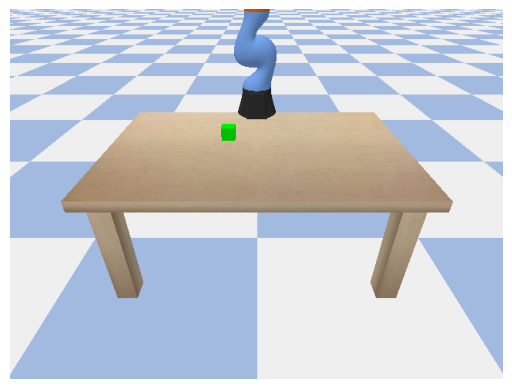

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


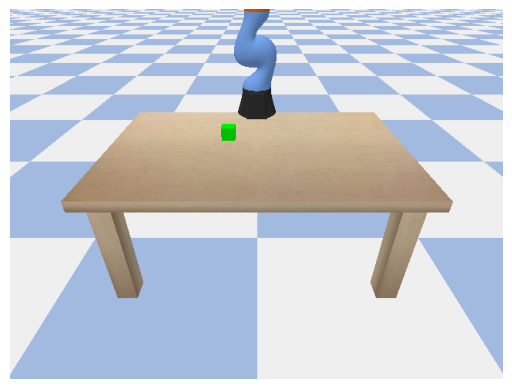

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


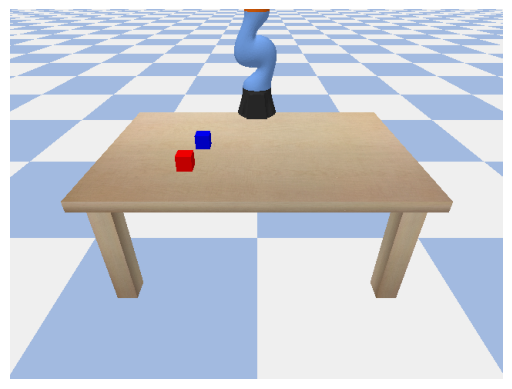

Intention: Seize red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


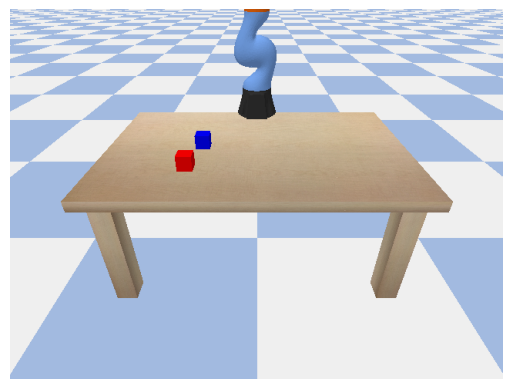

Intention: Seize red; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


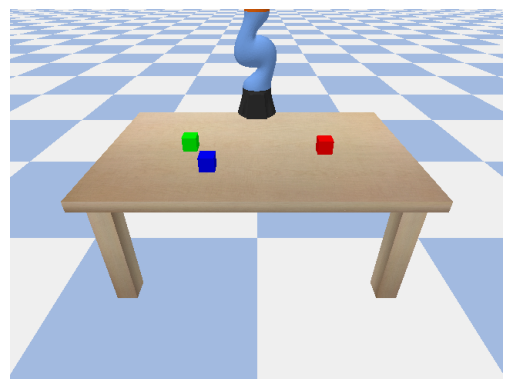

Intention: Raise red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


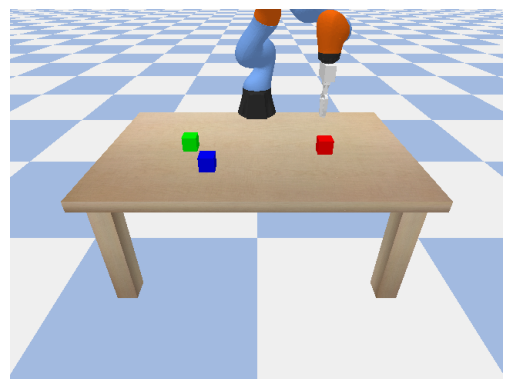

Intention: Raise red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


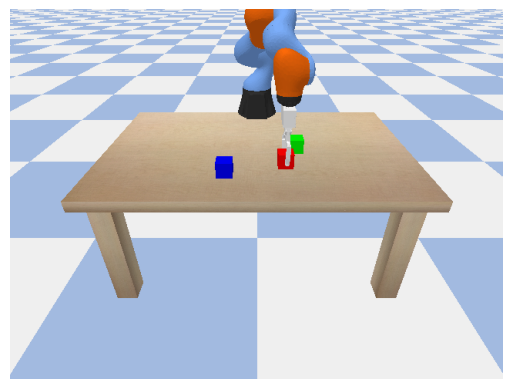

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


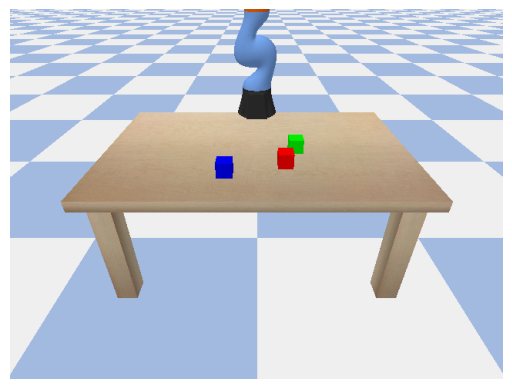

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Hold green; Reward: -1; Reason: extraction
Intention: Hold green; Reward: -1; Reason: extraction


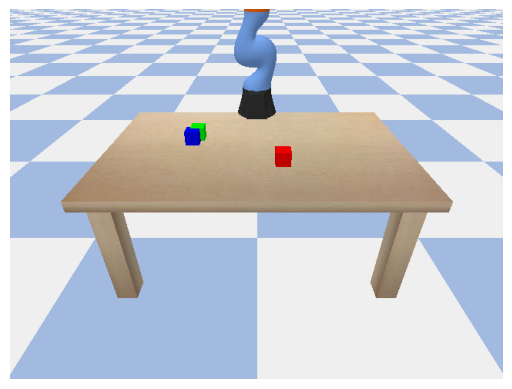

Intention: Carry red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


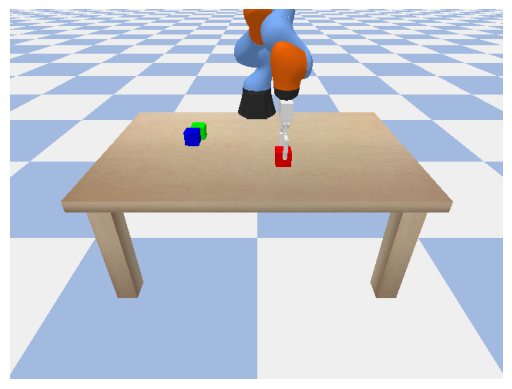

Intention: Carry red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


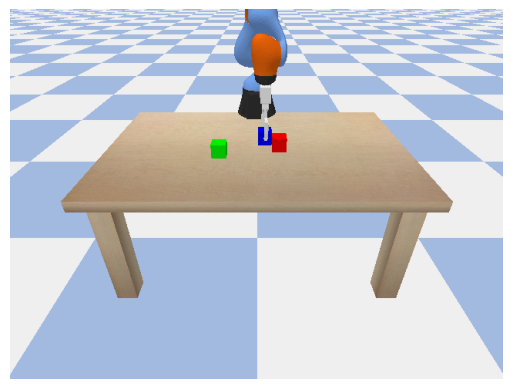

Intention: Collect blue; Reward: -1; Reason: exception (name 'collect' is not defined)


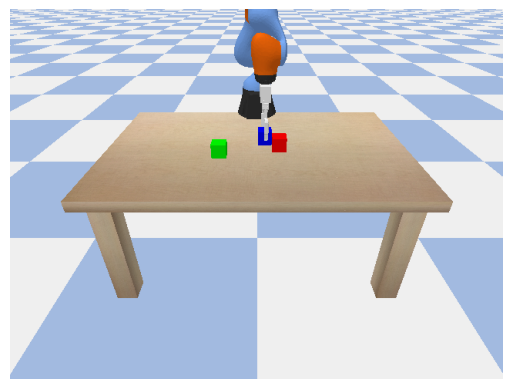

Intention: Collect blue; Reward: 0; Reason: vlm (No)
Intention: Take red; Reward: -1; Reason: extraction


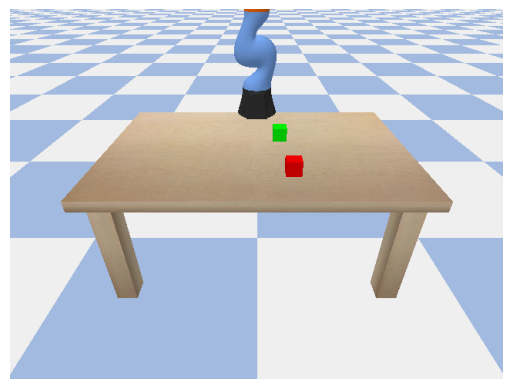

Intention: Take red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Hold blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction


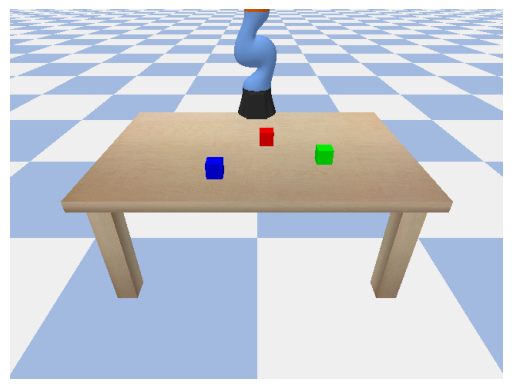

Intention: Grasp red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


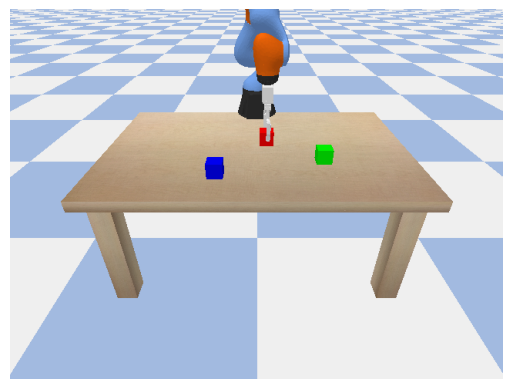

Intention: Grasp red; Reward: 0; Reason: vlm (No)


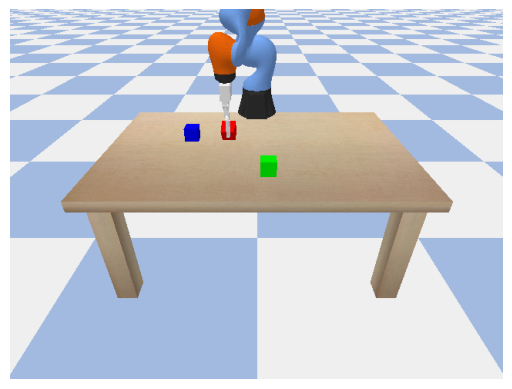

Intention: Lift red; Reward: 0; Reason: vlm (No)


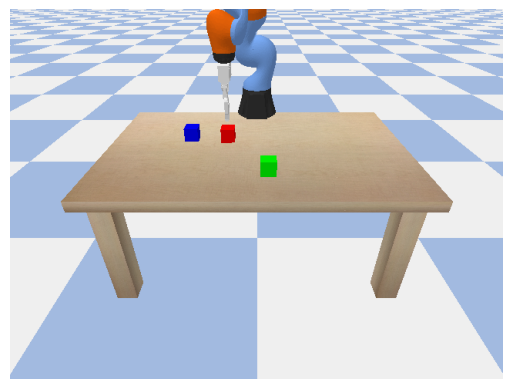

Intention: Lift red; Reward: 0; Reason: vlm (No)


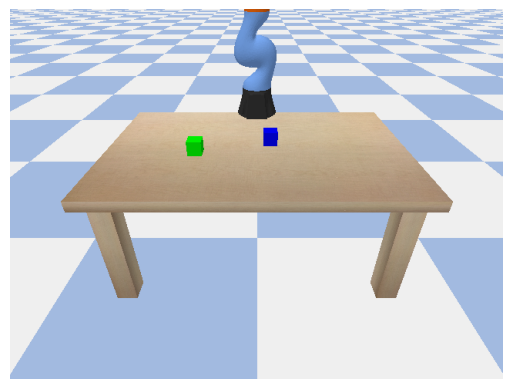

Intention: Fetch blue; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


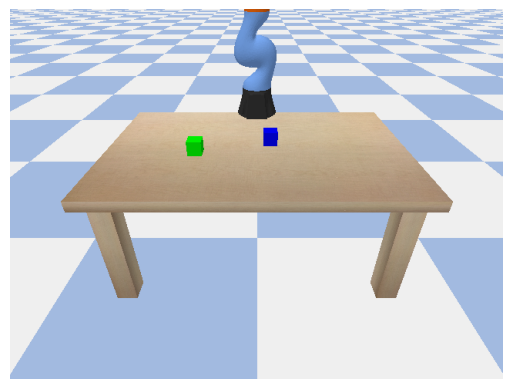

Intention: Fetch blue; Reward: -1; Reason: exception (name 'main' is not defined)


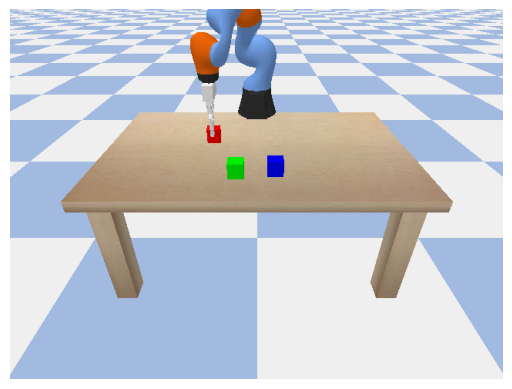

Intention: Grab red; Reward: 1; Reason: None


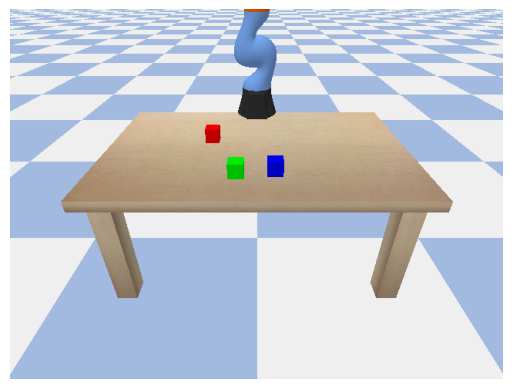

Intention: Grab red; Reward: -1; Reason: exception (name 'unclick' is not defined)


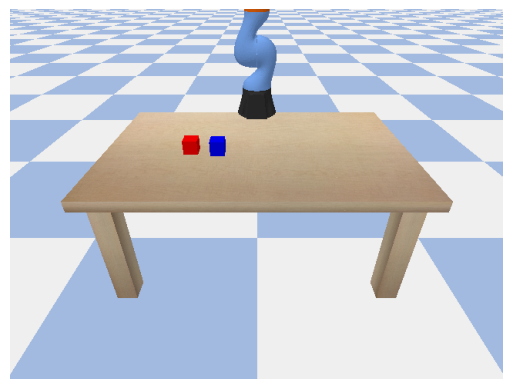

Intention: Lift blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


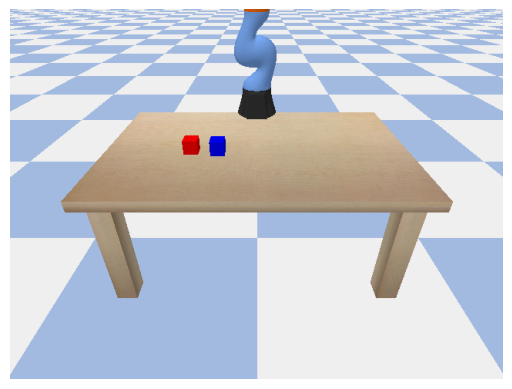

Intention: Lift blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


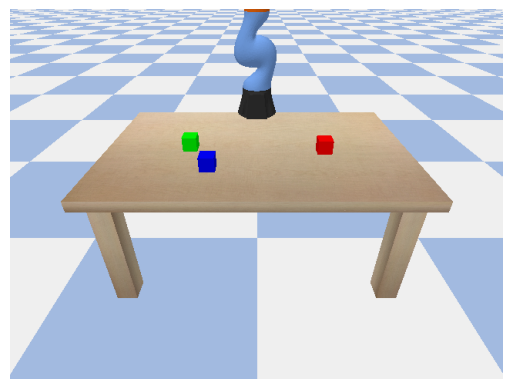

Intention: Raise red; Reward: 0; Reason: vlm (No)


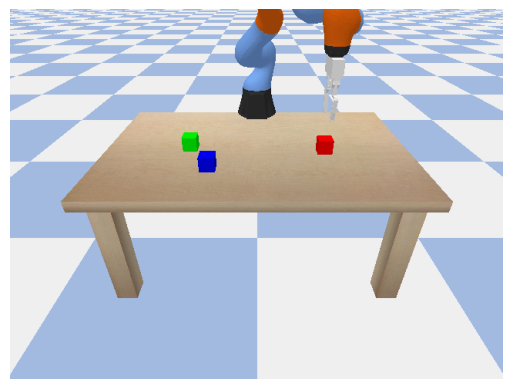

Intention: Raise red; Reward: 0; Reason: vlm (No)


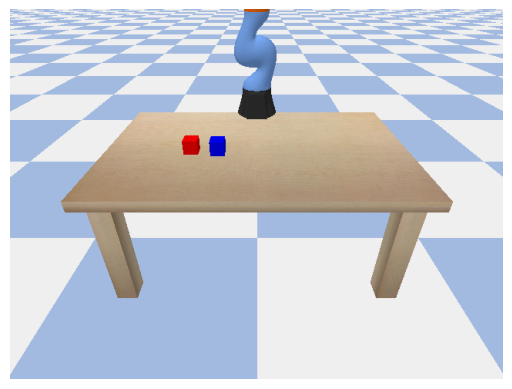

Intention: Lift blue; Reward: -1; Reason: exception (closing parenthesis ']' does not match opening parenthesis '(' (<unknown>, line 3))


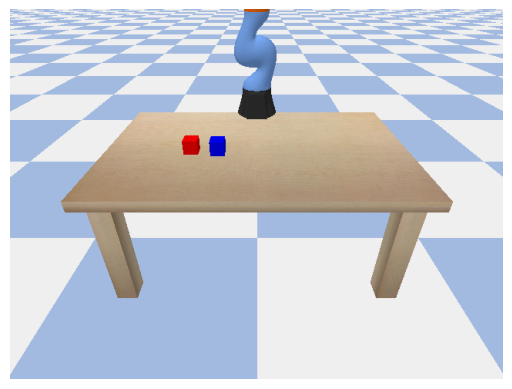

Intention: Lift blue; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


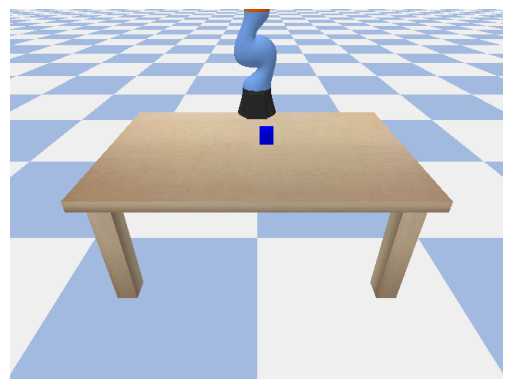

Intention: Hold blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


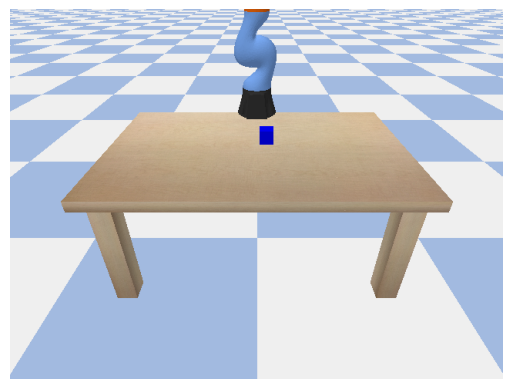

Intention: Hold blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


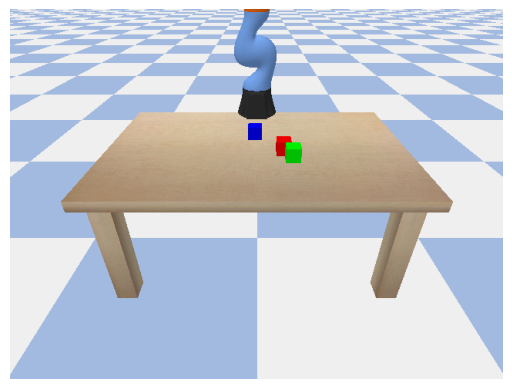

Intention: Acquire red; Reward: 0; Reason: vlm (No)


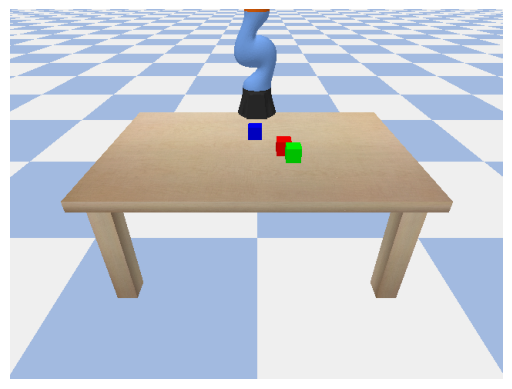

Intention: Acquire red; Reward: 0; Reason: vlm (No)


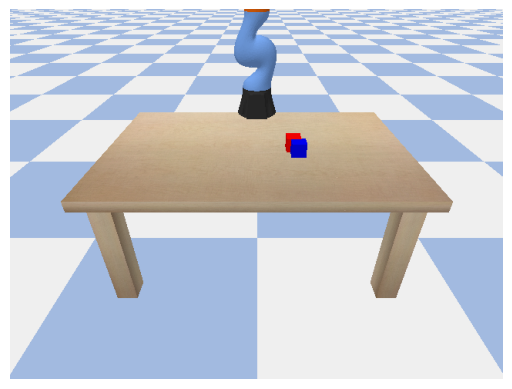

Intention: Hoist red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


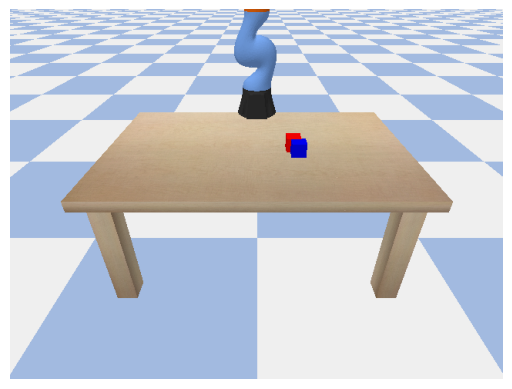

Intention: Hoist red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


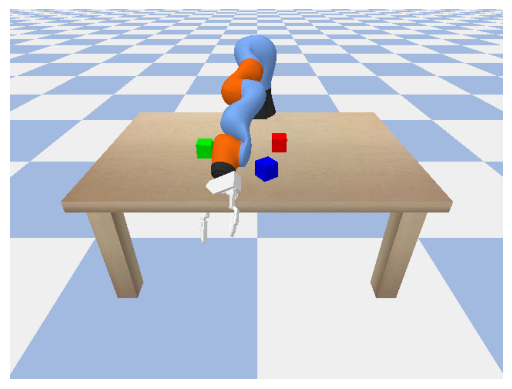

Intention: Collect blue; Reward: -1; Reason: timeout


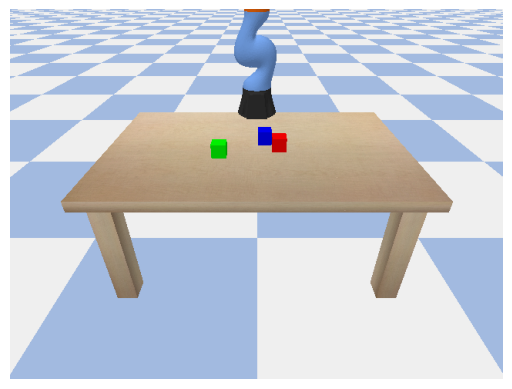

Intention: Collect blue; Reward: 0; Reason: vlm (No)


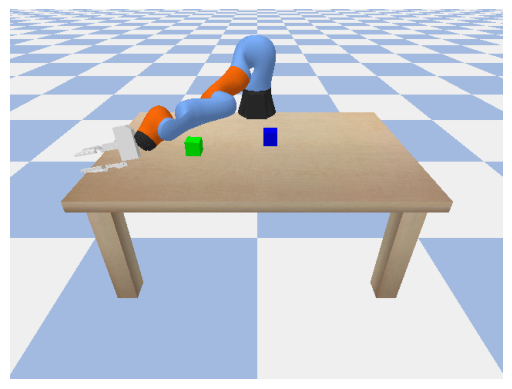

Intention: Fetch blue; Reward: -1; Reason: timeout


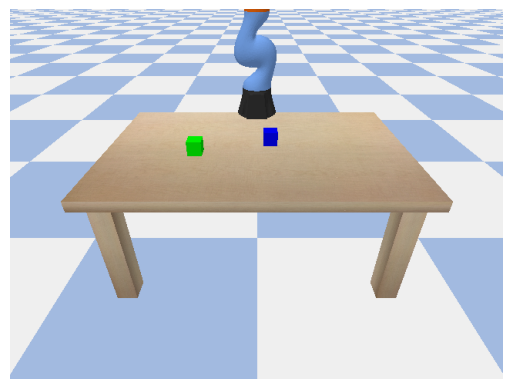

Intention: Fetch blue; Reward: -1; Reason: exception (closing parenthesis ')' does not match opening parenthesis '[' (<unknown>, line 3))


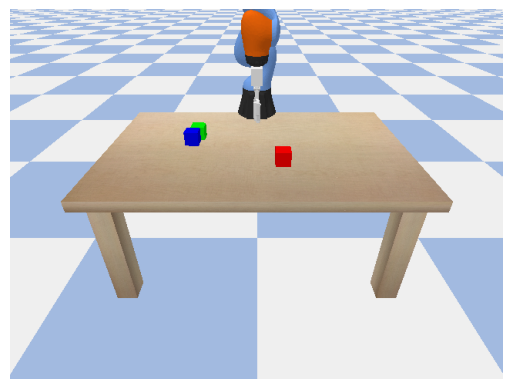

Intention: Carry red; Reward: 0; Reason: vlm (No)


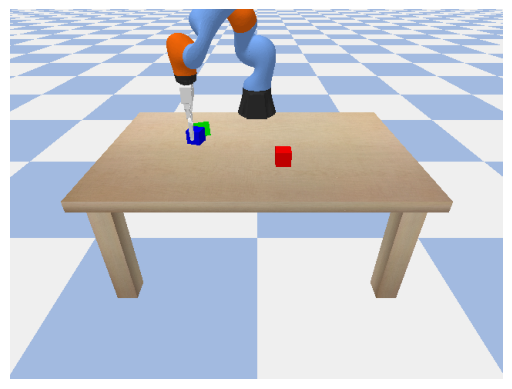

Intention: Carry red; Reward: -1; Reason: exception (name 'pick' is not defined)


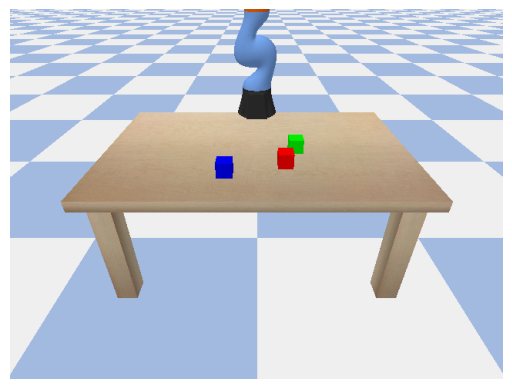

Intention: Acquire red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


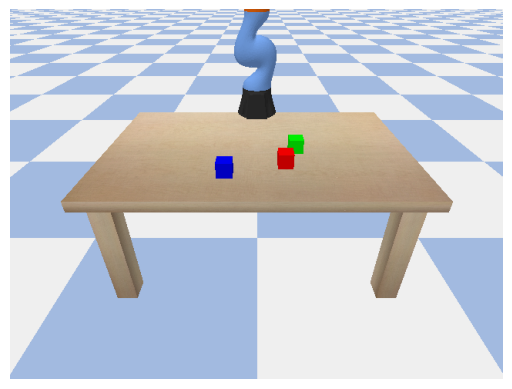

Intention: Acquire red; Reward: 0; Reason: vlm (No)


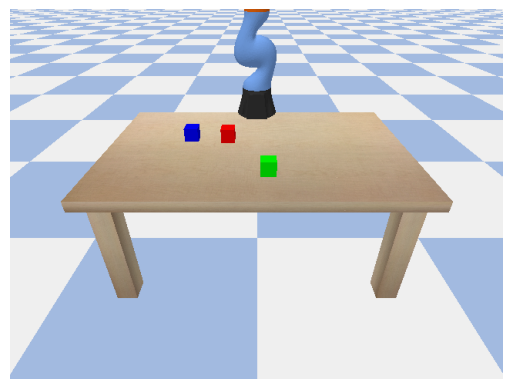

Intention: Lift red; Reward: -1; Reason: exception (name 'python' is not defined)


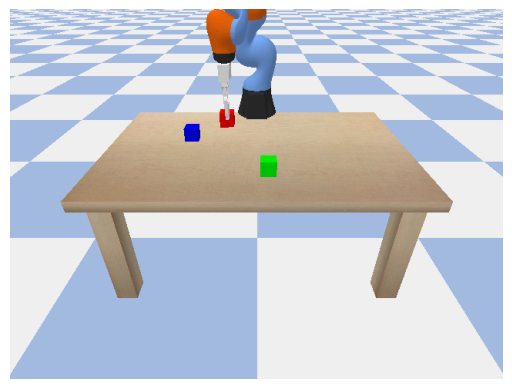

Intention: Lift red; Reward: 0; Reason: vlm (No)


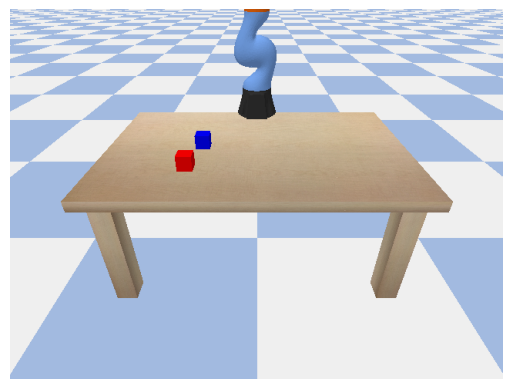

Intention: Seize red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


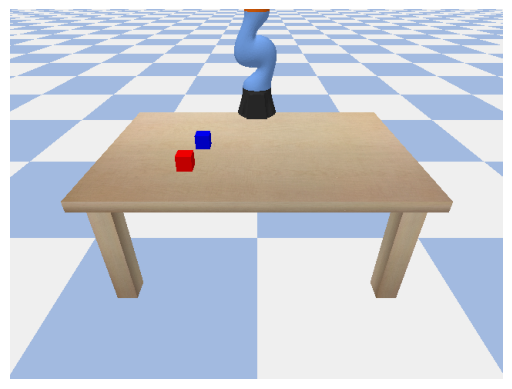

Intention: Seize red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


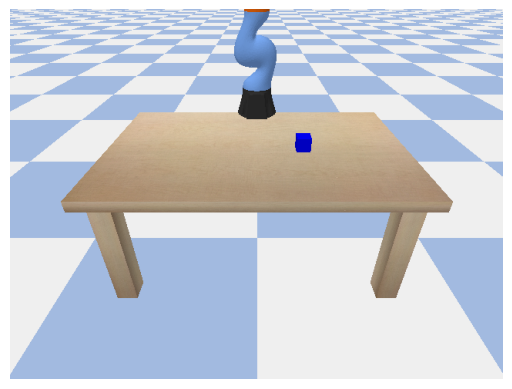

Intention: Raise blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


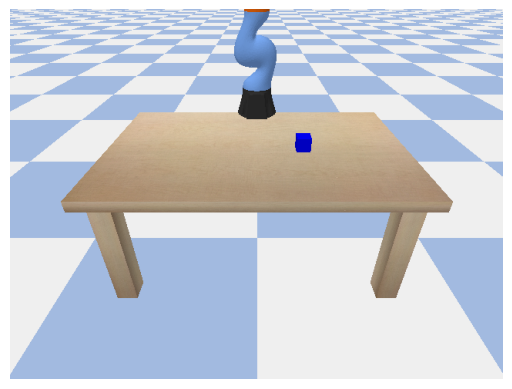

Intention: Raise blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Hold green; Reward: -1; Reason: extraction
Intention: Hold green; Reward: -1; Reason: extraction


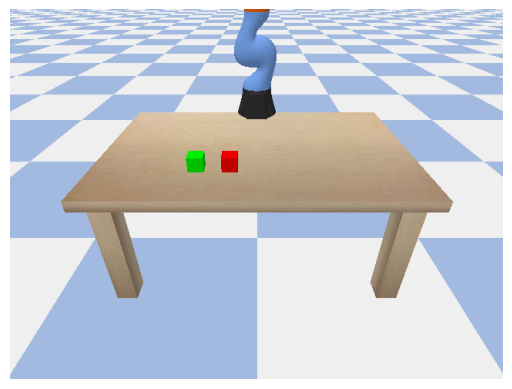

Intention: Retrieve green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


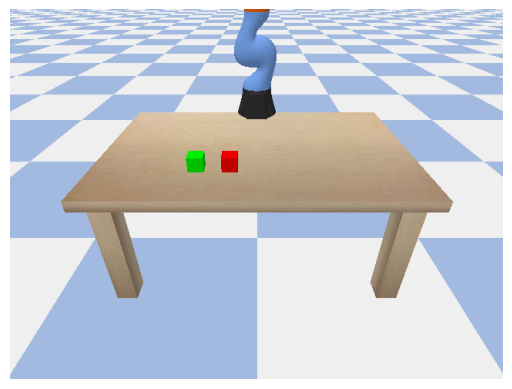

Intention: Retrieve green; Reward: -1; Reason: exception (unmatched ')' (<unknown>, line 1))


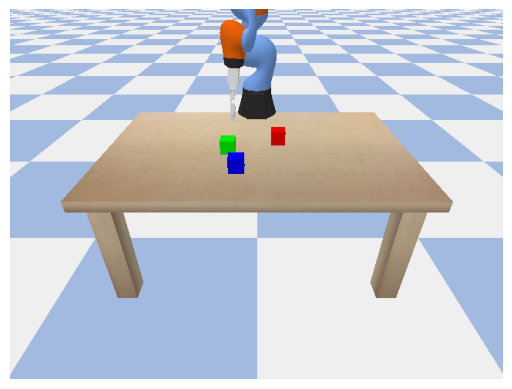

Intention: Get blue; Reward: -1; Reason: timeout


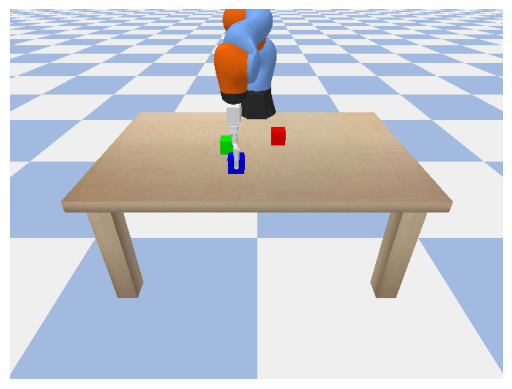

Intention: Get blue; Reward: 0; Reason: vlm (No)


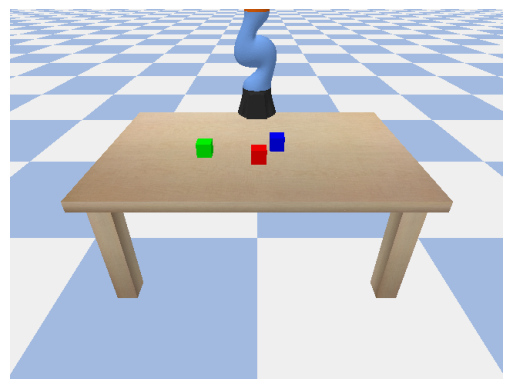

Intention: Pick green; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 87))


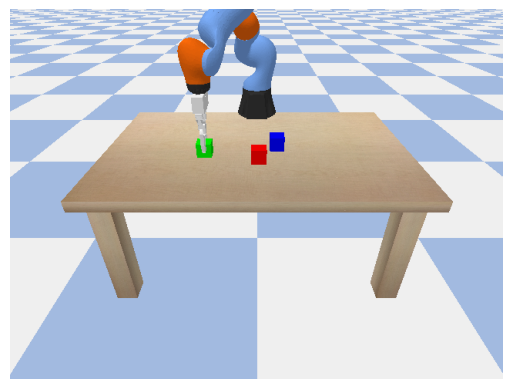

Intention: Pick green; Reward: 1; Reason: None


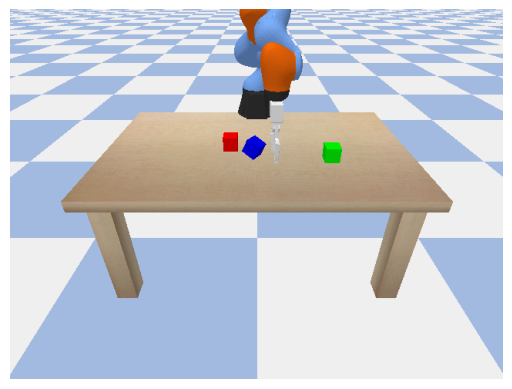

Intention: Retrieve blue; Reward: 1; Reason: None


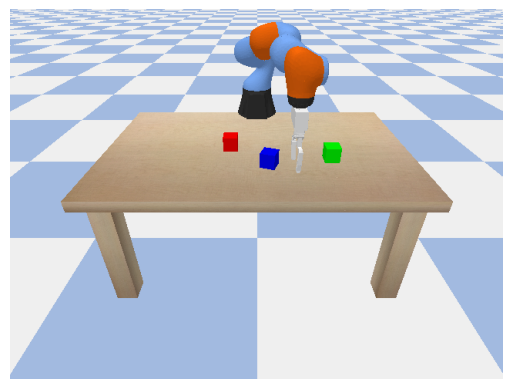

Intention: Retrieve blue; Reward: 0; Reason: vlm (No)


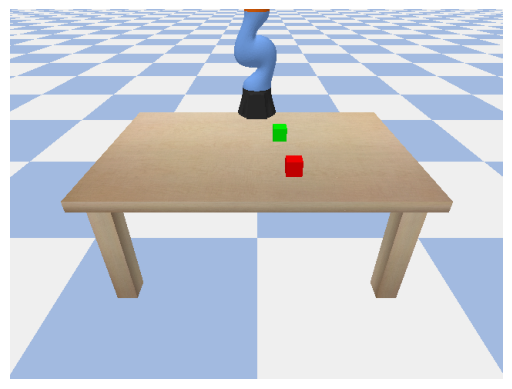

Intention: Take red; Reward: -1; Reason: exception (unmatched ')' (<unknown>, line 2))


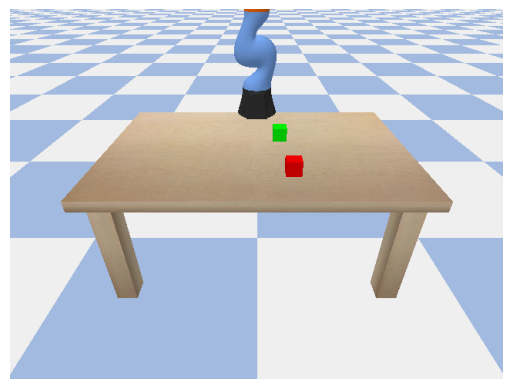

Intention: Take red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 5))


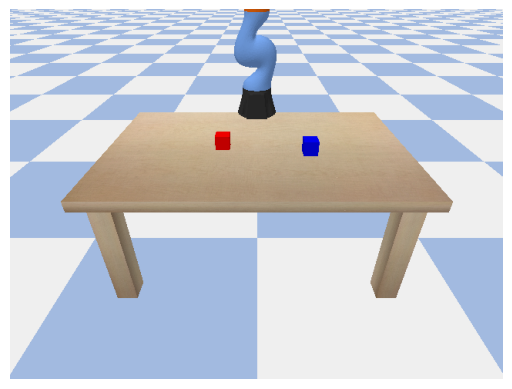

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


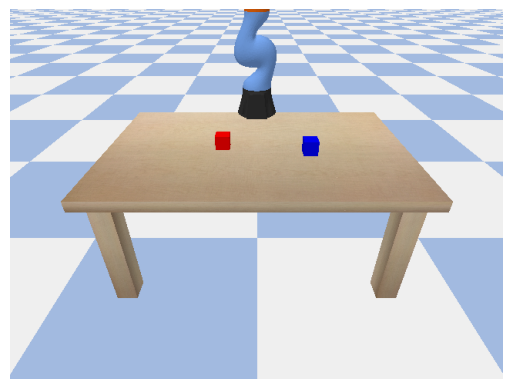

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Get red; Reward: -1; Reason: extraction
Intention: Get red; Reward: -1; Reason: extraction


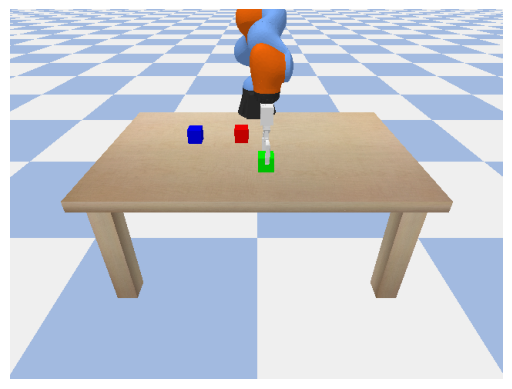

Intention: Take green; Reward: 0; Reason: vlm (No)


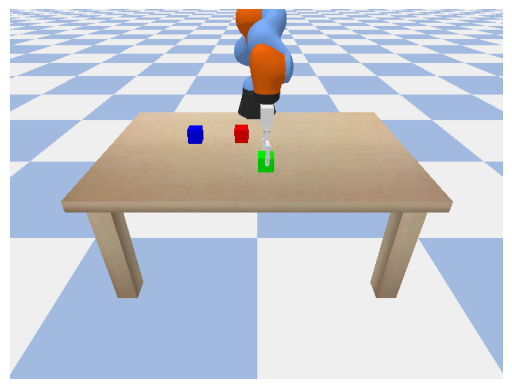

Intention: Take green; Reward: 0; Reason: vlm (No)


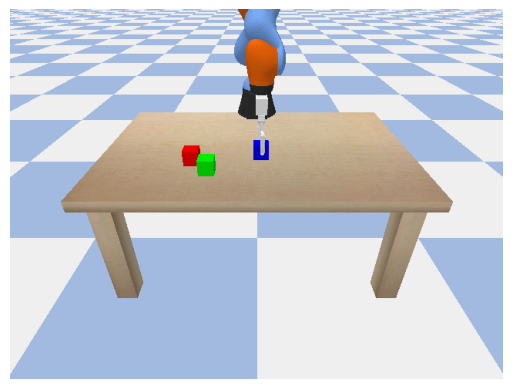

Intention: Carry blue; Reward: -1; Reason: exception (name 'carry_object' is not defined)


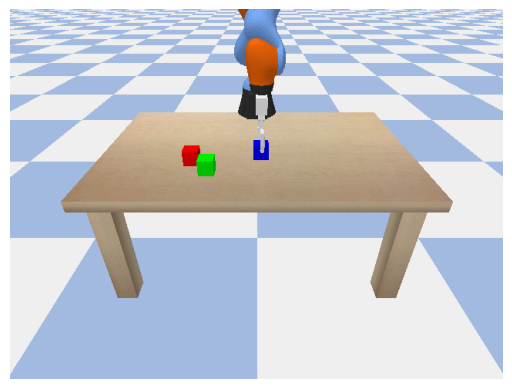

Intention: Carry blue; Reward: 1; Reason: None
Intention: Seize green; Reward: -1; Reason: extraction


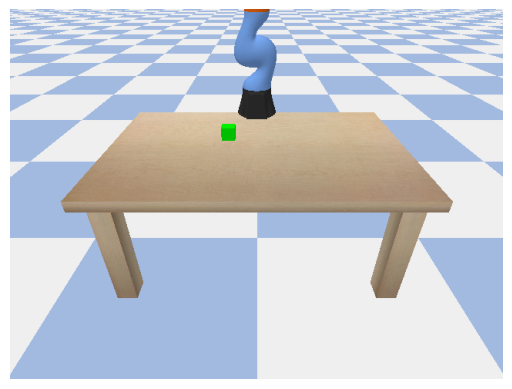

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


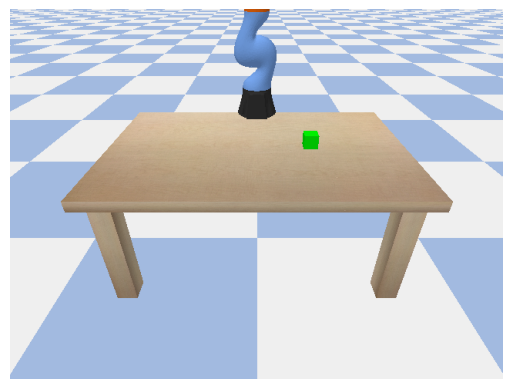

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


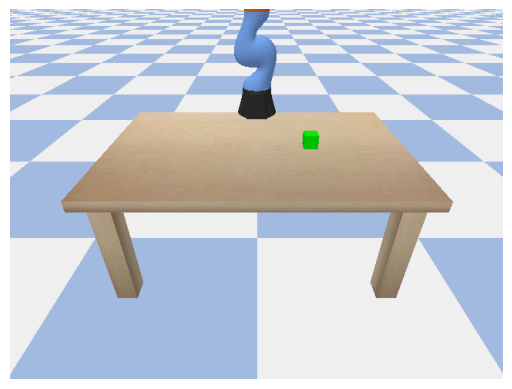

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


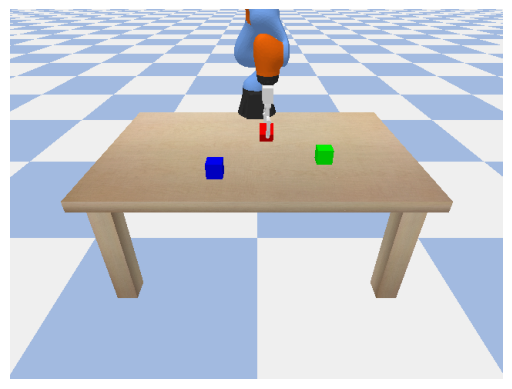

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


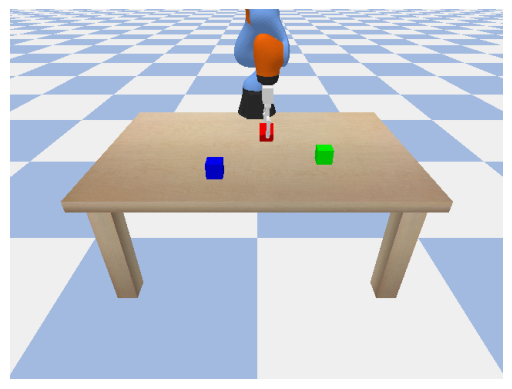

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


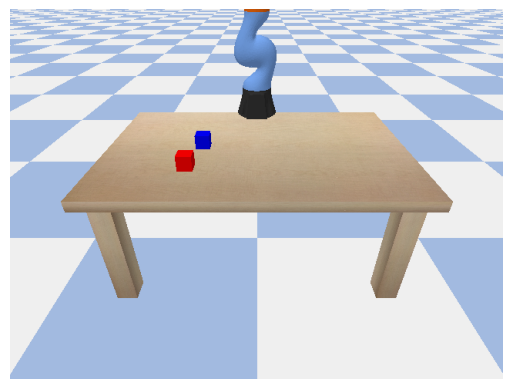

Intention: Seize red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


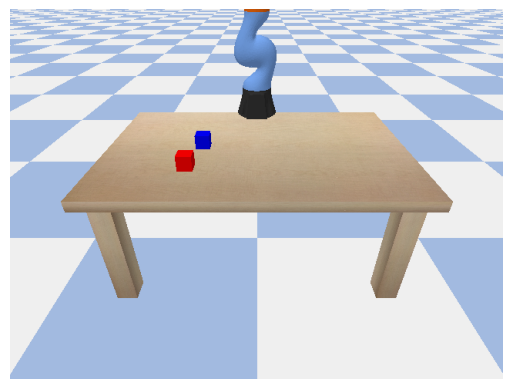

Intention: Seize red; Reward: -1; Reason: exception (unindent does not match any outer indentation level (<unknown>, line 4))


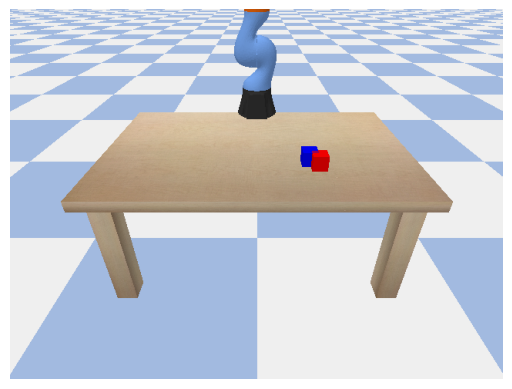

Intention: Grab blue; Reward: -1; Reason: exception (unterminated string literal (detected at line 5) (<unknown>, line 5))


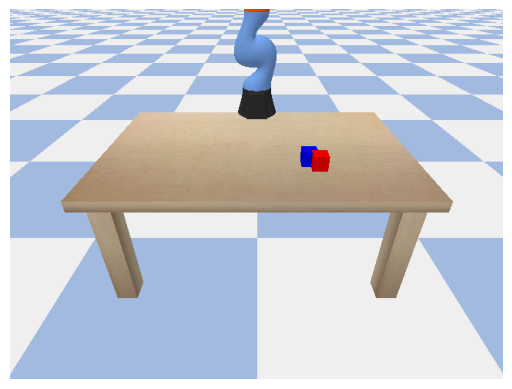

Intention: Grab blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


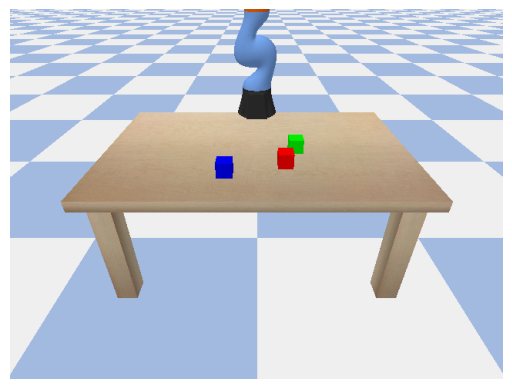

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


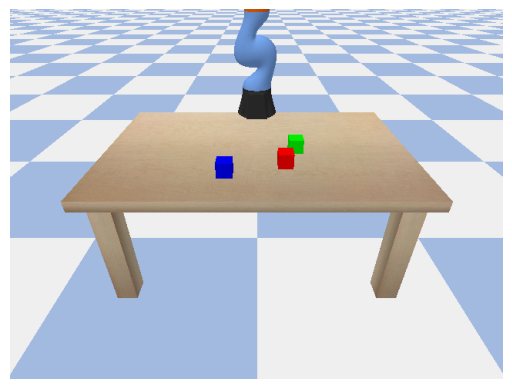

Intention: Acquire red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


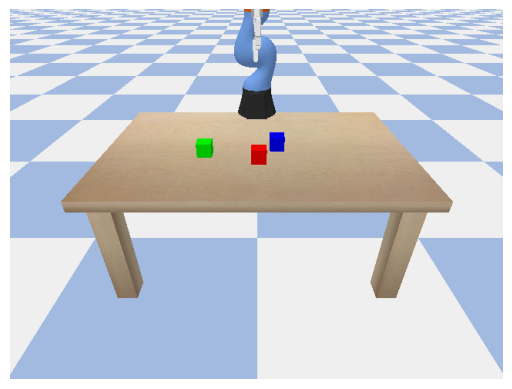

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


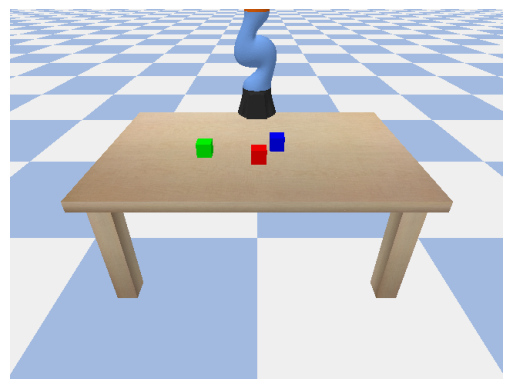

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Seize green; Reward: -1; Reason: extraction
Intention: Seize green; Reward: -1; Reason: extraction


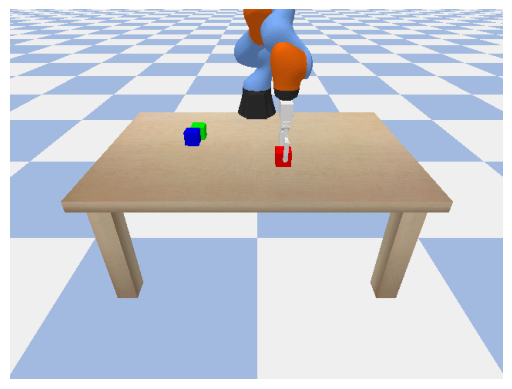

Intention: Carry red; Reward: -1; Reason: exception (name 'cycle_gripper' is not defined)


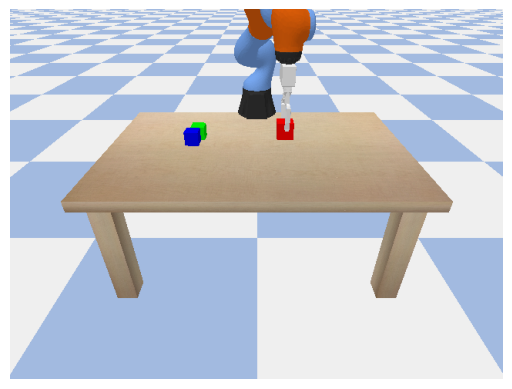

Intention: Carry red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


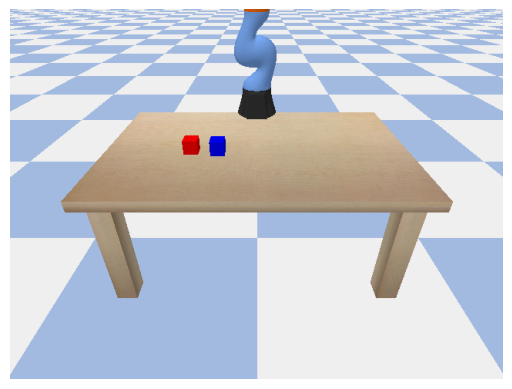

Intention: Lift blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Lift blue; Reward: -1; Reason: extraction


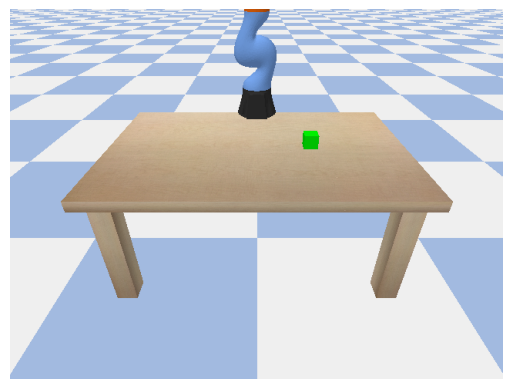

Intention: Pick green; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 2))


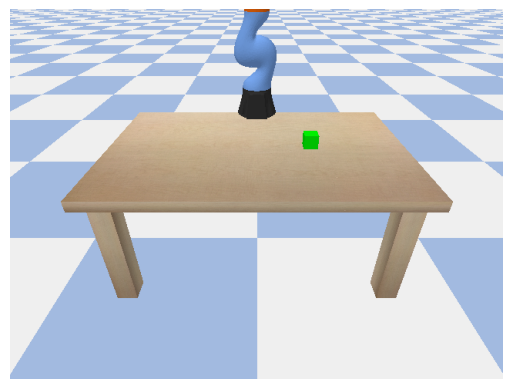

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


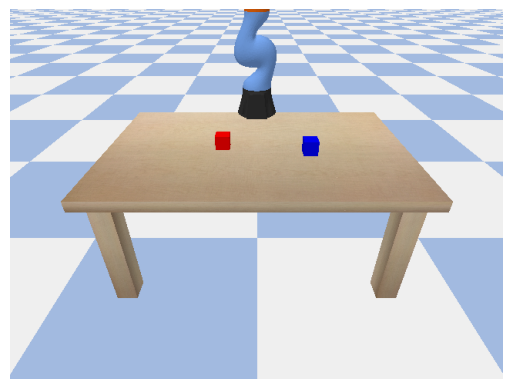

Intention: Fetch blue; Reward: -1; Reason: exception (unindent does not match any outer indentation level (<unknown>, line 4))


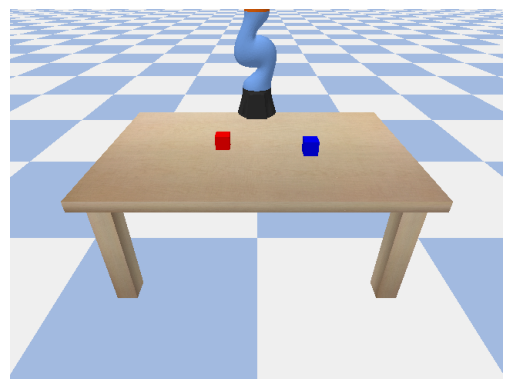

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))
Intention: Hold green; Reward: -1; Reason: extraction


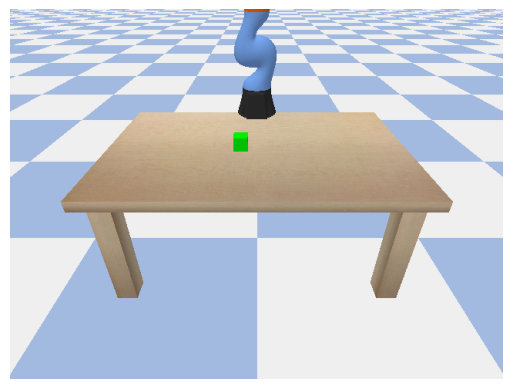

Intention: Hold green; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 2))


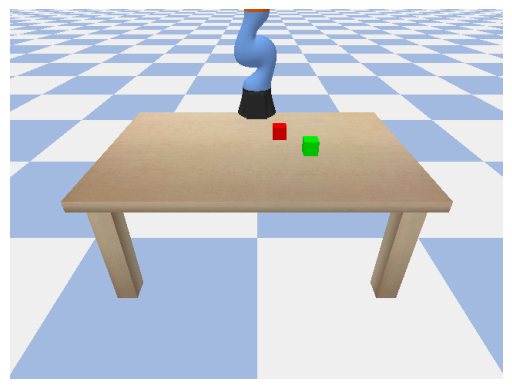

Intention: Hoist green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


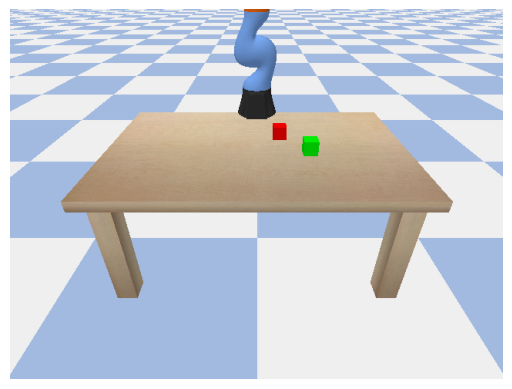

Intention: Hoist green; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


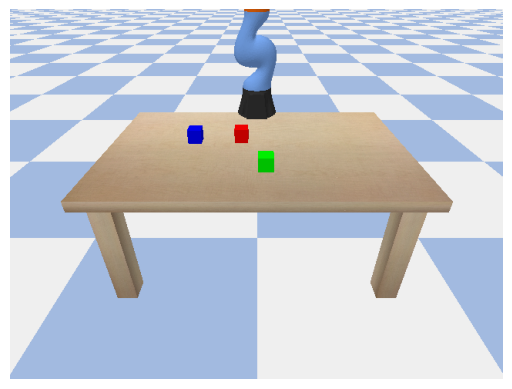

Intention: Take green; Reward: 0; Reason: vlm (No)


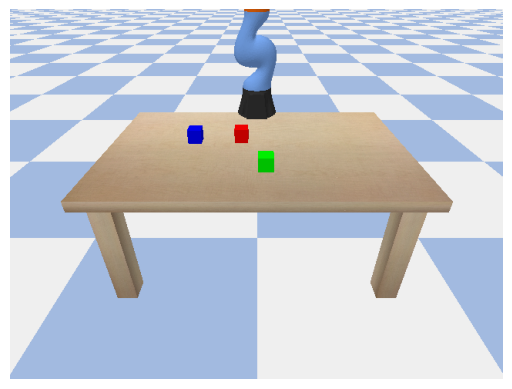

Intention: Take green; Reward: 0; Reason: vlm (No)


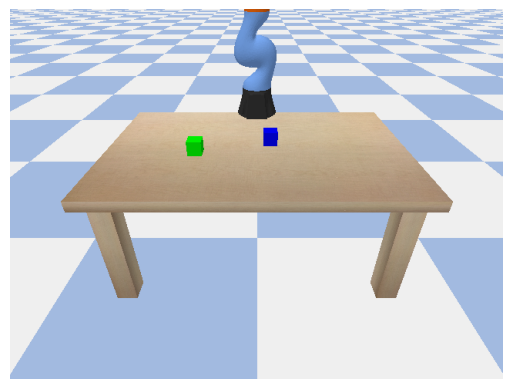

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


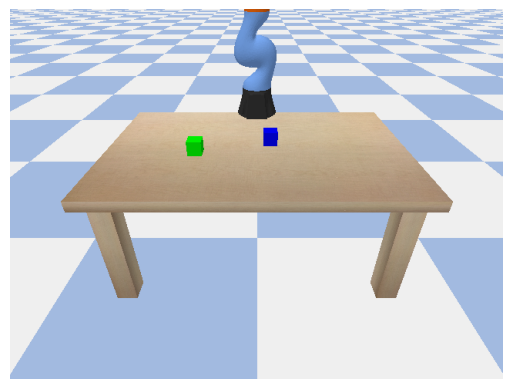

Intention: Fetch blue; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 4))


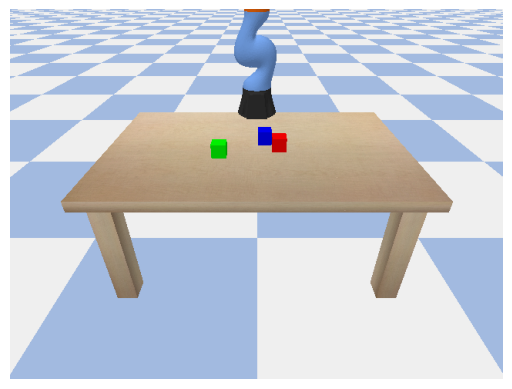

Intention: Collect blue; Reward: 0; Reason: vlm (No)


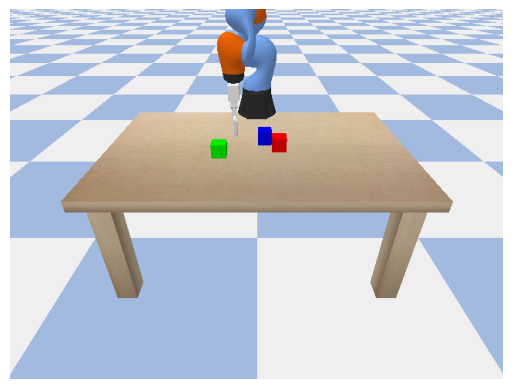

Intention: Collect blue; Reward: -1; Reason: exception (name 'collect_object' is not defined)


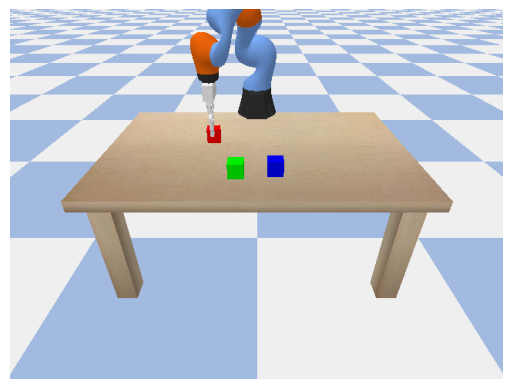

Intention: Grab red; Reward: 1; Reason: None


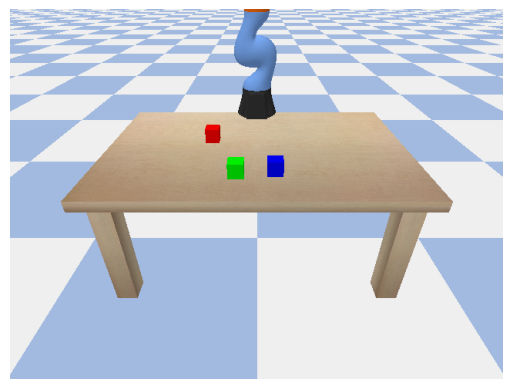

Intention: Grab red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 1))


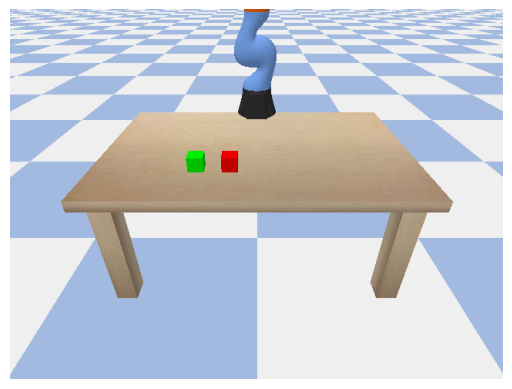

Intention: Retrieve green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


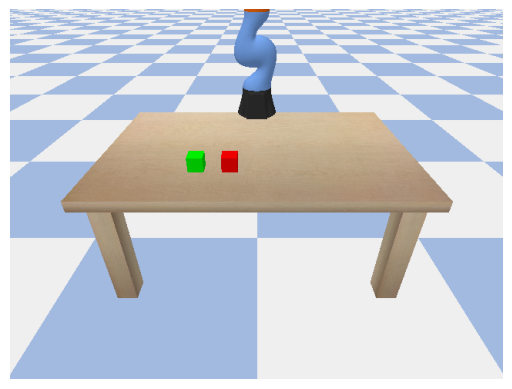

Intention: Retrieve green; Reward: -1; Reason: exception (unmatched ')' (<unknown>, line 4))


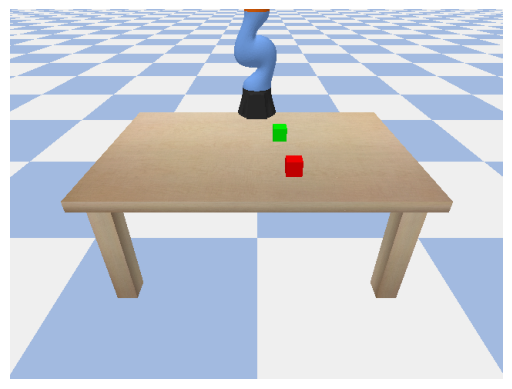

Intention: Take red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


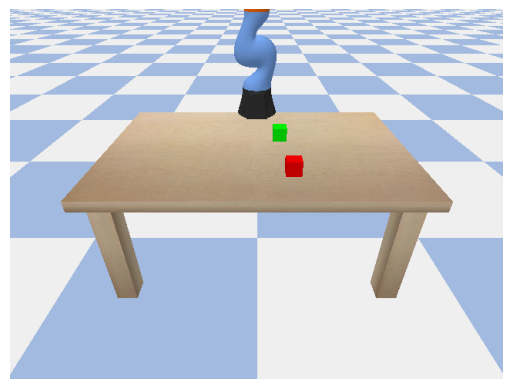

Intention: Take red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))


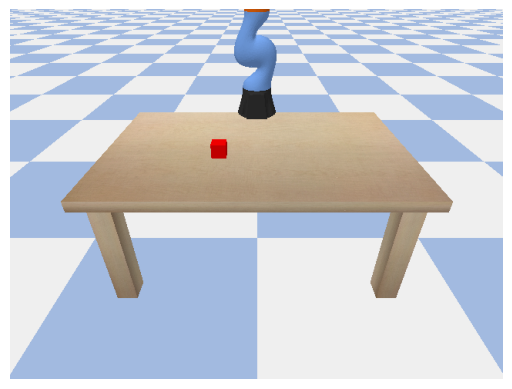

Intention: Collect red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


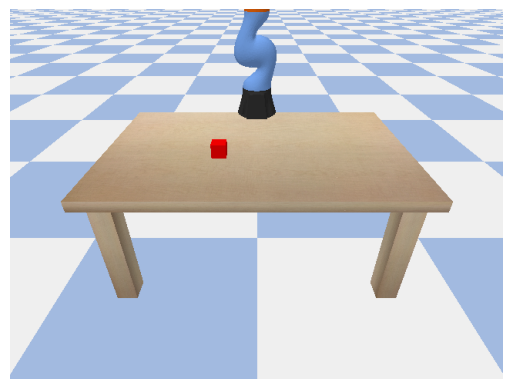

Intention: Collect red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


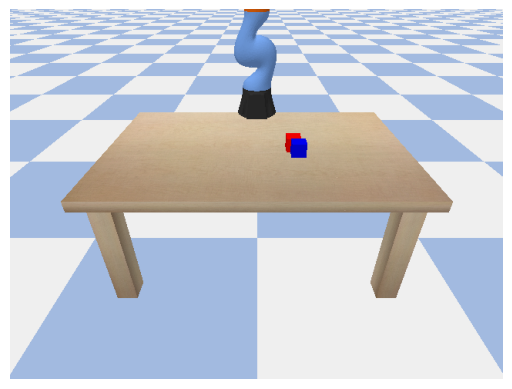

Intention: Hoist red; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 4))


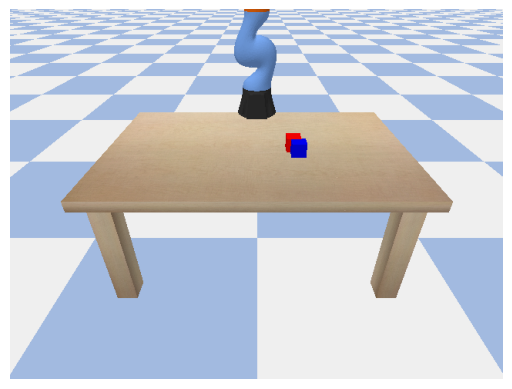

Intention: Hoist red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


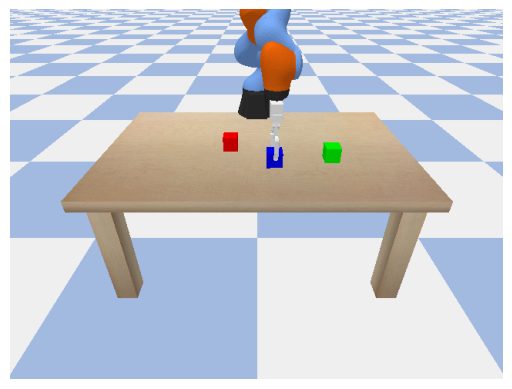

Intention: Retrieve blue; Reward: 1; Reason: None


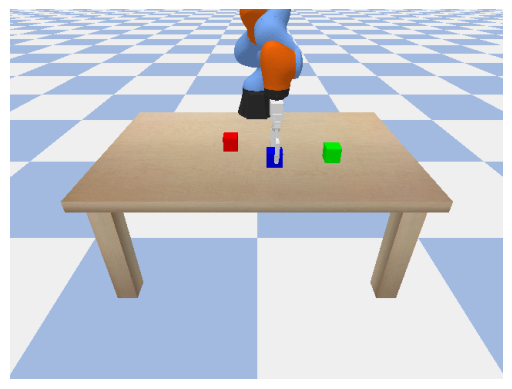

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Hold blue; Reward: -1; Reason: extraction


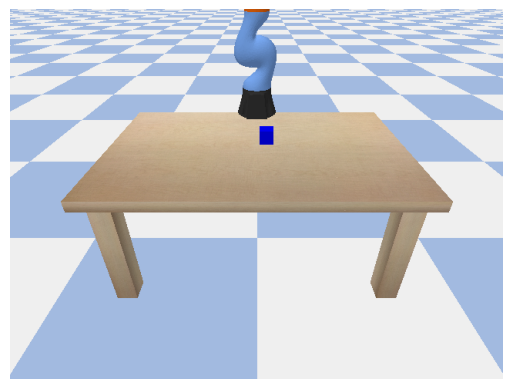

Intention: Hold blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


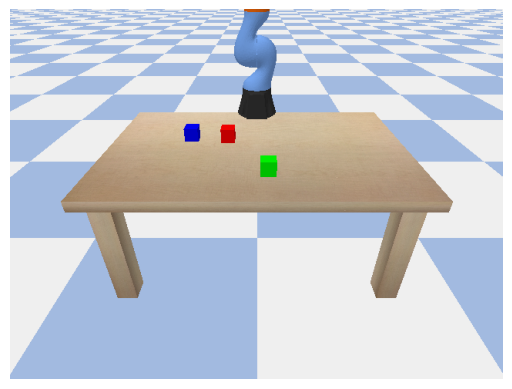

Intention: Lift red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


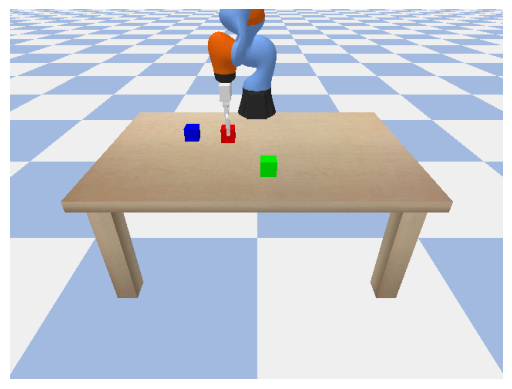

Intention: Lift red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


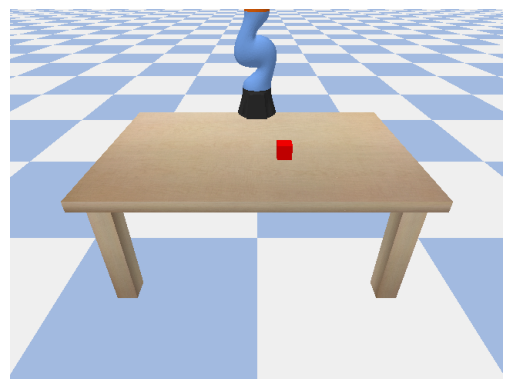

Intention: Get red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 2))


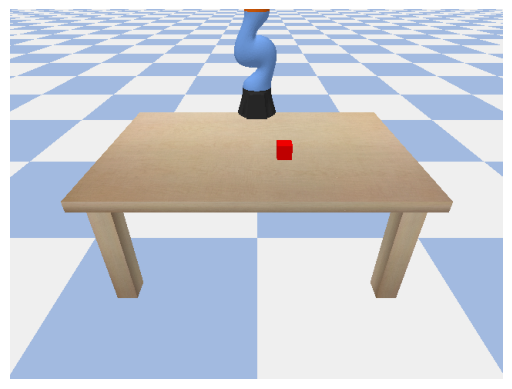

Intention: Get red; Reward: -1; Reason: exception (expected an indented block after function definition on line 2 (<unknown>, line 3))


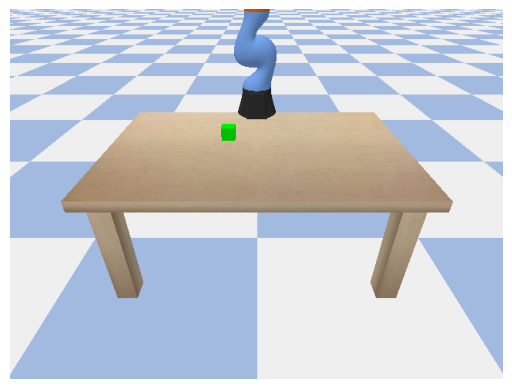

Intention: Seize green; Reward: -1; Reason: exception (expected ':' (<unknown>, line 2))


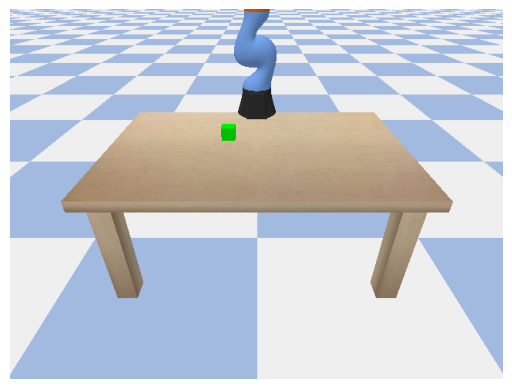

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


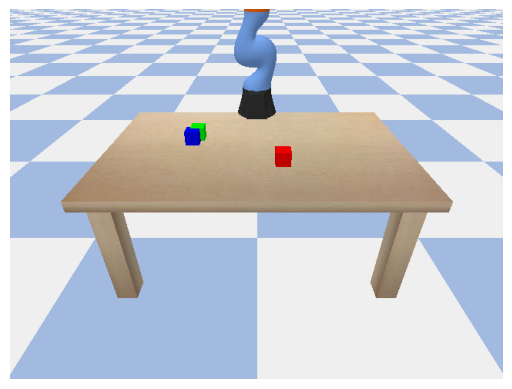

Intention: Carry red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 3))


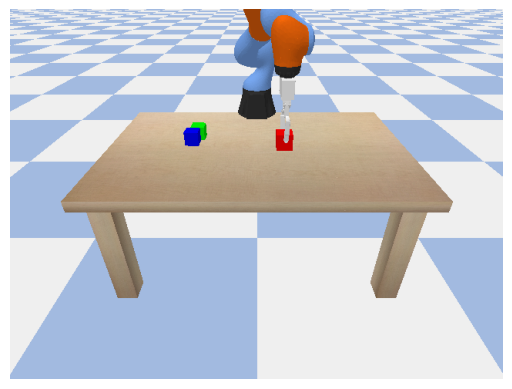

Intention: Carry red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


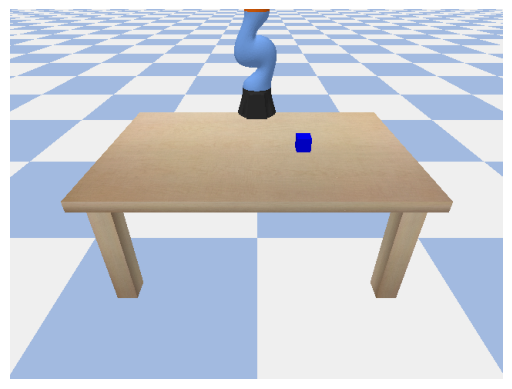

Intention: Raise blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


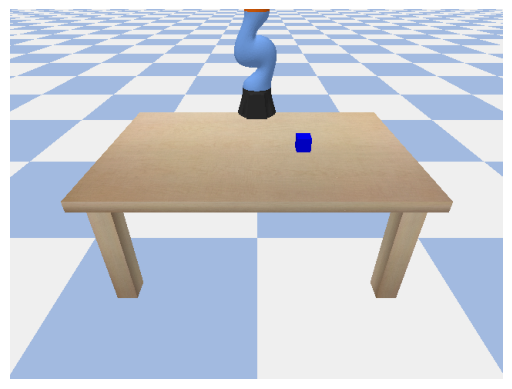

Intention: Raise blue; Reward: -1; Reason: exception (expected ':' (<unknown>, line 2))


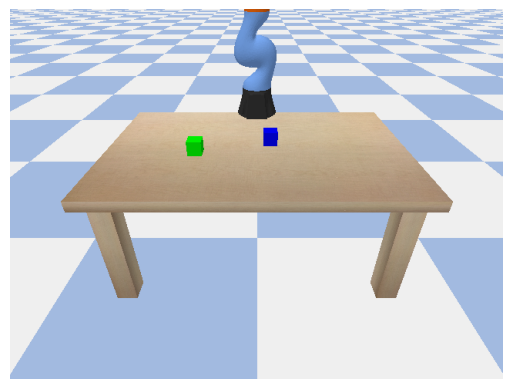

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Fetch blue; Reward: -1; Reason: extraction


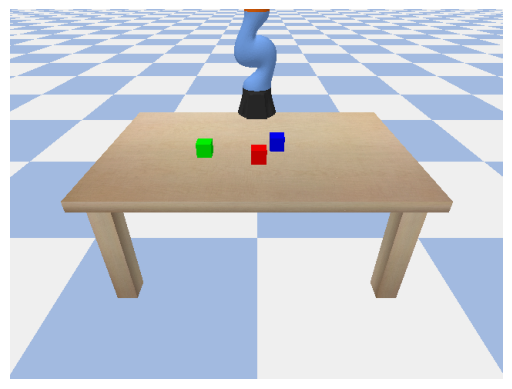

Intention: Pick green; Reward: -1; Reason: exception (name 'py' is not defined)


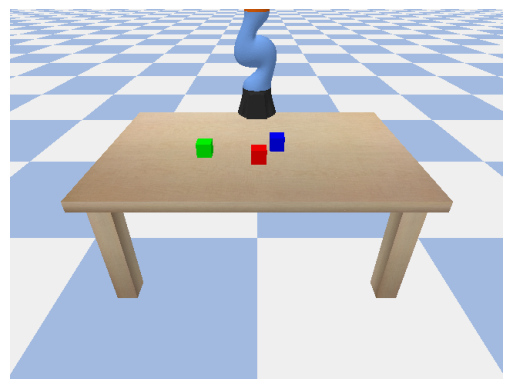

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


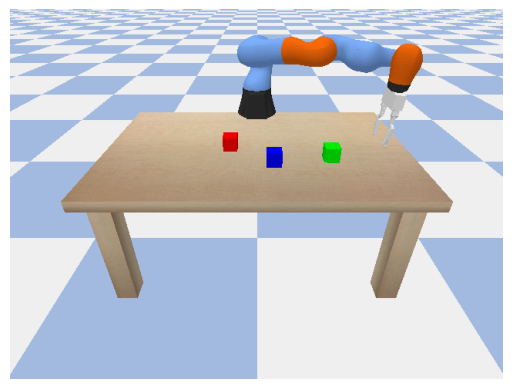

Intention: Retrieve blue; Reward: -1; Reason: timeout


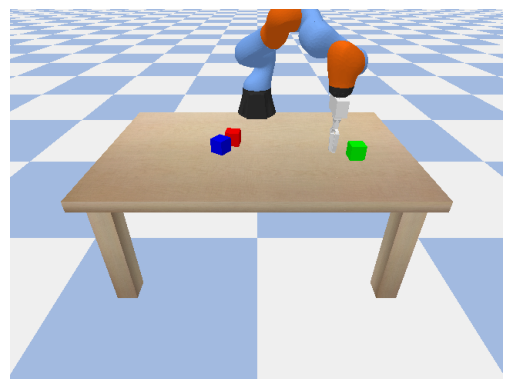

Intention: Retrieve blue; Reward: 1; Reason: None


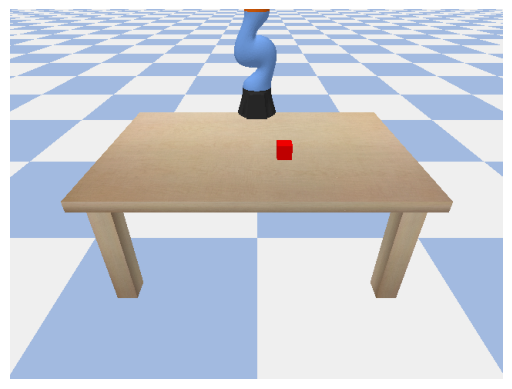

Intention: Get red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


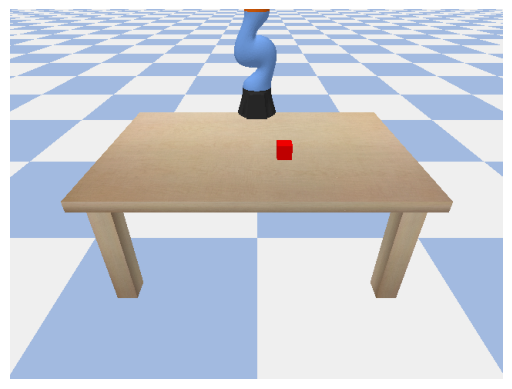

Intention: Get red; Reward: -1; Reason: exception (invalid syntax. Perhaps you forgot a comma? (<unknown>, line 2))


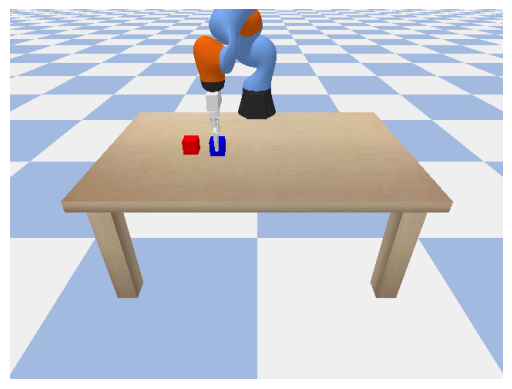

Intention: Lift blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


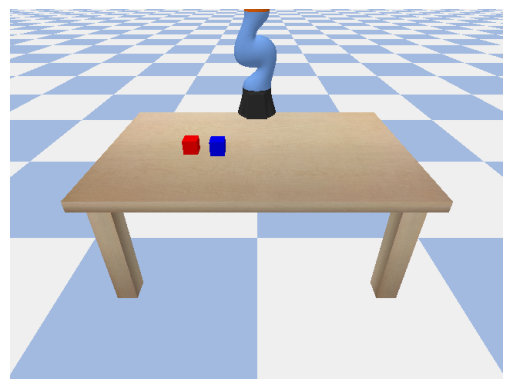

Intention: Lift blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


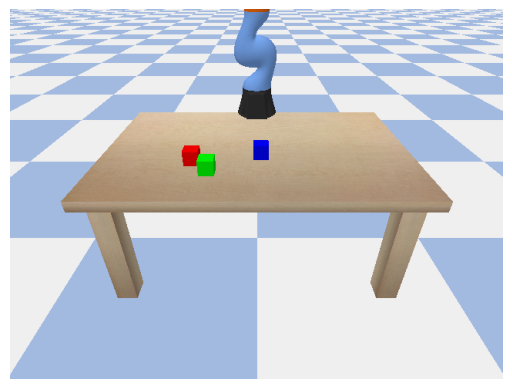

Intention: Carry blue; Reward: -1; Reason: exception (name 'sleep_for' is not defined)


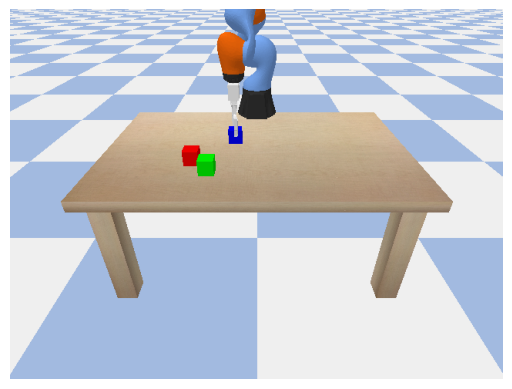

Intention: Carry blue; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


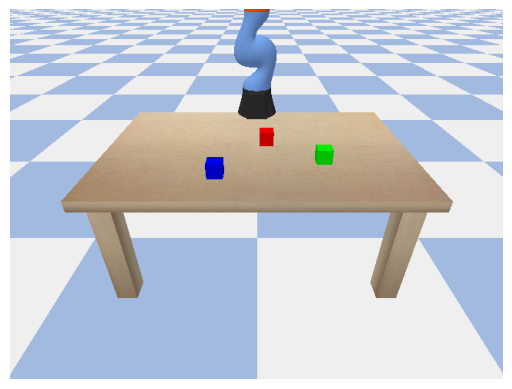

Intention: Grasp red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))
Grasped red.


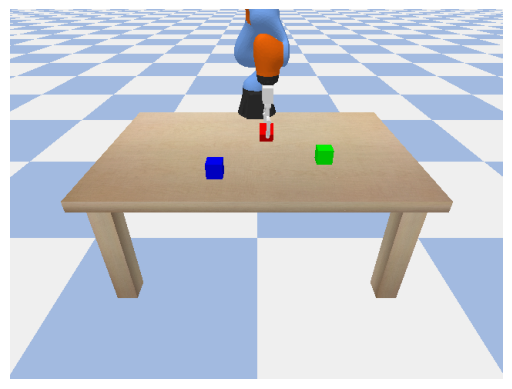

Intention: Grasp red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


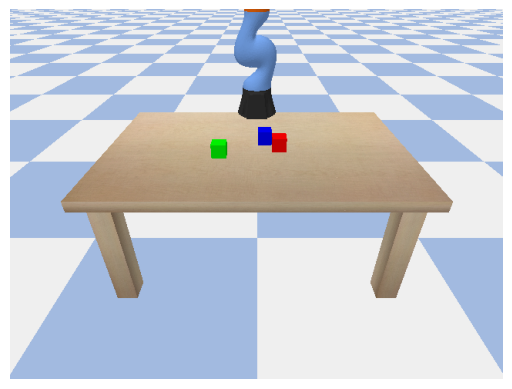

Intention: Collect blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


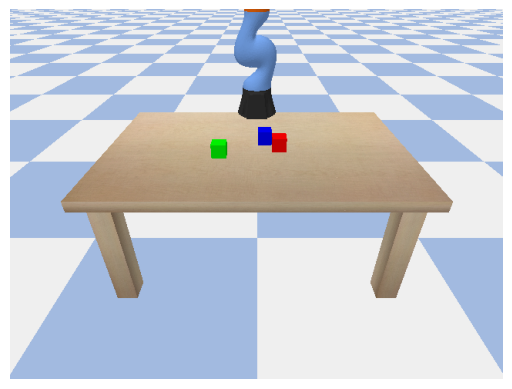

Intention: Collect blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


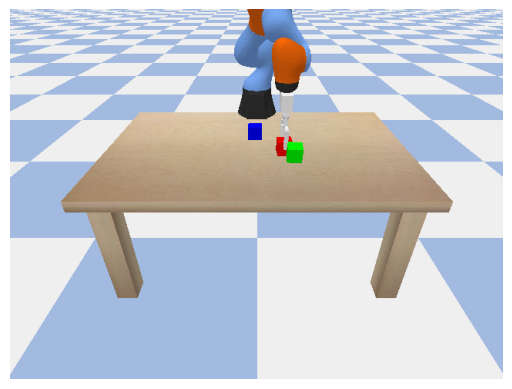

Intention: Acquire red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


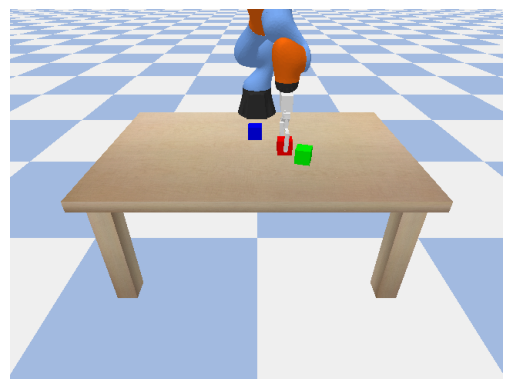

Intention: Acquire red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


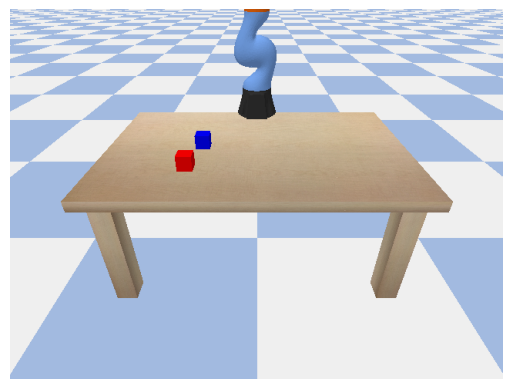

Intention: Seize red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


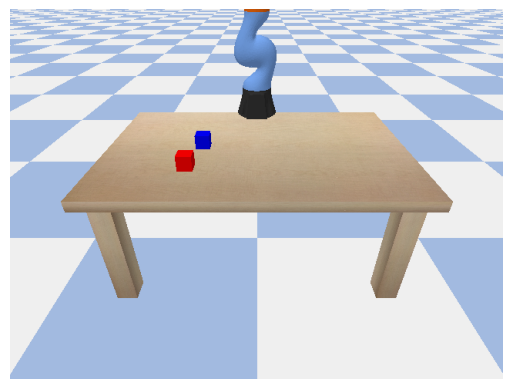

Intention: Seize red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))
Intention: Collect red; Reward: -1; Reason: extraction
Intention: Collect red; Reward: -1; Reason: extraction


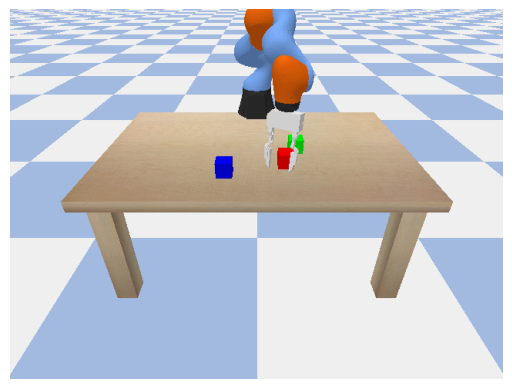

Intention: Acquire red; Reward: -1; Reason: timeout


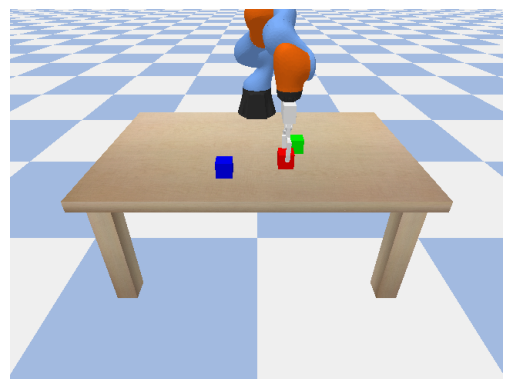

Intention: Acquire red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


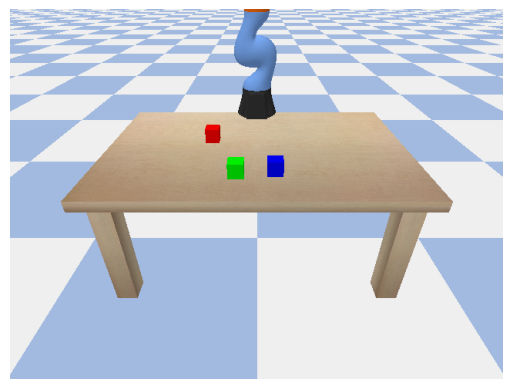

Intention: Grab red; Reward: -1; Reason: exception (name 'py' is not defined)


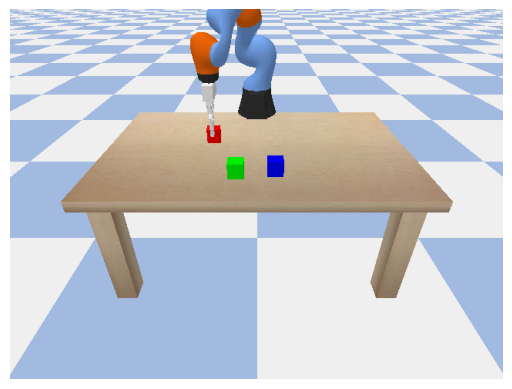

Intention: Grab red; Reward: 1; Reason: None


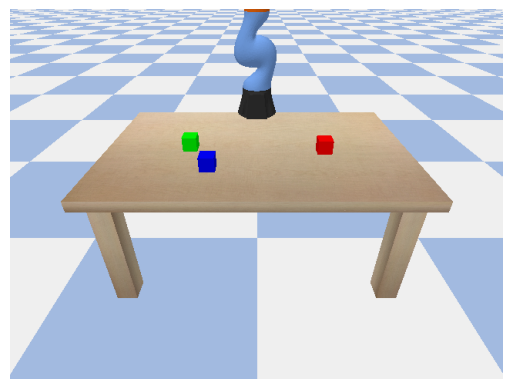

Exception in thread Thread-403 (update):
Traceback (most recent call last):
  File "/usr/lib/python3.11/threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "/tf/trl/trl-venv/lib/python3.11/site-packages/ipykernel/ipkernel.py", line 772, in run_closure
    _threading_Thread_run(self)
  File "/usr/lib/python3.11/threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "/tmp/ipykernel_10295/2296800803.py", line 58, in update
  File "/tf/trl/llarm/src/environment/base.py", line 297, in update
    self.__arm_controller.update(1 / self.__time_step)
  File "/tf/trl/llarm/src/controller/arm_controller.py", line 449, in update
    getattr(self, "_ArmController__update_" + self.__state.name + "_state")(delta)
  File "/tf/trl/llarm/src/controller/arm_controller.py", line 510, in __update_move_to_object_state
    position, _ = multiplyTransforms(
                  ^^^^^^^^^^^^^^^^^^^
pybullet.error: Invalid input: expected positionA [x,y,z], orientationA

Intention: Raise red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Raise red; Reward: -1; Reason: extraction


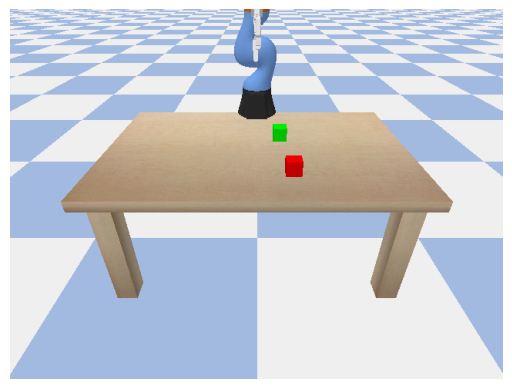

Intention: Take red; Reward: -1; Reason: timeout


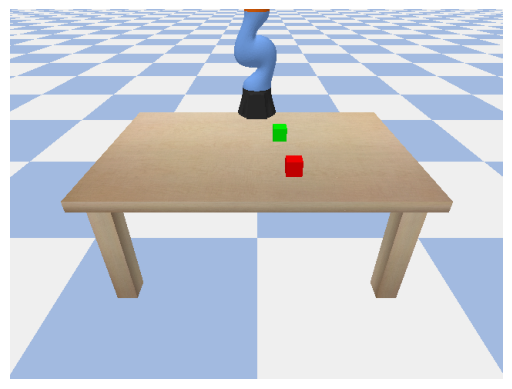

Intention: Take red; Reward: -1; Reason: exception (invalid syntax. Perhaps you forgot a comma? (<unknown>, line 5))
Intention: Hold blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction


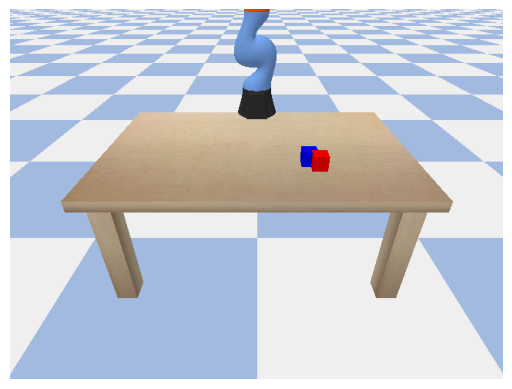

Intention: Grab blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


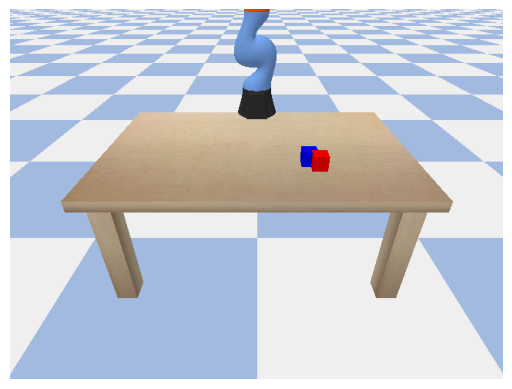

Intention: Grab blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


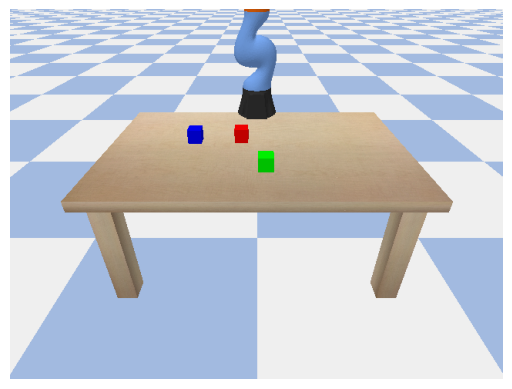

Intention: Take green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


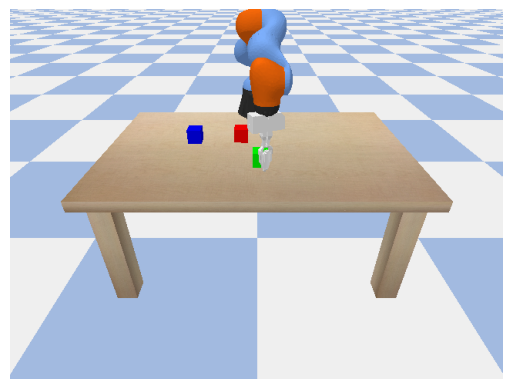

Intention: Take green; Reward: -1; Reason: timeout


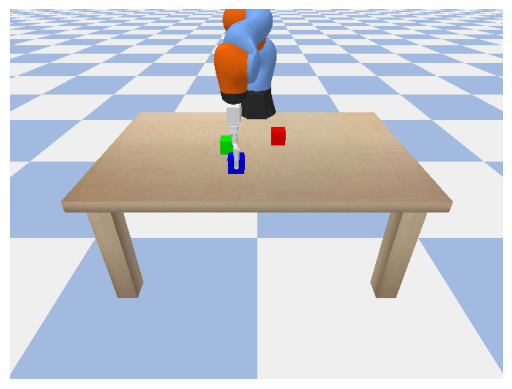

Intention: Get blue; Reward: 1; Reason: None


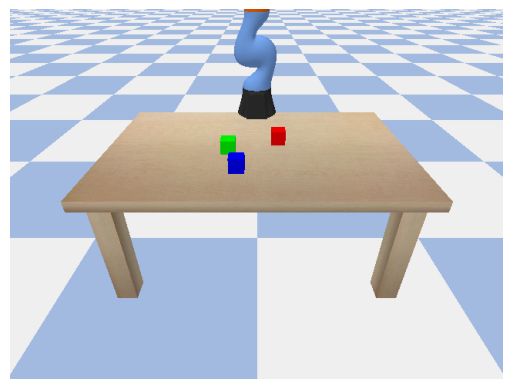

Intention: Get blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 4))


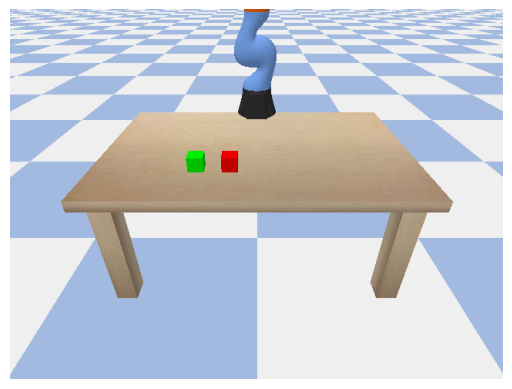

Intention: Retrieve green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


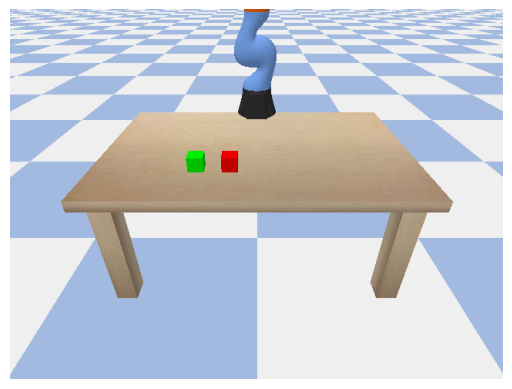

Intention: Retrieve green; Reward: -1; Reason: exception (unterminated string literal (detected at line 4) (<unknown>, line 4))
Intention: Hold green; Reward: -1; Reason: extraction


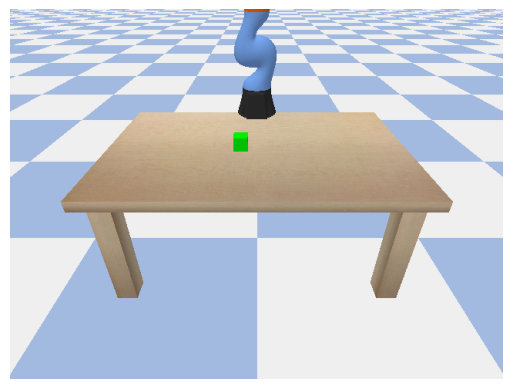

Intention: Hold green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


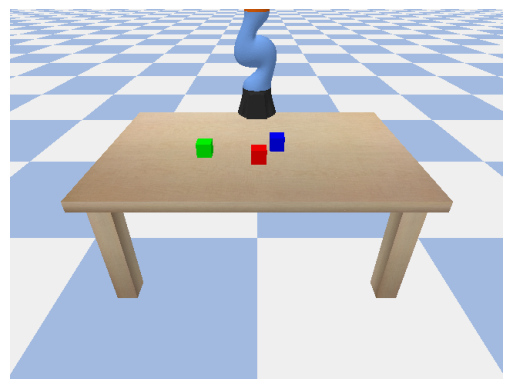

Intention: Pick green; Reward: 0; Reason: vlm (No)


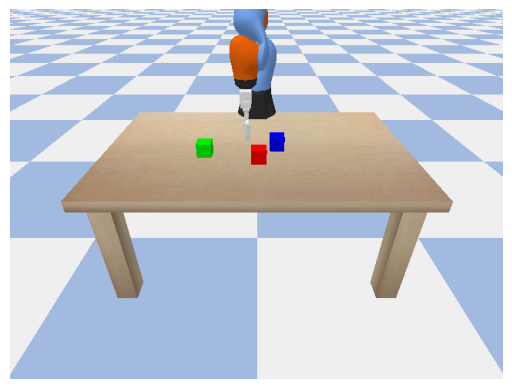

Intention: Pick green; Reward: 0; Reason: vlm (No)


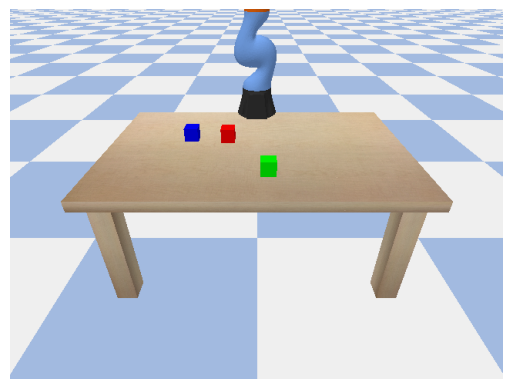

Intention: Lift red; Reward: -1; Reason: exception (name 'clo' is not defined)


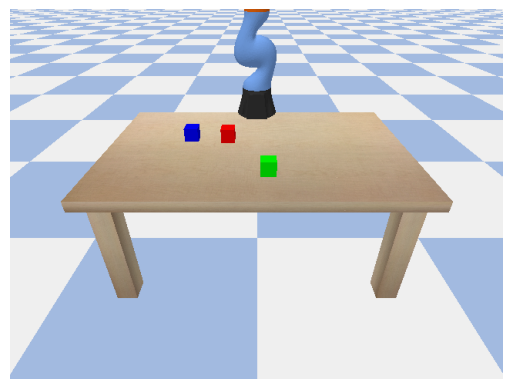

Intention: Lift red; Reward: 0; Reason: vlm (No)


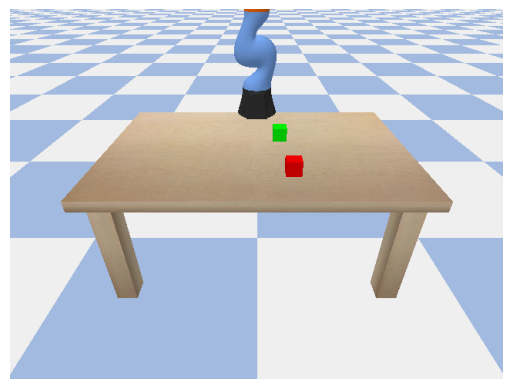

Intention: Take red; Reward: -1; Reason: exception (unterminated string literal (detected at line 3) (<unknown>, line 3))


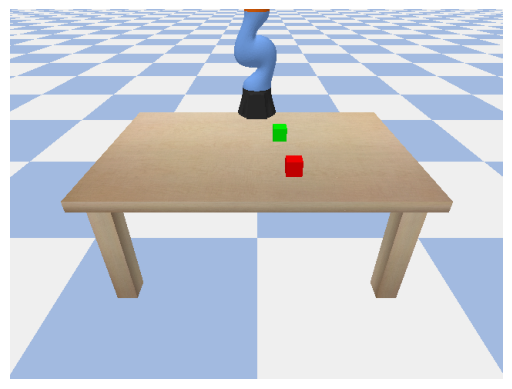

Intention: Take red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


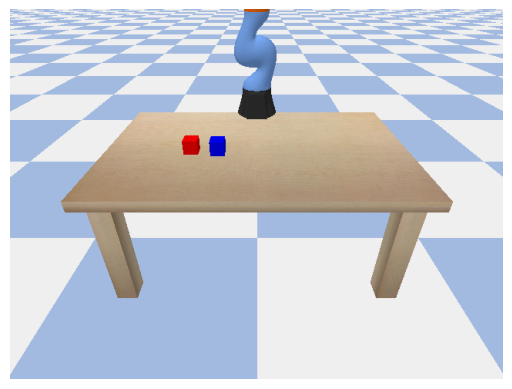

Intention: Lift blue; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))


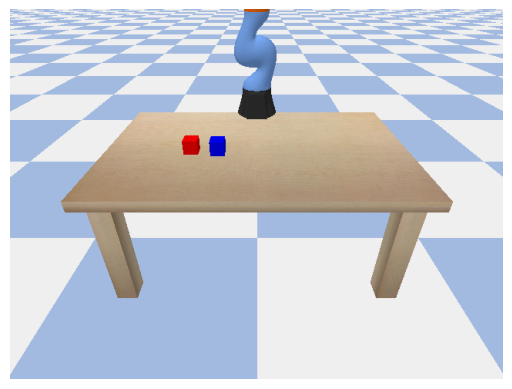

Intention: Lift blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


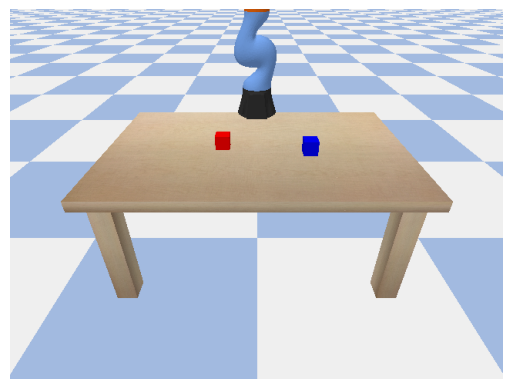

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


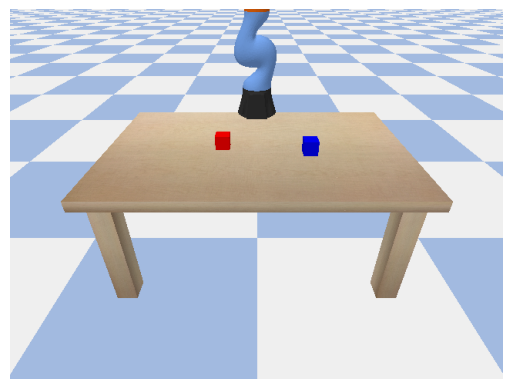

Intention: Fetch blue; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))
Intention: Carry red; Reward: -1; Reason: extraction


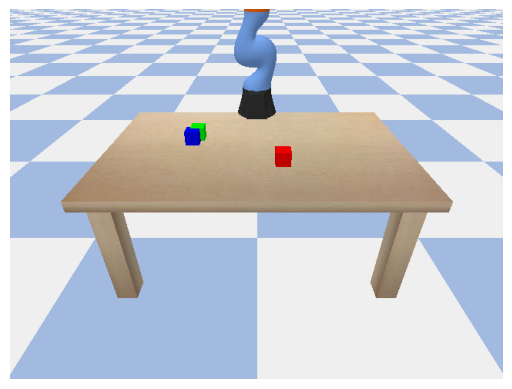

Intention: Carry red; Reward: 0; Reason: vlm (No)


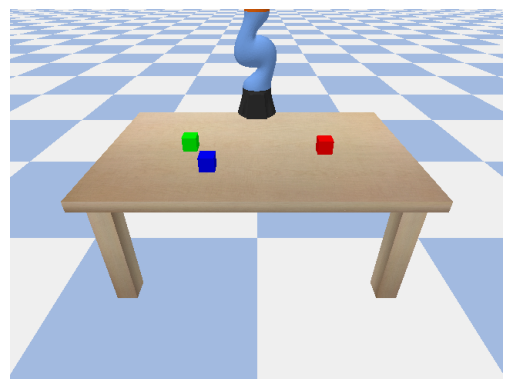

Intention: Raise red; Reward: 0; Reason: vlm (No)


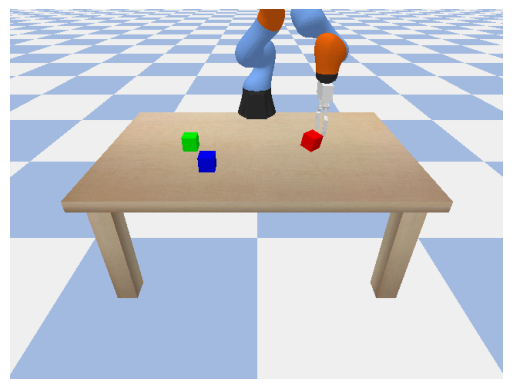

Intention: Raise red; Reward: 0; Reason: vlm (No)


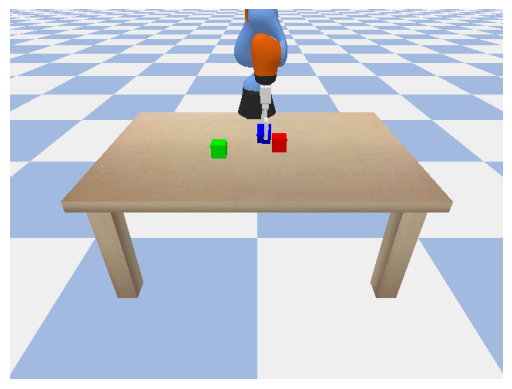

Intention: Collect blue; Reward: 0; Reason: vlm (No)


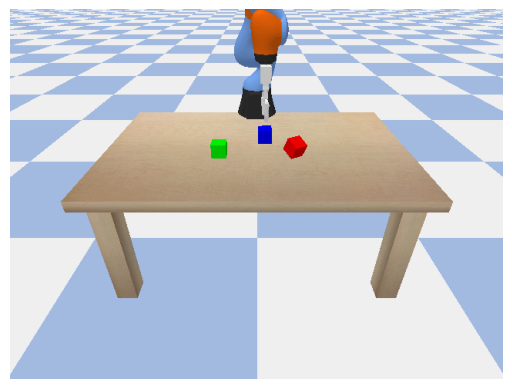

Intention: Collect blue; Reward: 0; Reason: vlm (No)


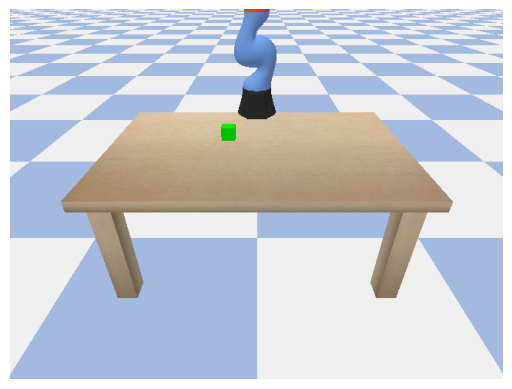

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


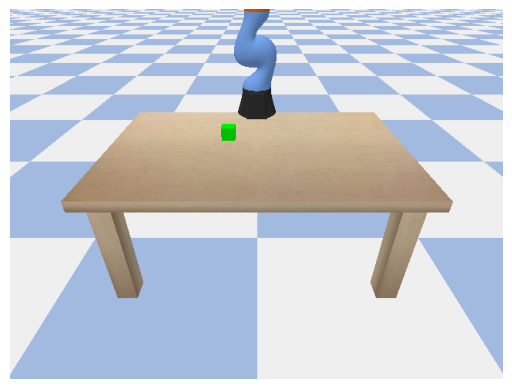

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


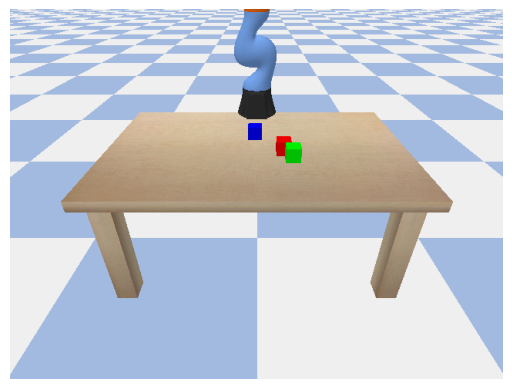

Intention: Acquire red; Reward: -1; Reason: exception (name 'place_cube' is not defined)


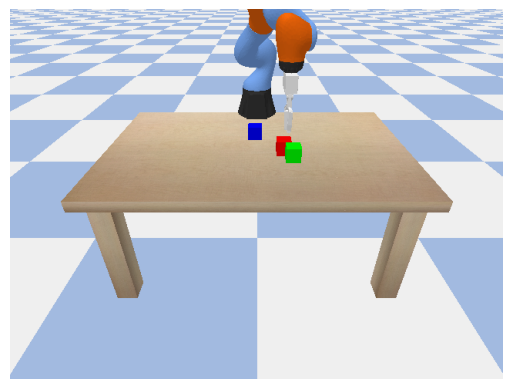

Intention: Acquire red; Reward: 1; Reason: None


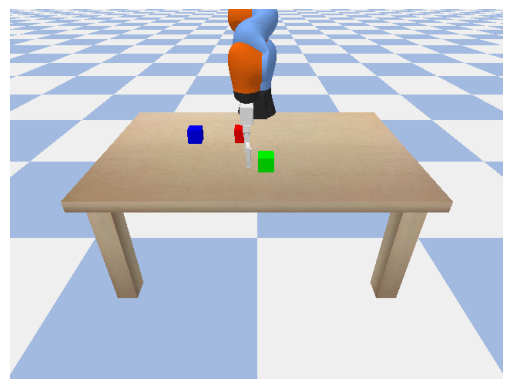

Intention: Take green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


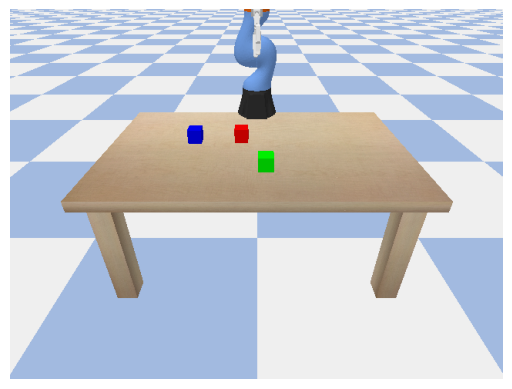

Intention: Take green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


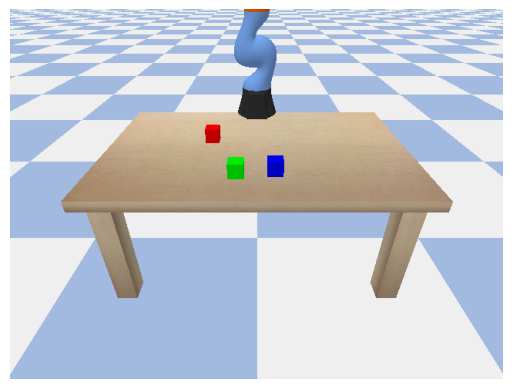

Intention: Grab red; Reward: -1; Reason: exception (name 'python' is not defined)


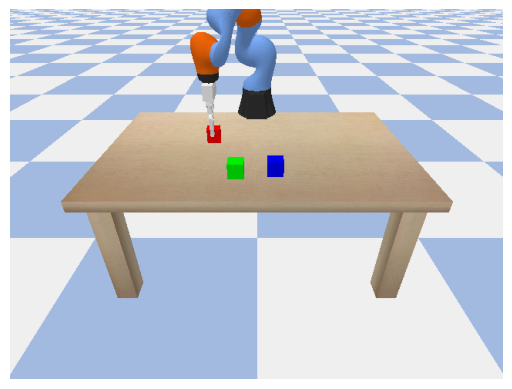

Intention: Grab red; Reward: 1; Reason: None


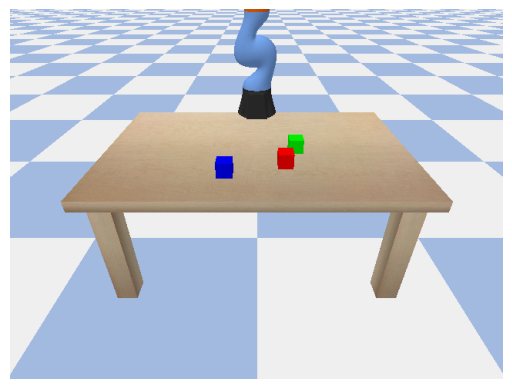

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


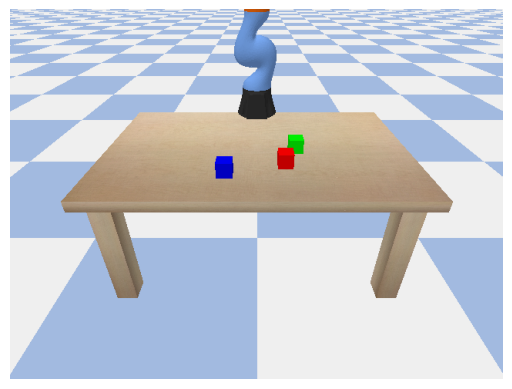

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Hold green; Reward: -1; Reason: extraction
Intention: Hold green; Reward: -1; Reason: extraction
Intention: Fetch blue; Reward: -1; Reason: extraction


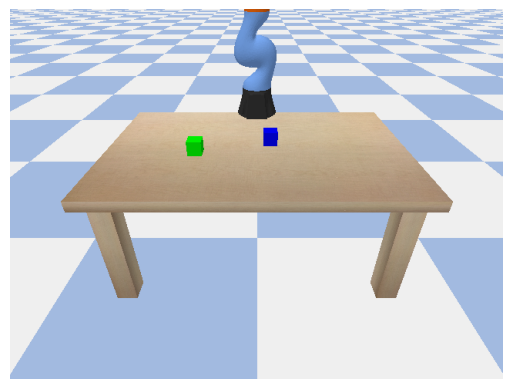

Intention: Fetch blue; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


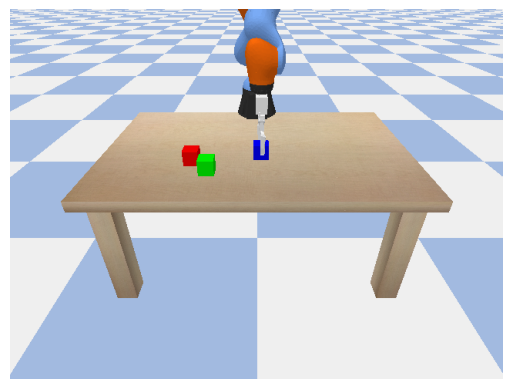

Intention: Carry blue; Reward: -1; Reason: exception (name 'hold' is not defined)


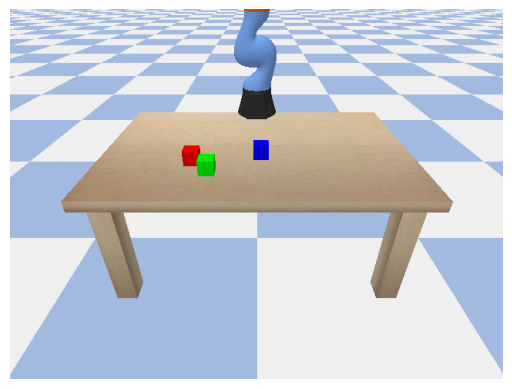

Intention: Carry blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


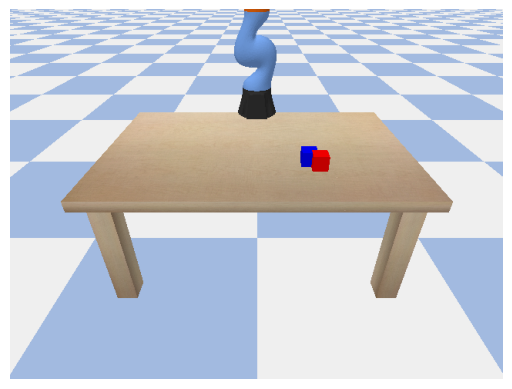

Intention: Grab blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


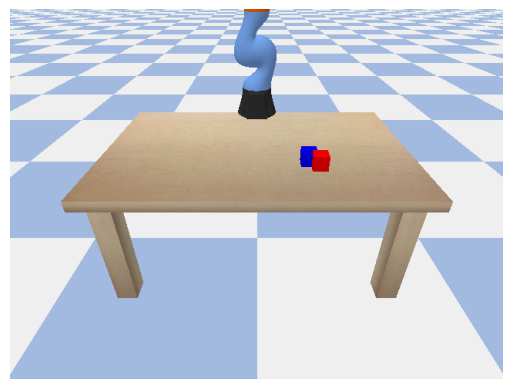

Intention: Grab blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


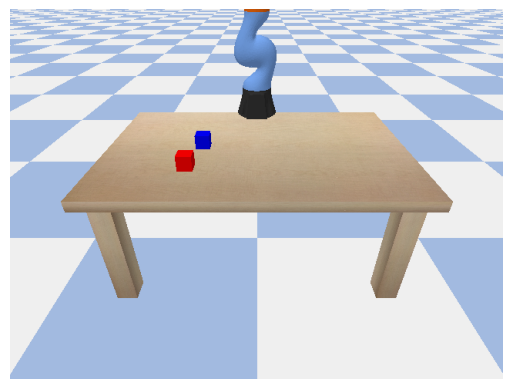

Intention: Seize red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


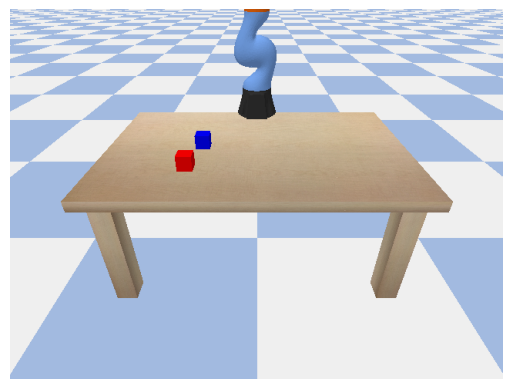

Intention: Seize red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


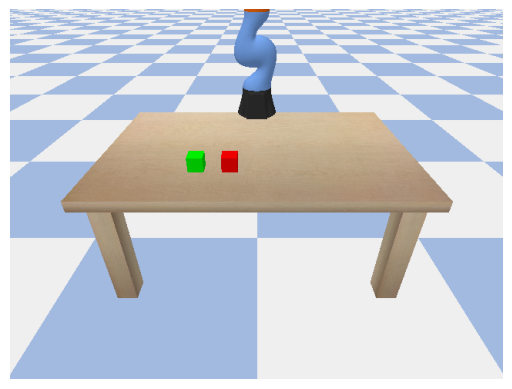

Intention: Retrieve green; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


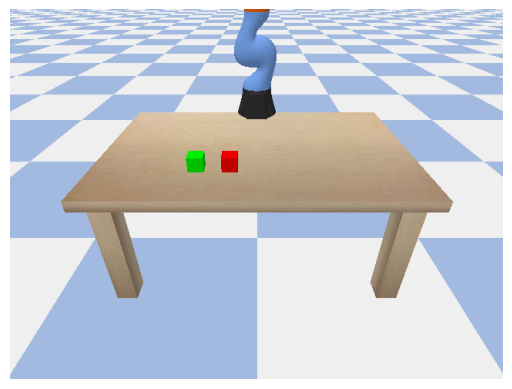

Intention: Retrieve green; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


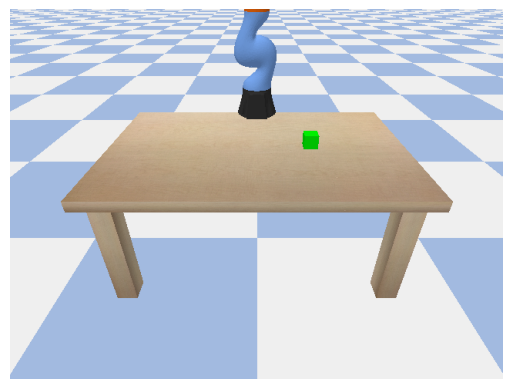

Intention: Pick green; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


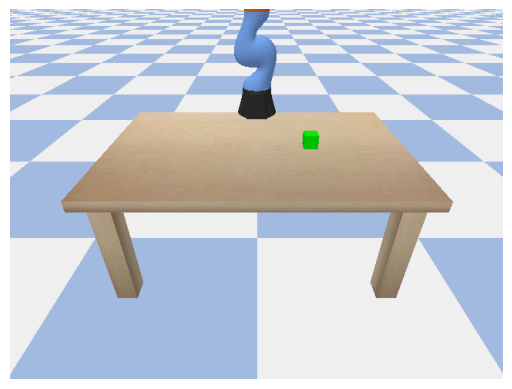

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


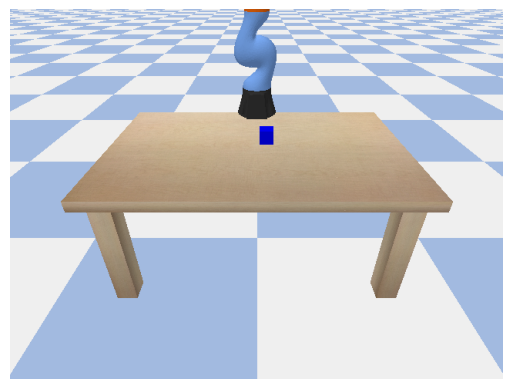

Intention: Hold blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))
Intention: Hold blue; Reward: -1; Reason: extraction


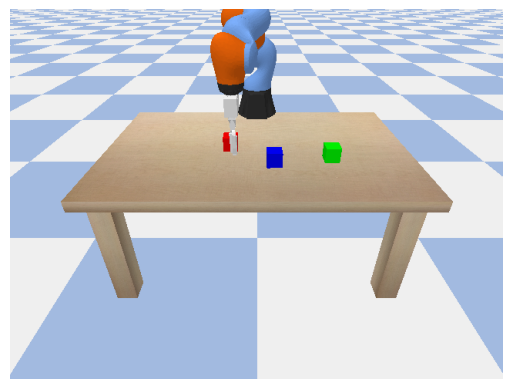

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


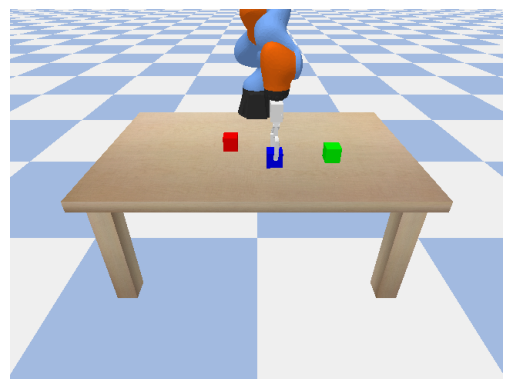

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


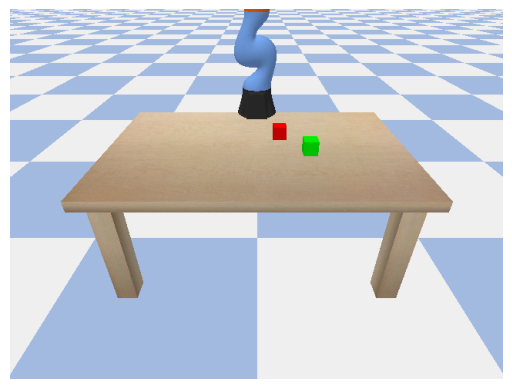

Intention: Hoist green; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 1))


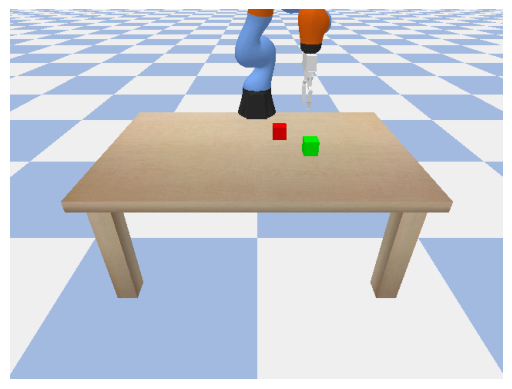

Intention: Hoist green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


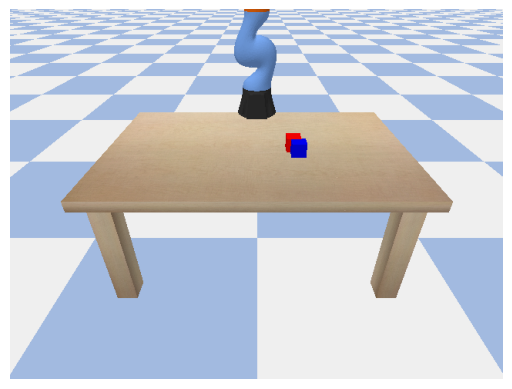

Intention: Hoist red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


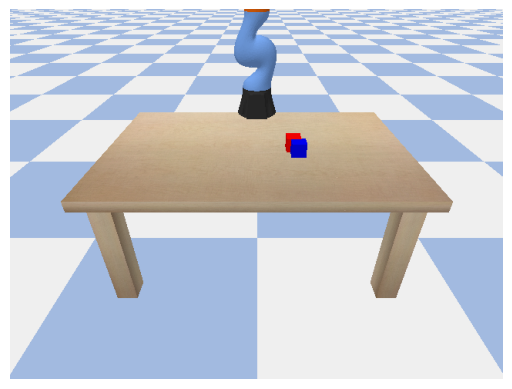

Intention: Hoist red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


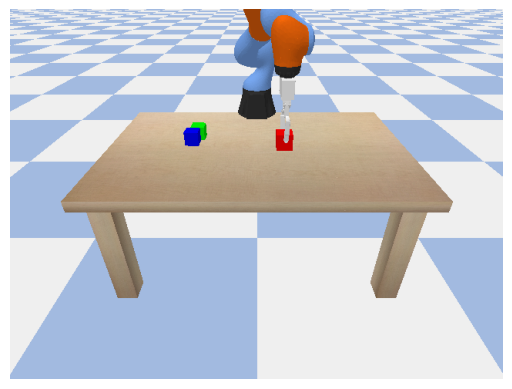

Intention: Carry red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


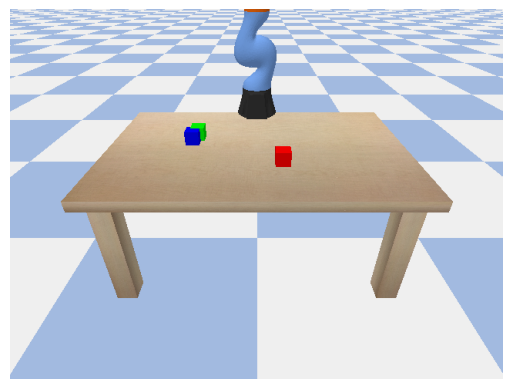

Intention: Carry red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 74))


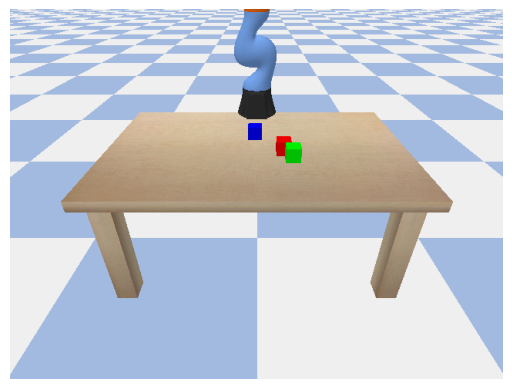

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


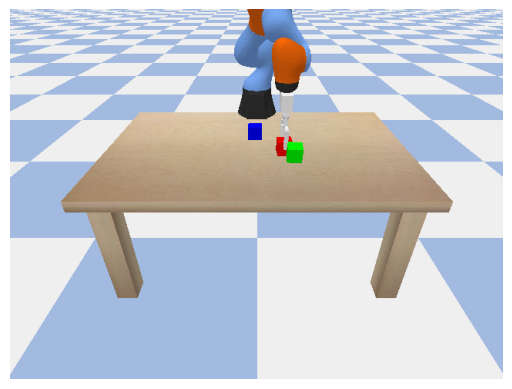

Intention: Acquire red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


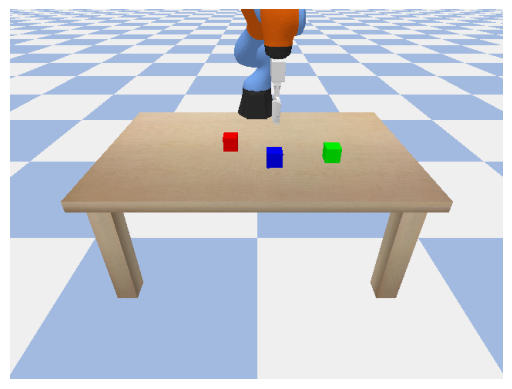

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


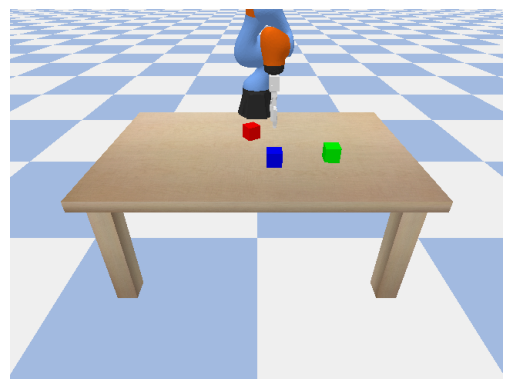

Intention: Retrieve blue; Reward: -1; Reason: timeout


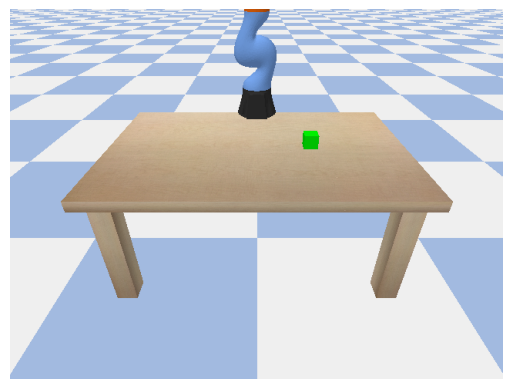

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Pick green; Reward: -1; Reason: extraction


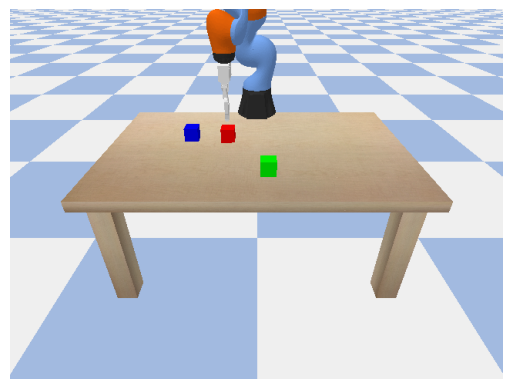

Intention: Lift red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


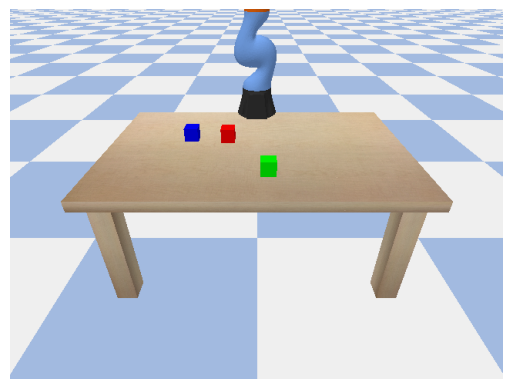

Intention: Lift red; Reward: -1; Reason: exception (name 'py' is not defined)


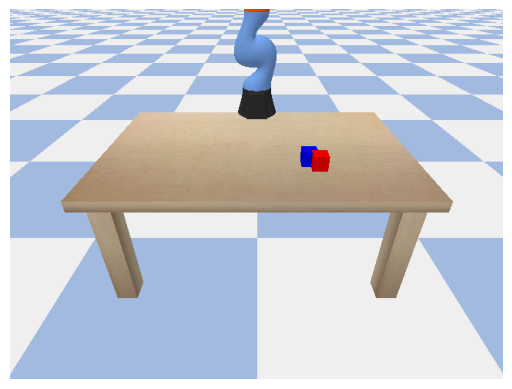

Intention: Grab blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))
Intention: Grab blue; Reward: -1; Reason: extraction


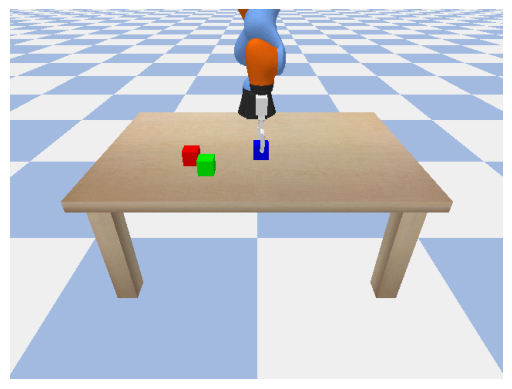

Intention: Carry blue; Reward: 1; Reason: None


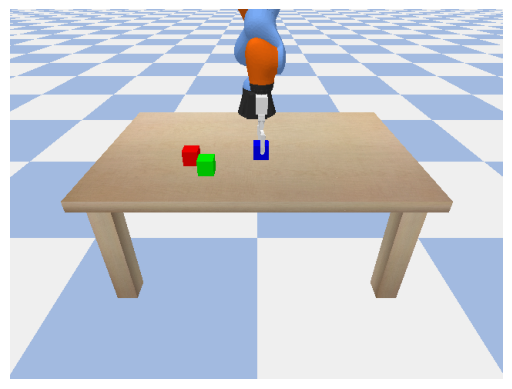

Intention: Carry blue; Reward: -1; Reason: exception (name 'obj_in_gripper' is not defined)


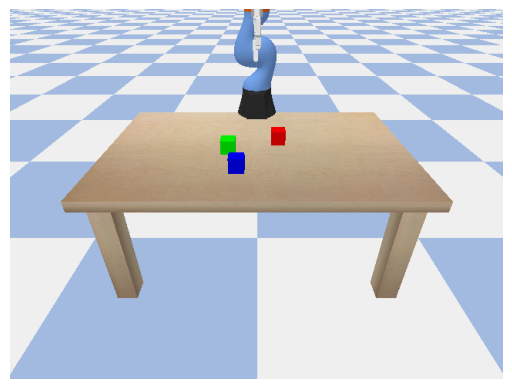

Intention: Get blue; Reward: -1; Reason: exception (name 'cube' is not defined)


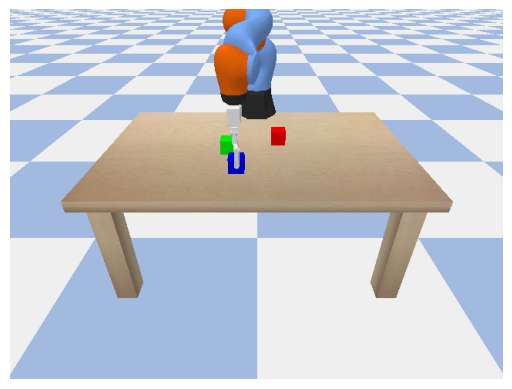

Intention: Get blue; Reward: 1; Reason: None


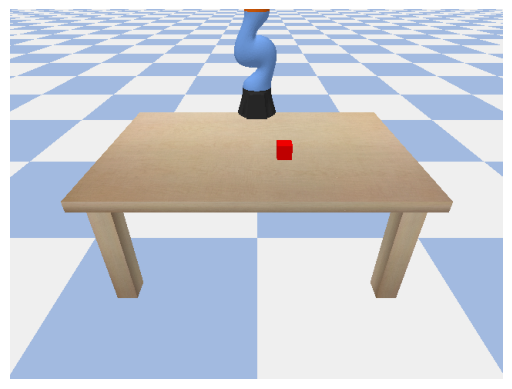

Intention: Get red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


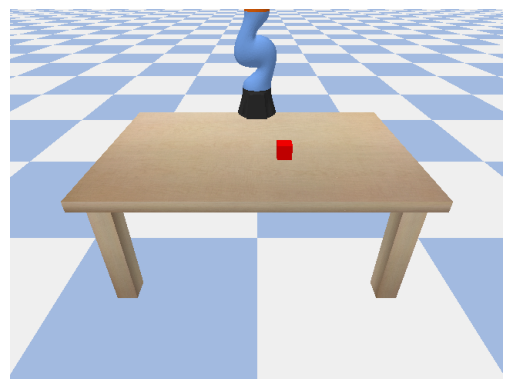

Intention: Get red; Reward: -1; Reason: exception (unmatched ')' (<unknown>, line 3))


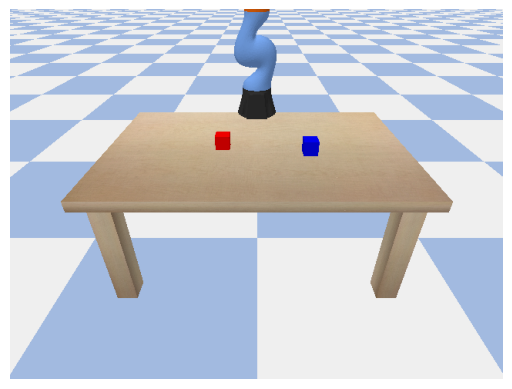

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


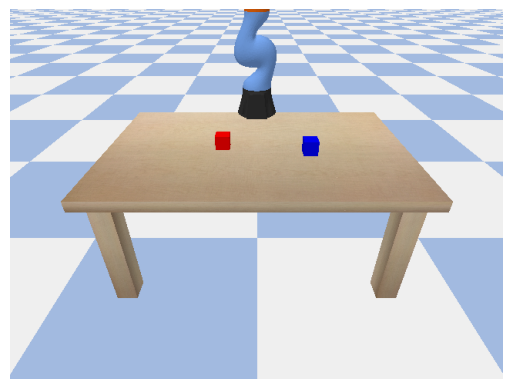

Intention: Fetch blue; Reward: -1; Reason: exception (invalid syntax. Perhaps you forgot a comma? (<unknown>, line 4))


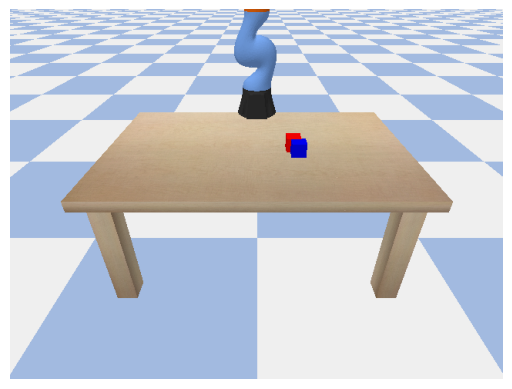

Intention: Hoist red; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


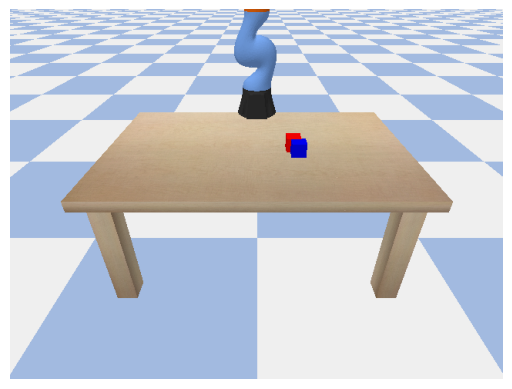

Intention: Hoist red; Reward: -1; Reason: exception (invalid decimal literal (<unknown>, line 4))


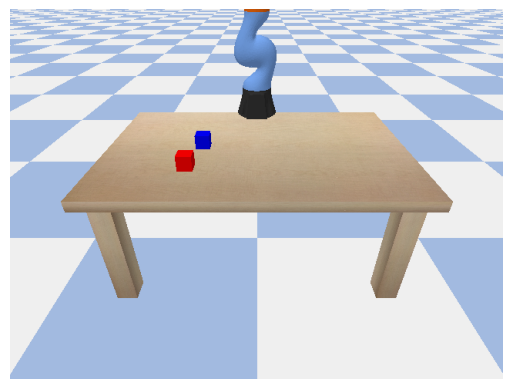

Intention: Seize red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


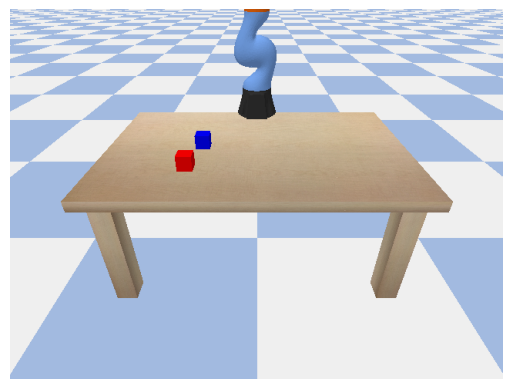

Intention: Seize red; Reward: -1; Reason: exception (closing parenthesis ')' does not match opening parenthesis '[' (<unknown>, line 3))
Intention: Hold green; Reward: -1; Reason: extraction
Intention: Hold green; Reward: -1; Reason: extraction


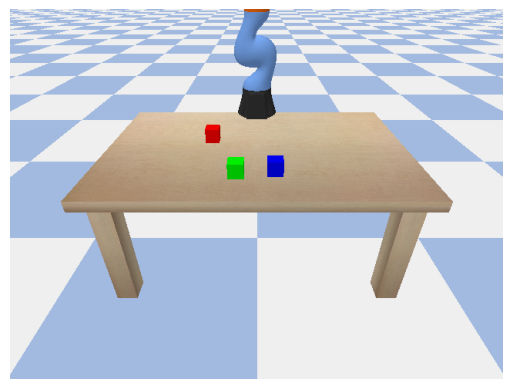

Intention: Grab red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


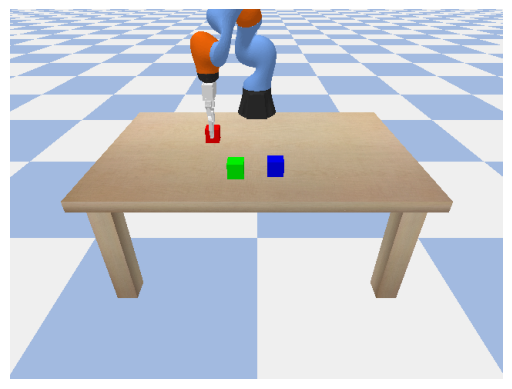

Intention: Grab red; Reward: 1; Reason: None
Intention: Hold blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction


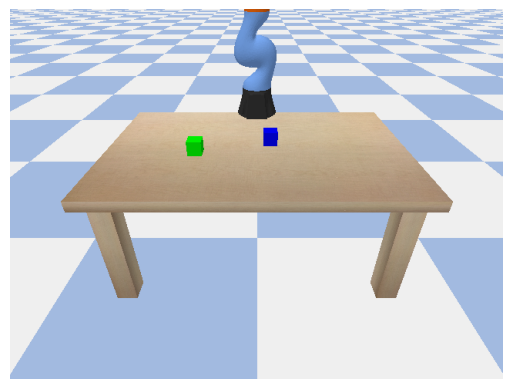

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


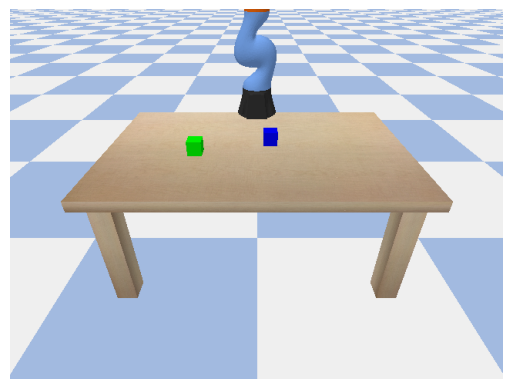

Intention: Fetch blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 3))


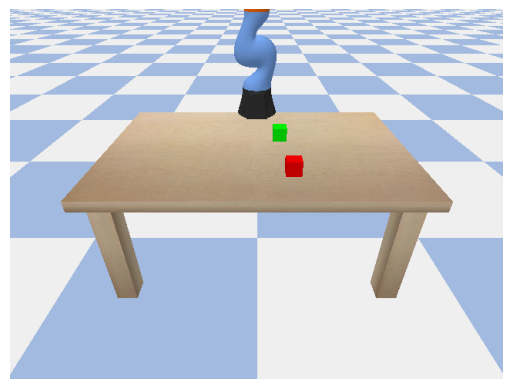

Intention: Take red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 4))


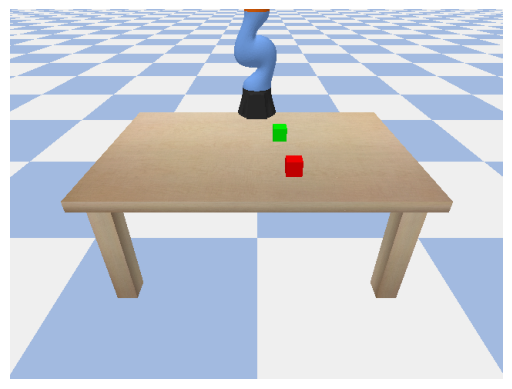

Intention: Take red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


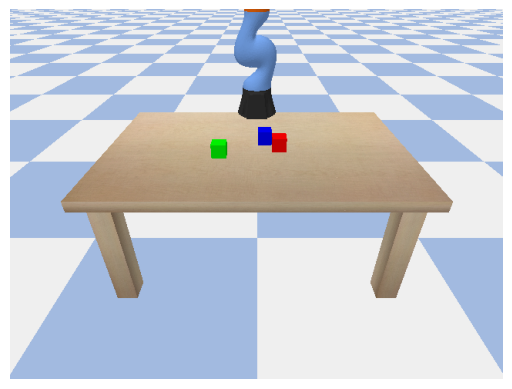

Intention: Collect blue; Reward: 1; Reason: None


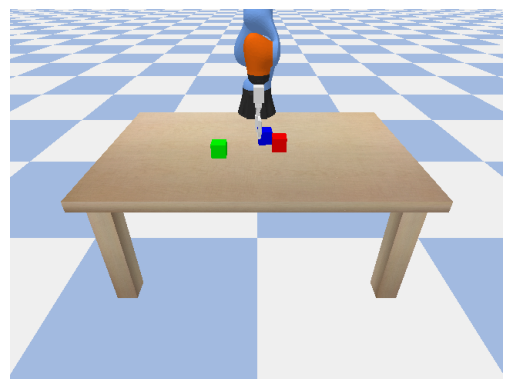

Intention: Collect blue; Reward: 1; Reason: None


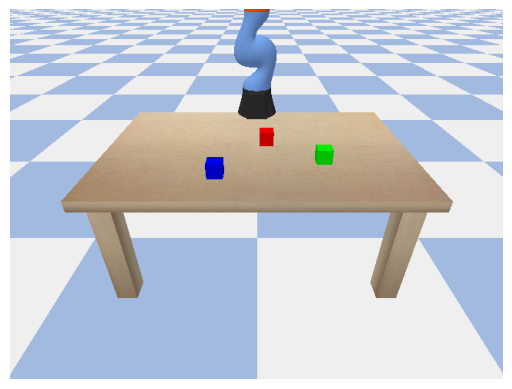

Intention: Grasp red; Reward: -1; Reason: exception (name 'python' is not defined)


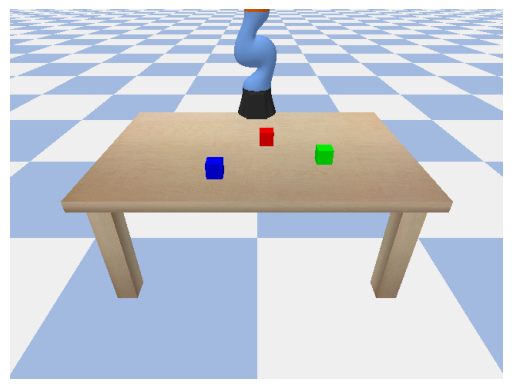

Intention: Grasp red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


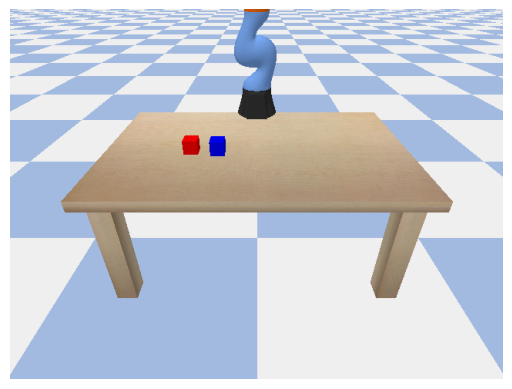

Intention: Lift blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


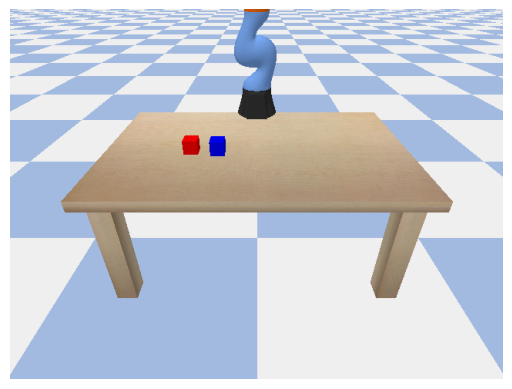

Intention: Lift blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


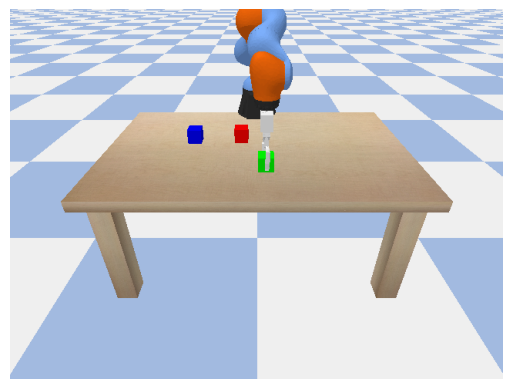

Intention: Take green; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


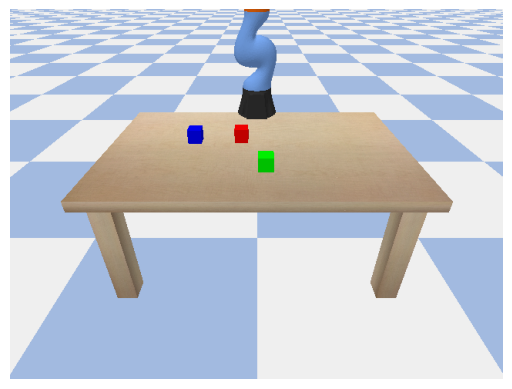

Intention: Take green; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


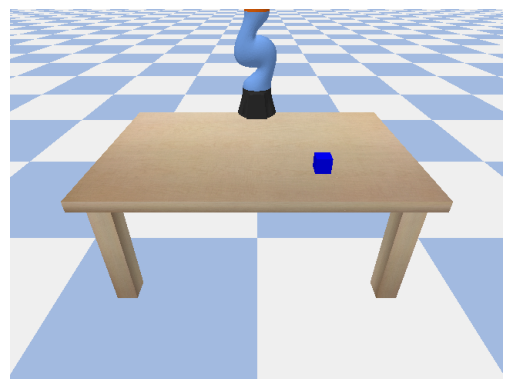

Intention: Grasp blue; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 3))


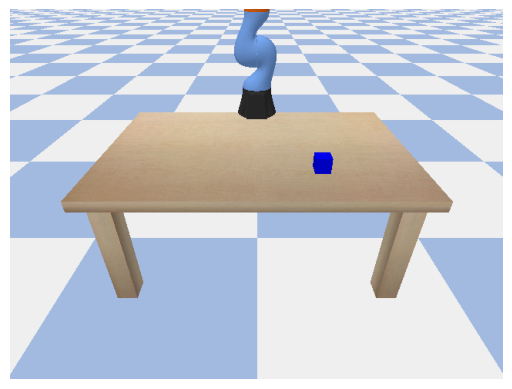

Intention: Grasp blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 2 (<unknown>, line 3))


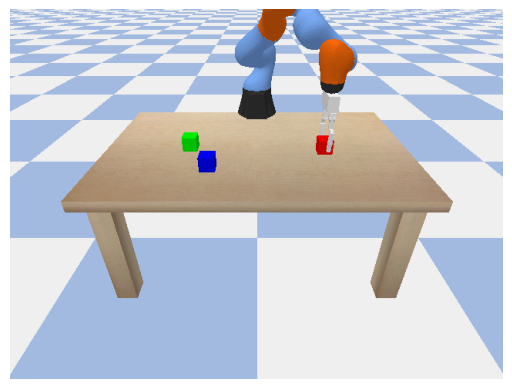

Intention: Raise red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


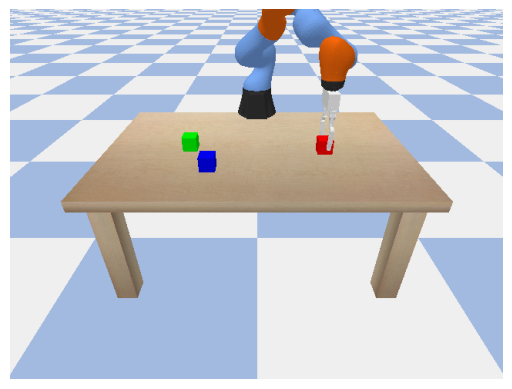

Intention: Raise red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


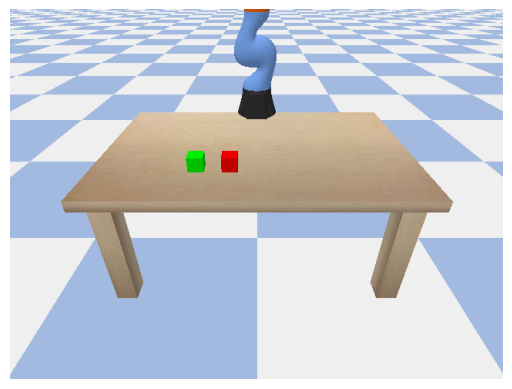

Intention: Retrieve green; Reward: -1; Reason: exception (unmatched ']' (<unknown>, line 5))


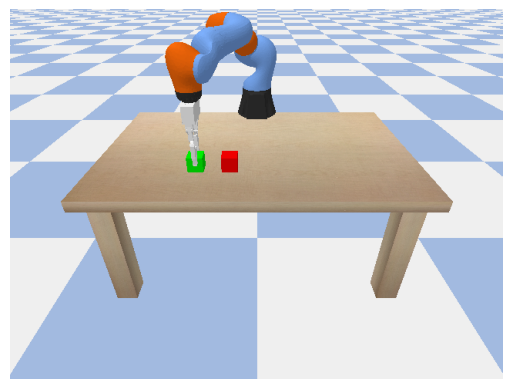

Intention: Retrieve green; Reward: 1; Reason: None


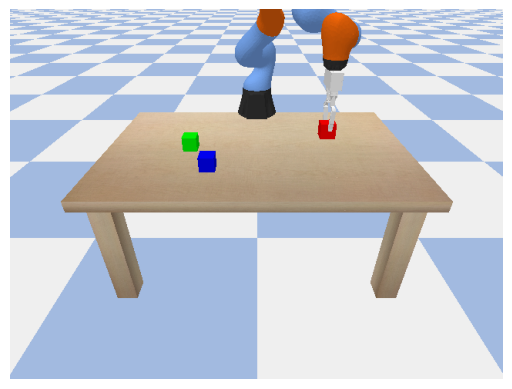

Intention: Raise red; Reward: 1; Reason: None
Intention: Raise red; Reward: -1; Reason: extraction


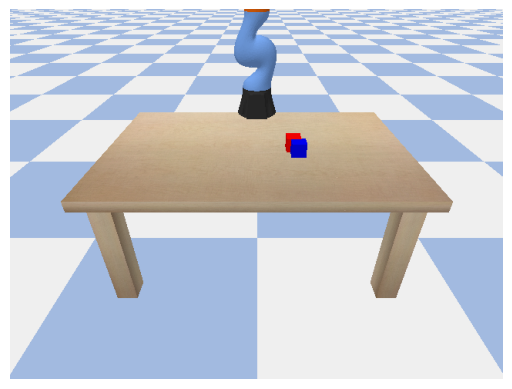

Intention: Hoist red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Hoist red; Reward: -1; Reason: extraction


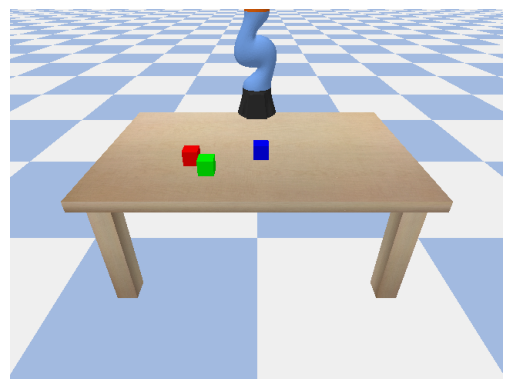

Intention: Carry blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


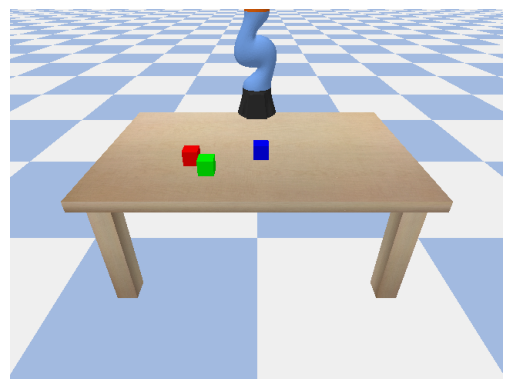

Intention: Carry blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


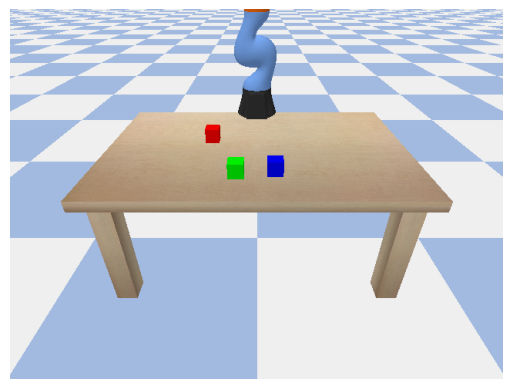

Intention: Grab red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


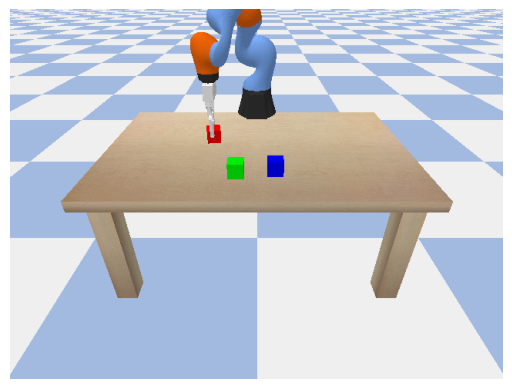

Intention: Grab red; Reward: 1; Reason: None


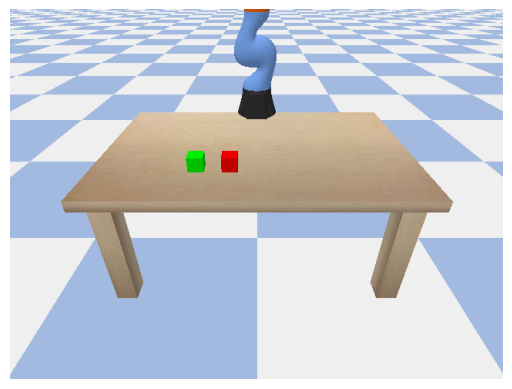

Intention: Retrieve green; Reward: -1; Reason: exception (invalid decimal literal (<unknown>, line 5))


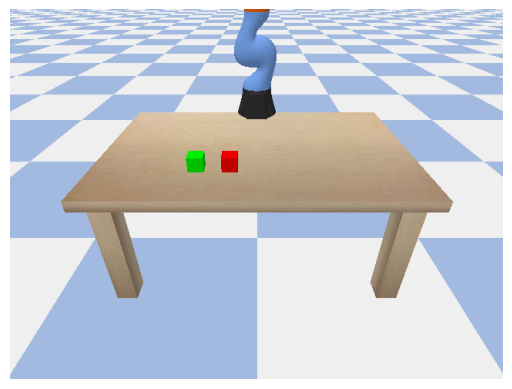

Intention: Retrieve green; Reward: 1; Reason: None
Intention: Hold green; Reward: -1; Reason: extraction


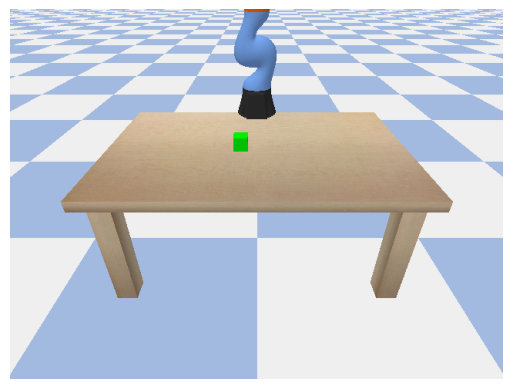

Intention: Hold green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


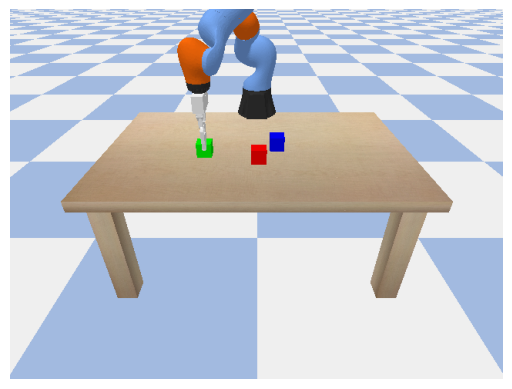

Intention: Pick green; Reward: 1; Reason: None


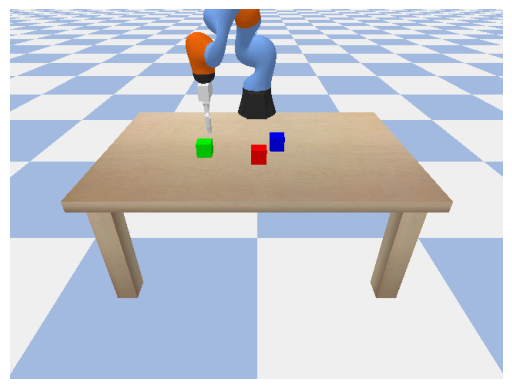

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


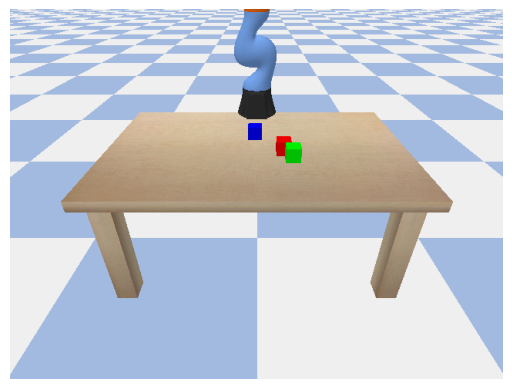

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Acquire red; Reward: -1; Reason: extraction
Intention: Grab blue; Reward: -1; Reason: extraction


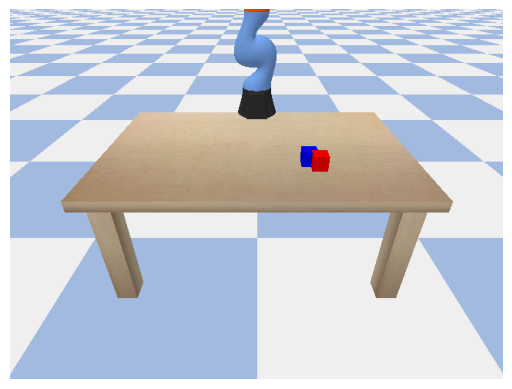

Intention: Grab blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


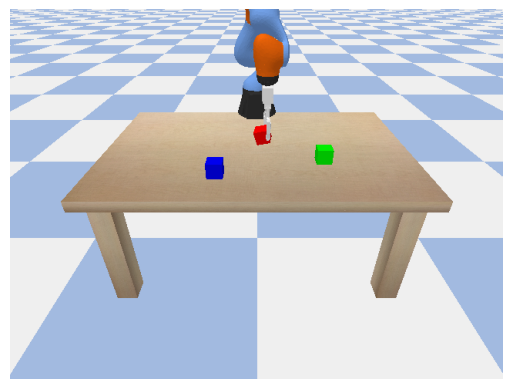

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


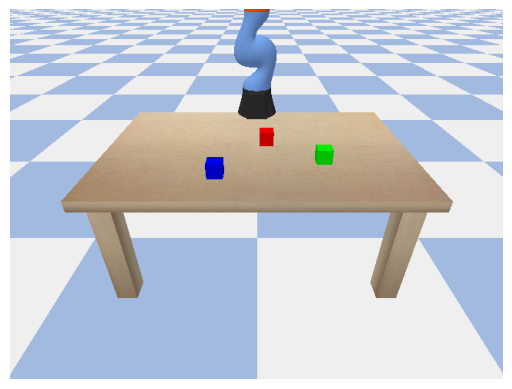

Intention: Grasp red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


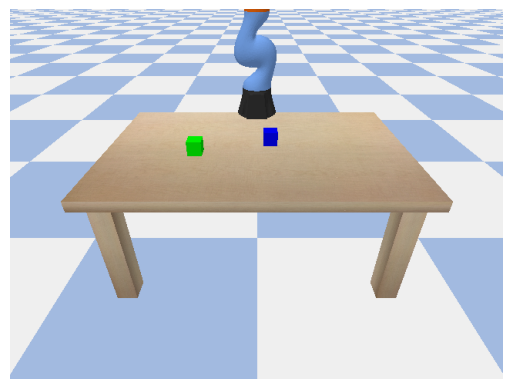

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


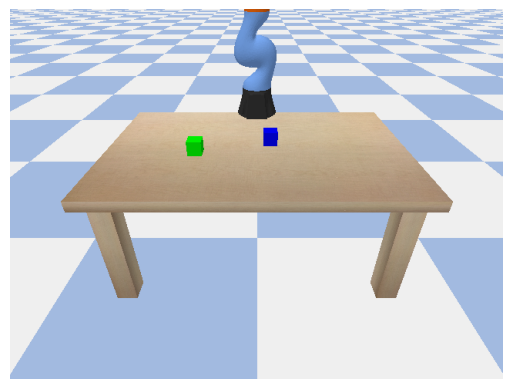

Intention: Fetch blue; Reward: -1; Reason: exception (invalid syntax. Perhaps you forgot a comma? (<unknown>, line 3))


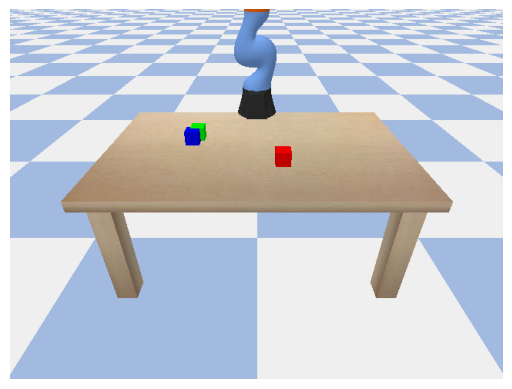

Intention: Carry red; Reward: -1; Reason: exception (name 'python' is not defined)


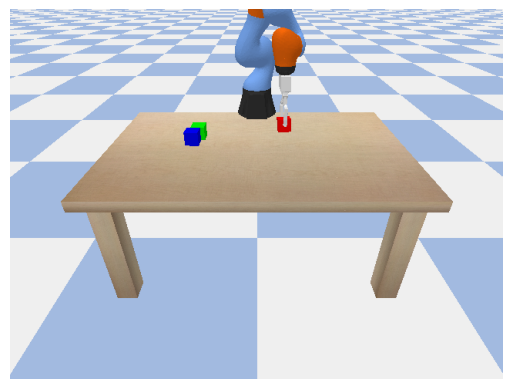

Intention: Carry red; Reward: -1; Reason: timeout
Intention: Lift blue; Reward: -1; Reason: extraction


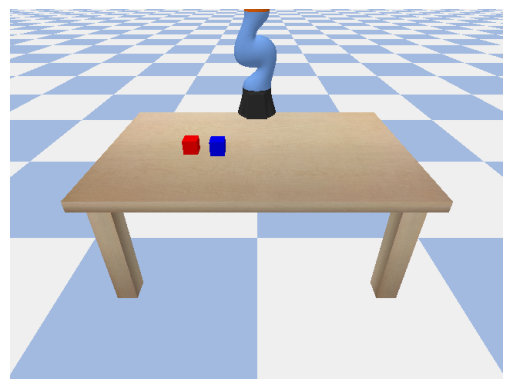

Intention: Lift blue; Reward: -1; Reason: exception (name 'main' is not defined)


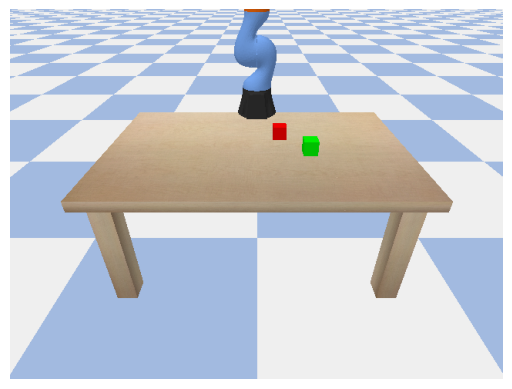

Intention: Hoist green; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))


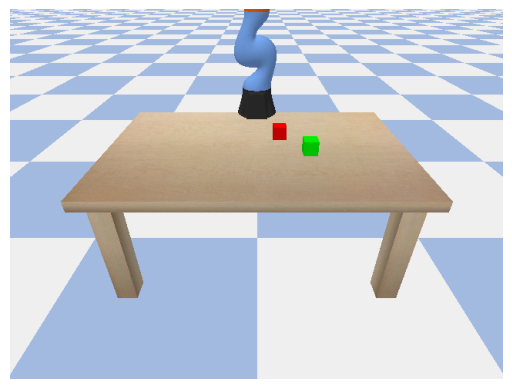

Intention: Hoist green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


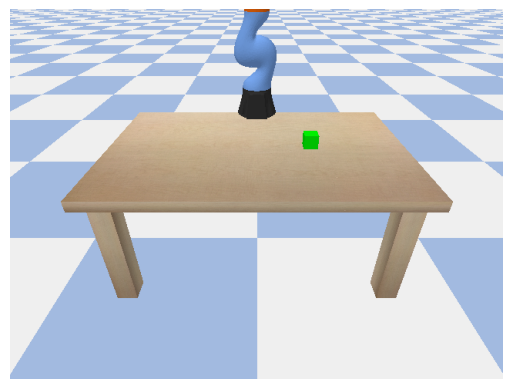

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


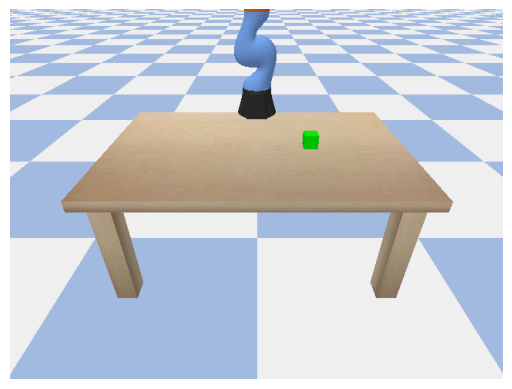

Intention: Pick green; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 1))


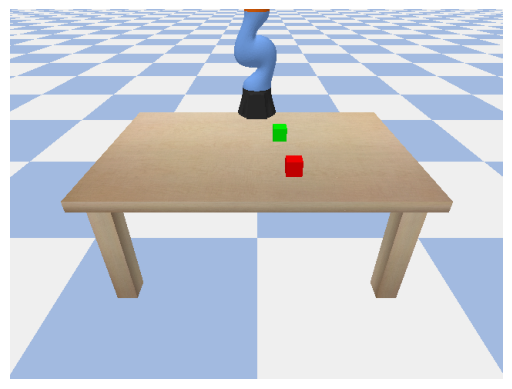

Intention: Take red; Reward: -1; Reason: exception (leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<unknown>, line 3))


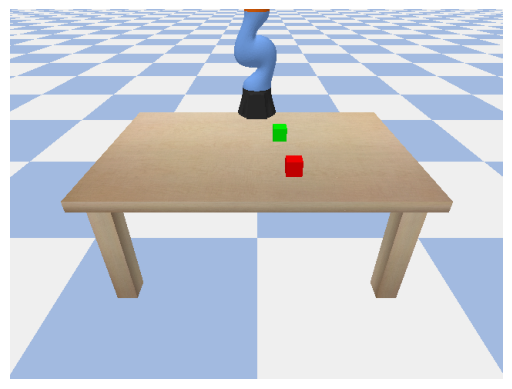

Intention: Take red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))
Intention: Collect red; Reward: -1; Reason: extraction


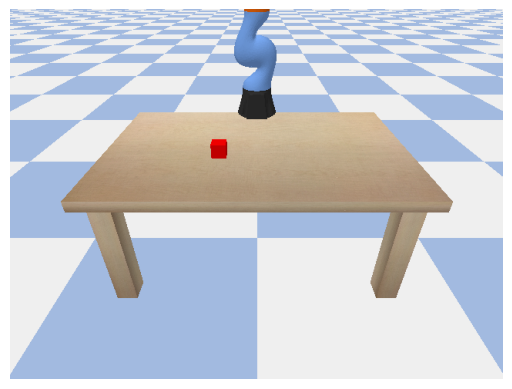

Intention: Collect red; Reward: -1; Reason: exception (expected '(' (<unknown>, line 2))


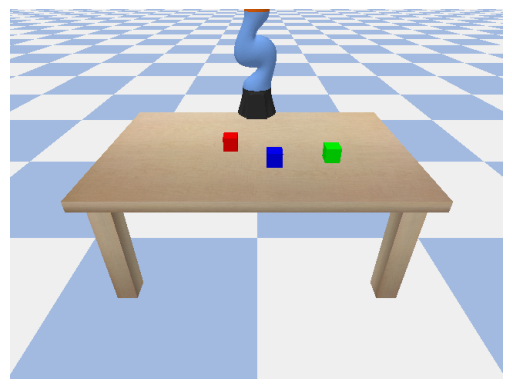

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


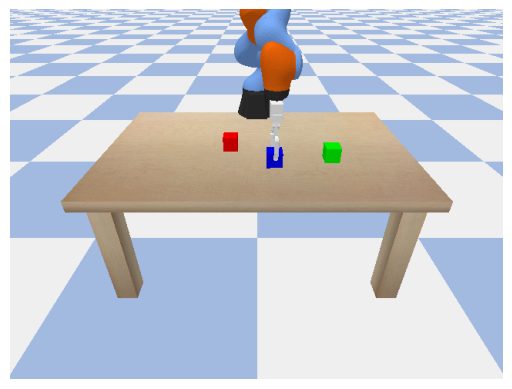

Intention: Retrieve blue; Reward: 1; Reason: None
Intention: Hold blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction


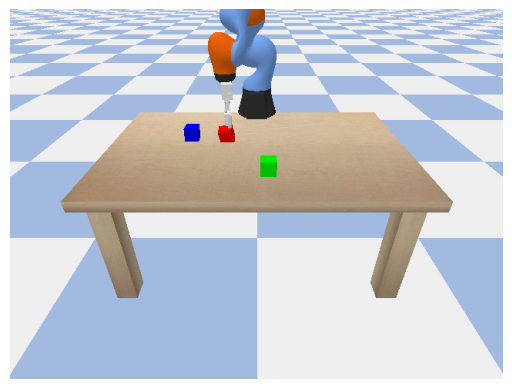

Intention: Lift red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


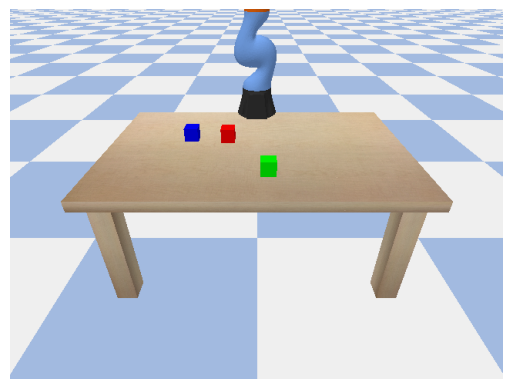

Intention: Lift red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


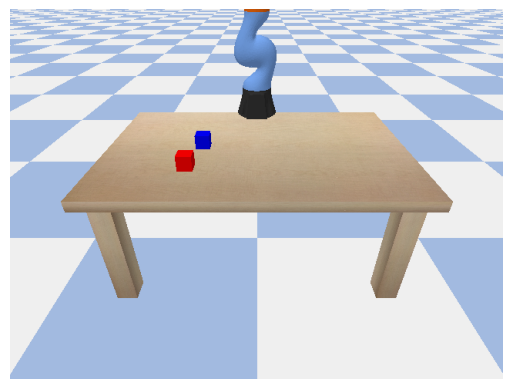

Intention: Seize red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


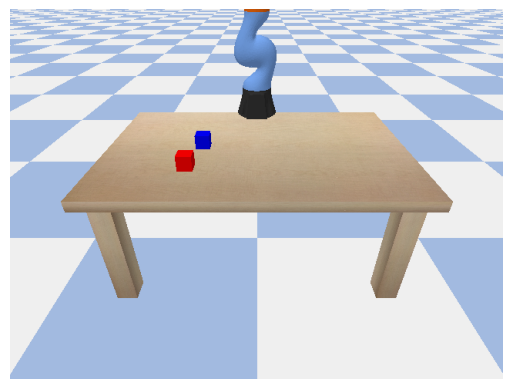

Intention: Seize red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))


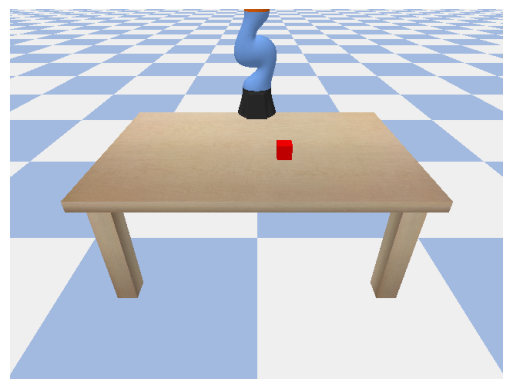

Intention: Get red; Reward: -1; Reason: exception (expected an indented block after function definition on line 2 (<unknown>, line 2))


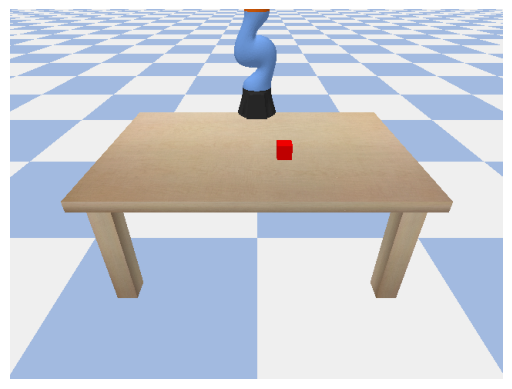

Intention: Get red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


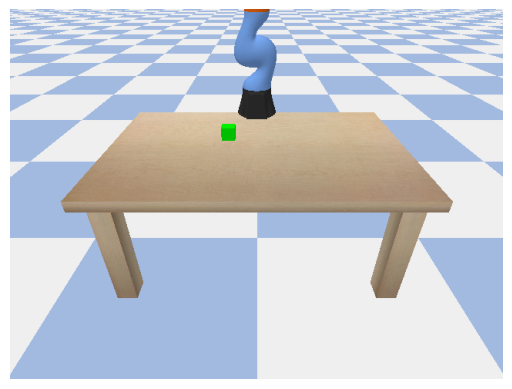

Intention: Seize green; Reward: -1; Reason: exception (expected ':' (<unknown>, line 2))


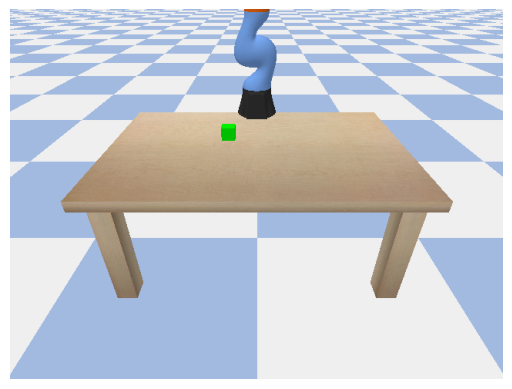

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


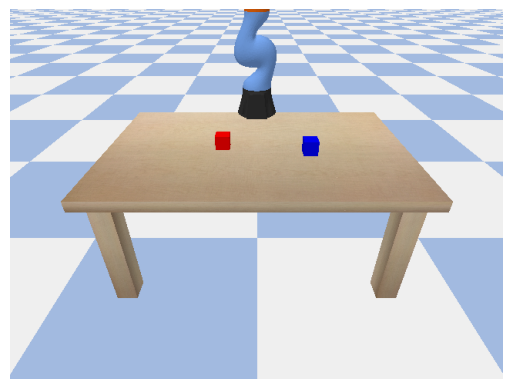

Intention: Fetch blue; Reward: -1; Reason: exception (unindent does not match any outer indentation level (<unknown>, line 4))


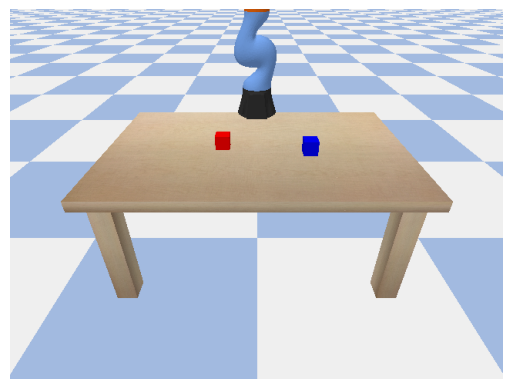

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


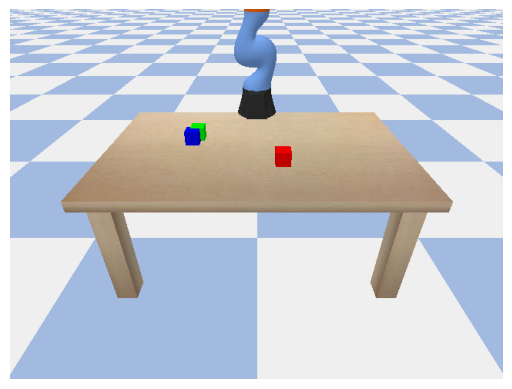

Intention: Carry red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 2))


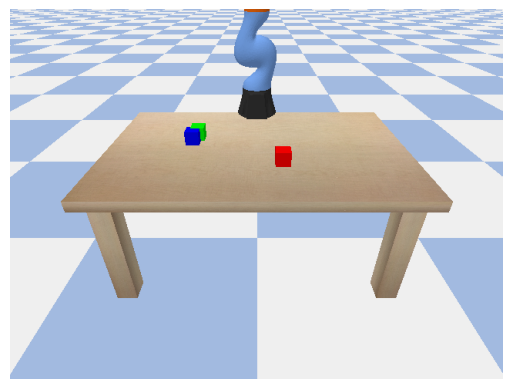

Intention: Carry red; Reward: -1; Reason: exception (name 'cube_list' is not defined)


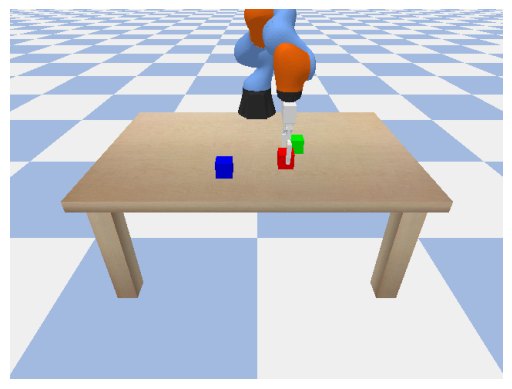

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


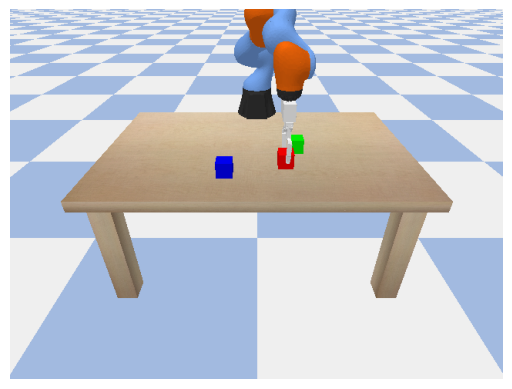

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


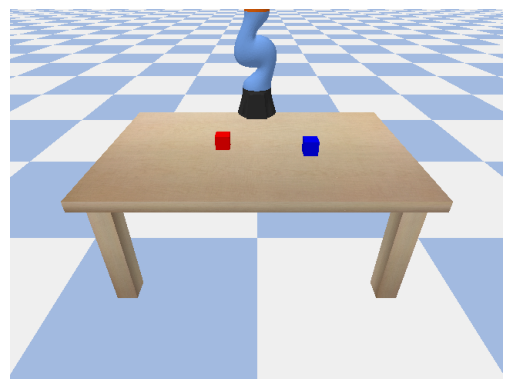

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


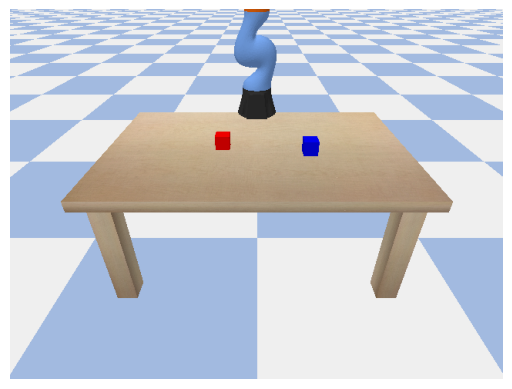

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


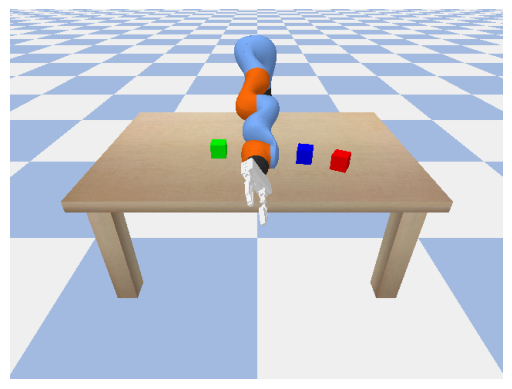

Intention: Collect blue; Reward: -1; Reason: timeout


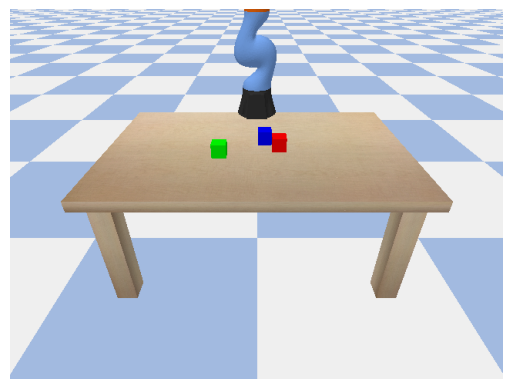

Intention: Collect blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


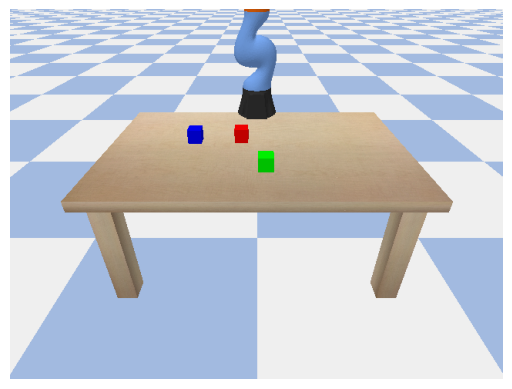

Intention: Take green; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


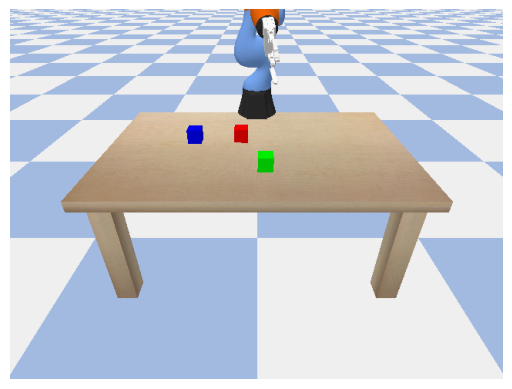

Intention: Take green; Reward: -1; Reason: timeout


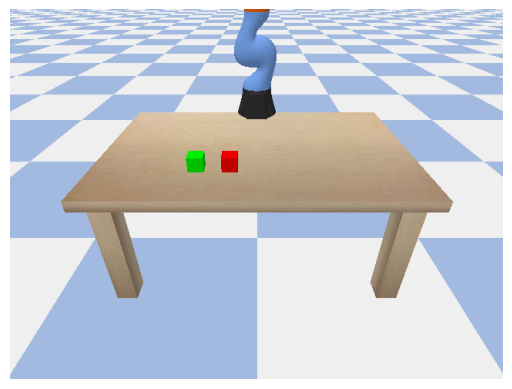

Intention: Retrieve green; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))


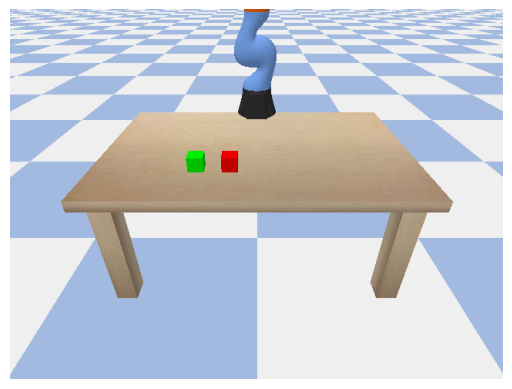

Intention: Retrieve green; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


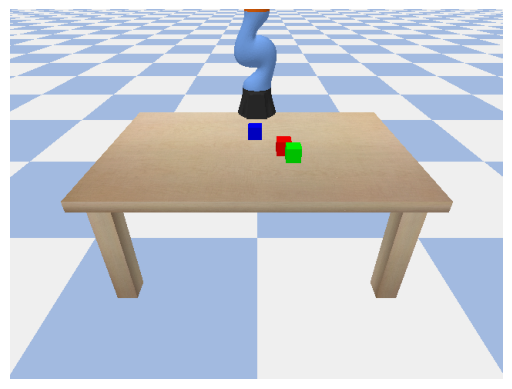

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


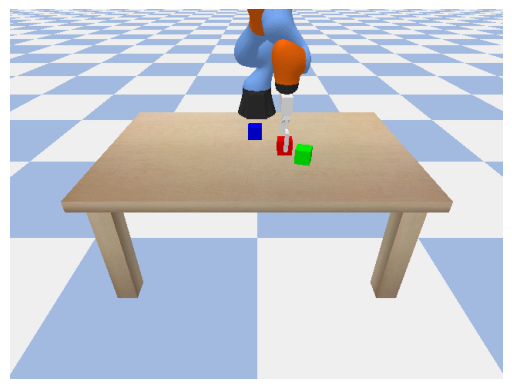

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


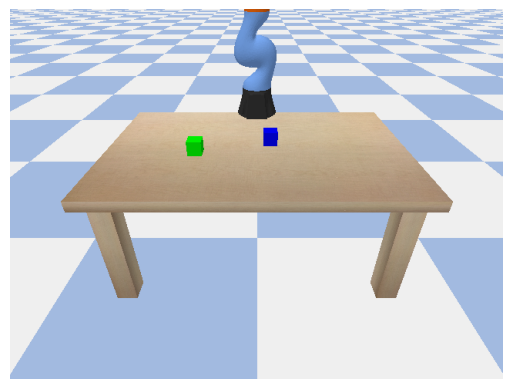

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


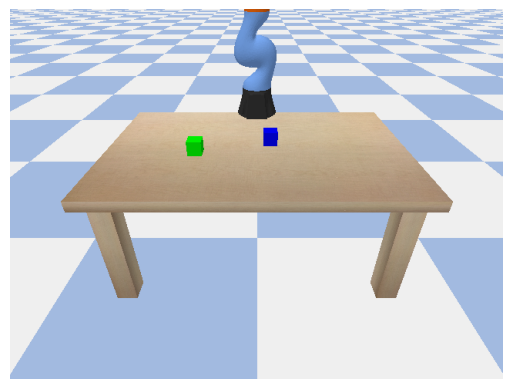

Intention: Fetch blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


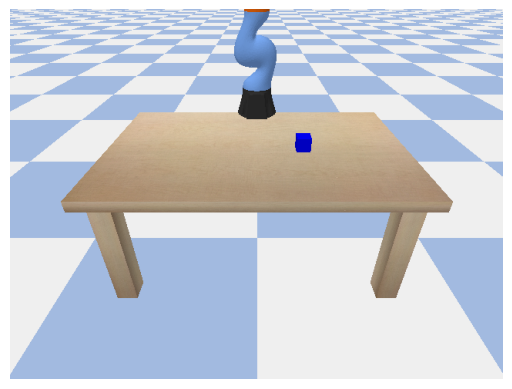

Intention: Raise blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


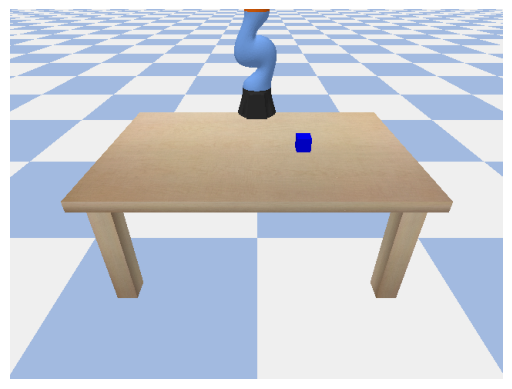

Intention: Raise blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


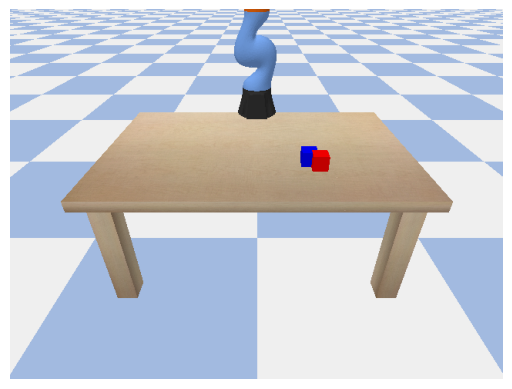

Intention: Grab blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


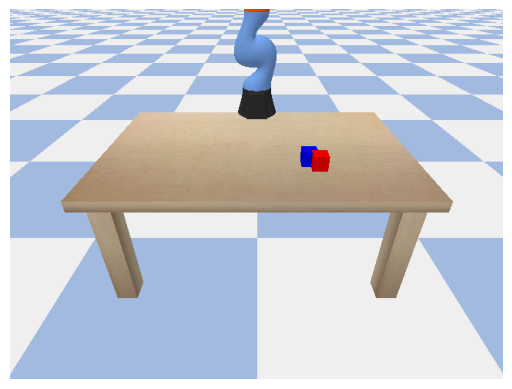

Intention: Grab blue; Reward: -1; Reason: exception (closing parenthesis ')' does not match opening parenthesis '[' (<unknown>, line 4))


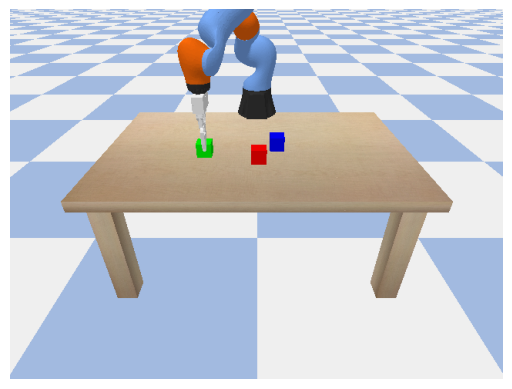

Intention: Pick green; Reward: 1; Reason: None


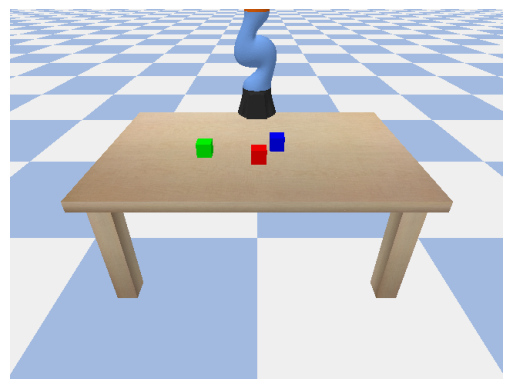

Intention: Pick green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


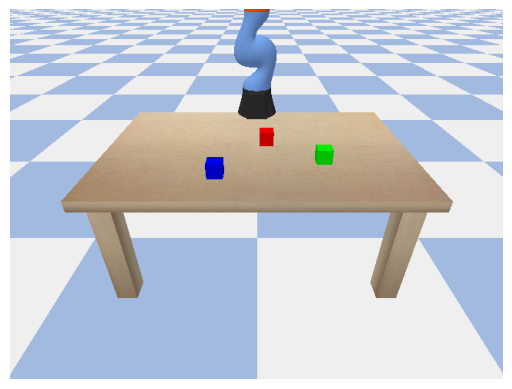

Intention: Grasp red; Reward: -1; Reason: exception (invalid syntax (<unknown>, line 29))


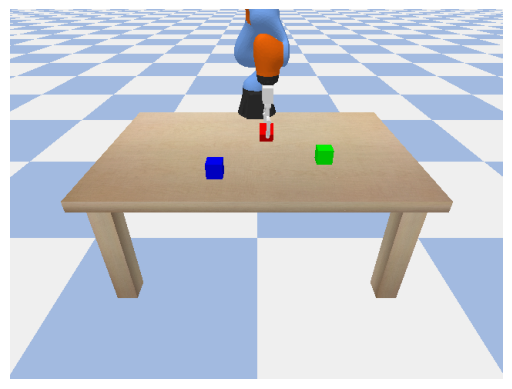

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


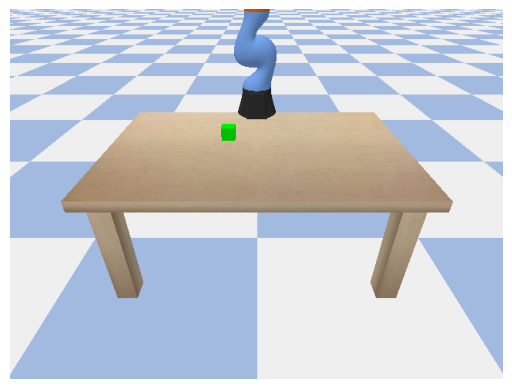

Intention: Seize green; Reward: -1; Reason: exception (closing parenthesis ')' does not match opening parenthesis '[' (<unknown>, line 2))


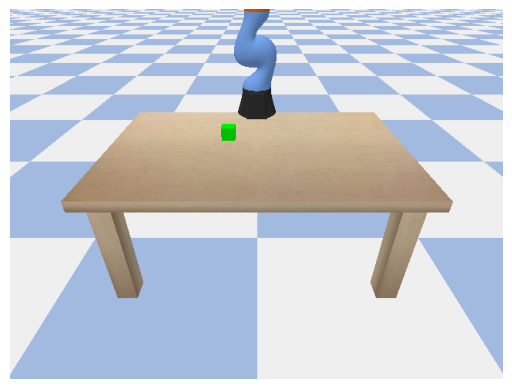

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


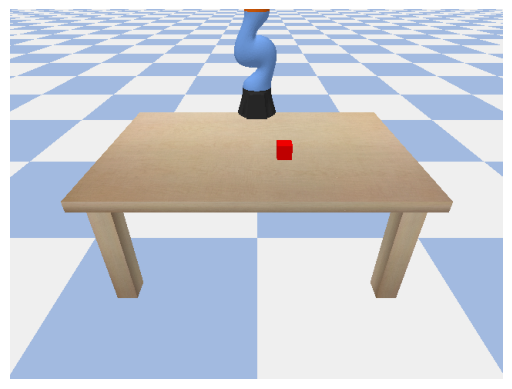

Intention: Get red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Get red; Reward: -1; Reason: extraction


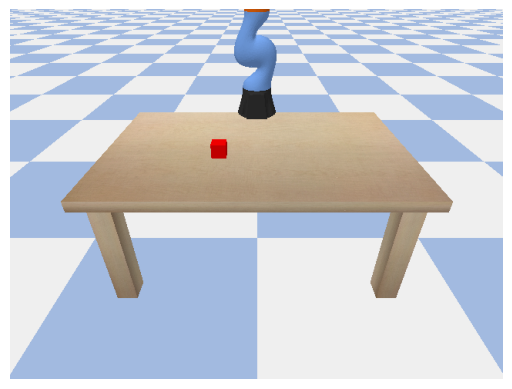

Intention: Collect red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 2))


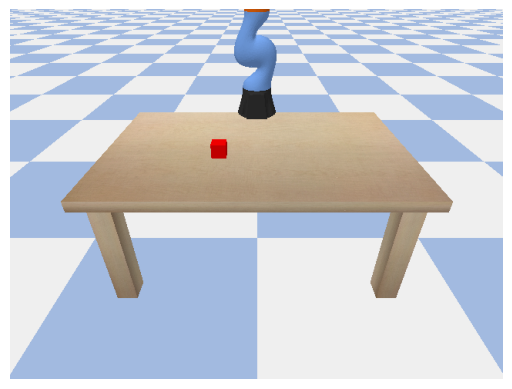

Intention: Collect red; Reward: 1; Reason: None


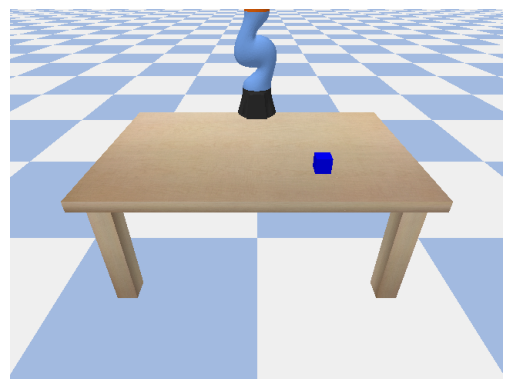

Intention: Grasp blue; Reward: -1; Reason: exception (unmatched ']' (<unknown>, line 4))


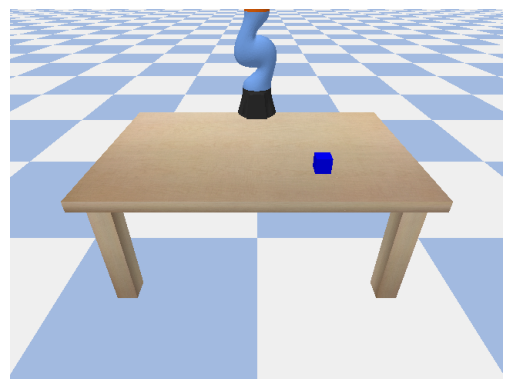

Intention: Grasp blue; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))
Intention: Get blue; Reward: -1; Reason: extraction


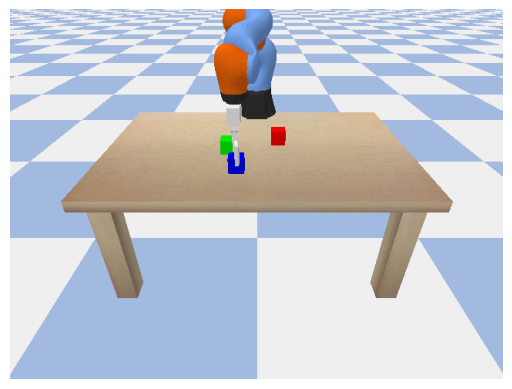

Intention: Get blue; Reward: 1; Reason: None


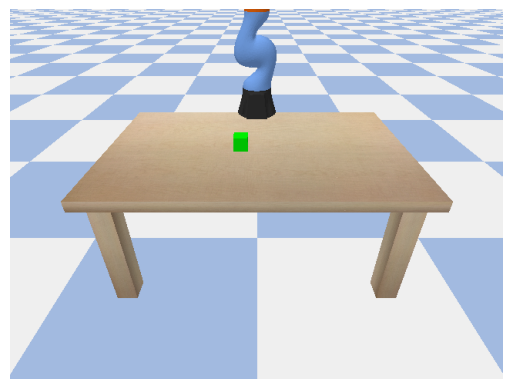

Intention: Hold green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


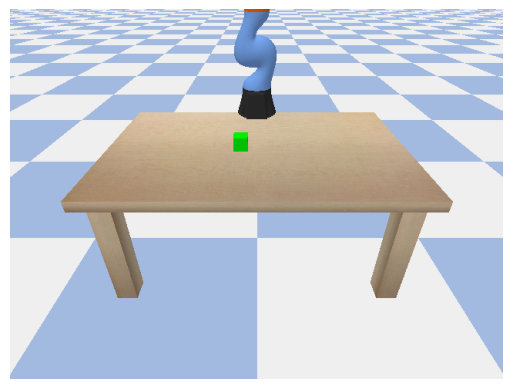

Intention: Hold green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


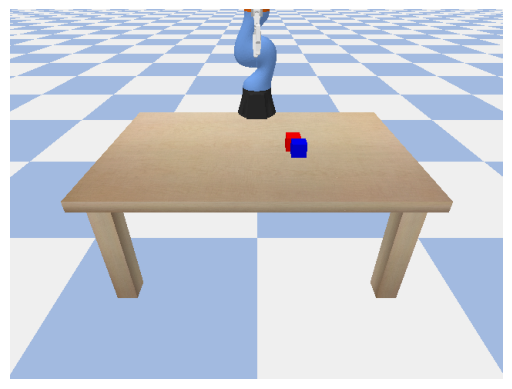

Intention: Hoist red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


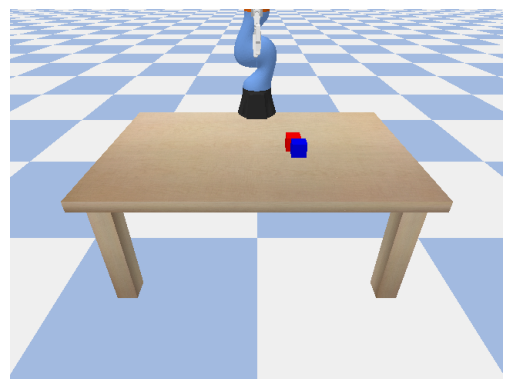

Intention: Hoist red; Reward: -1; Reason: exception (Base.move_gripper_to() missing 1 required positional argument: 'position')
Intention: Hold blue; Reward: -1; Reason: extraction


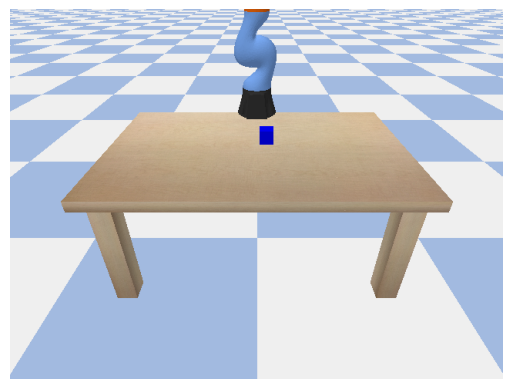

Intention: Hold blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


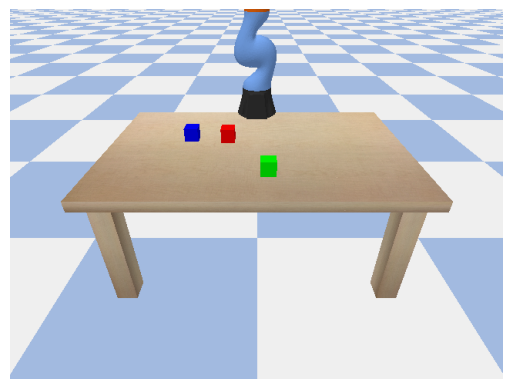

Intention: Lift red; Reward: -1; Reason: exception (name 'world' is not defined)


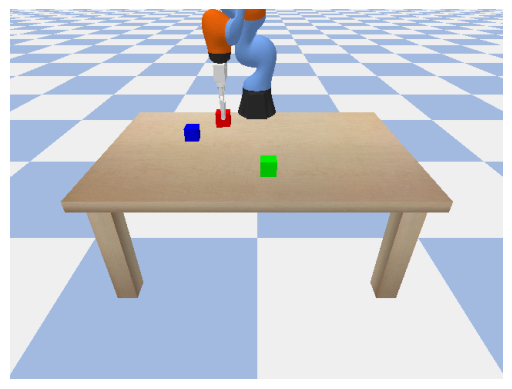

Intention: Lift red; Reward: 1; Reason: None


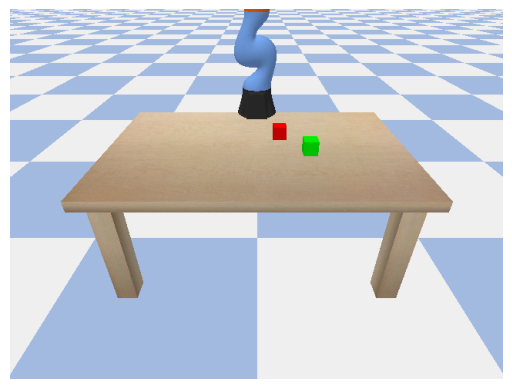

Intention: Hoist green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


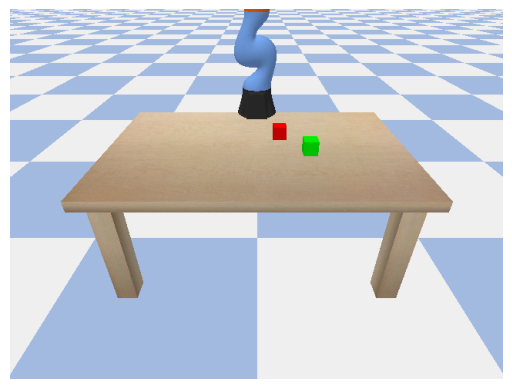

Intention: Hoist green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


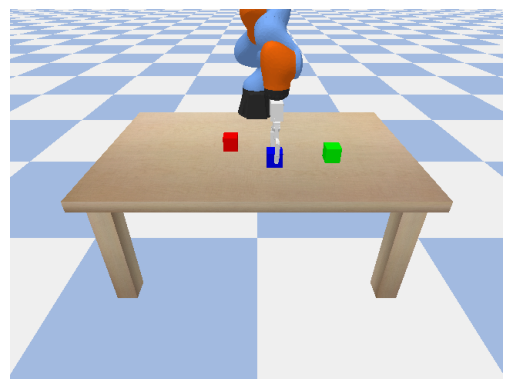

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


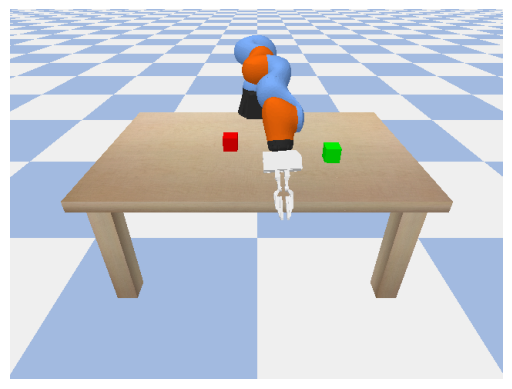

Intention: Retrieve blue; Reward: -1; Reason: timeout


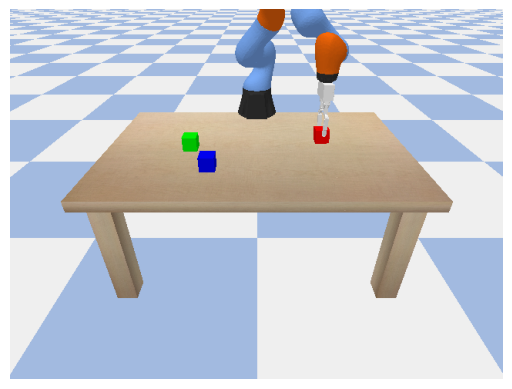

Intention: Raise red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


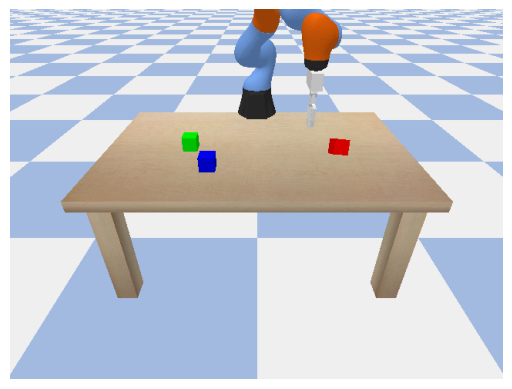

Intention: Raise red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


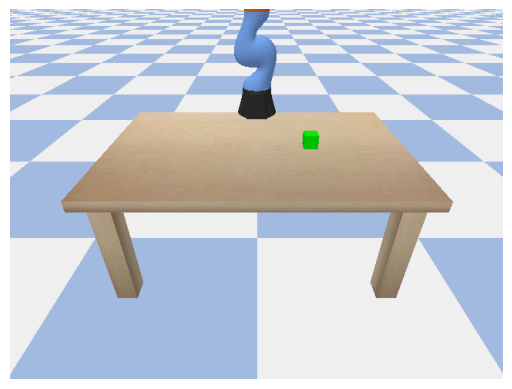

Intention: Pick green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Pick green; Reward: -1; Reason: extraction


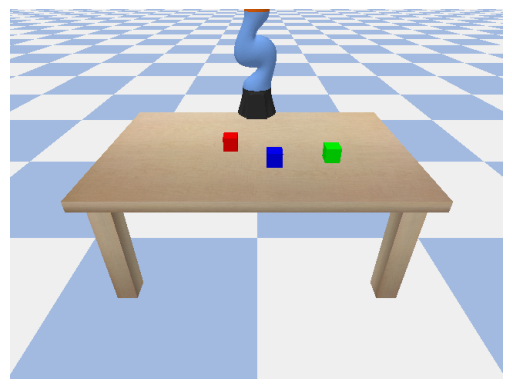

Intention: Retrieve blue; Reward: -1; Reason: exception (name 'python' is not defined)


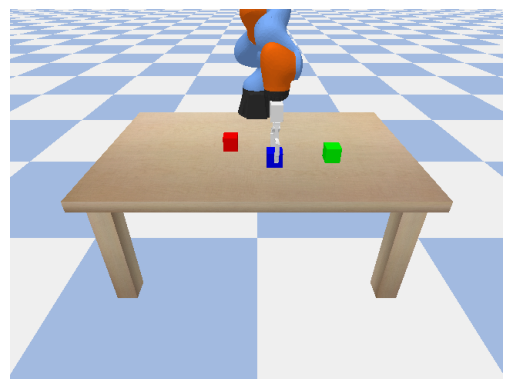

Intention: Retrieve blue; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


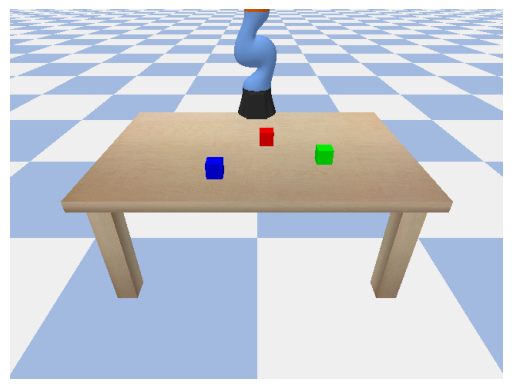

Intention: Grasp red; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


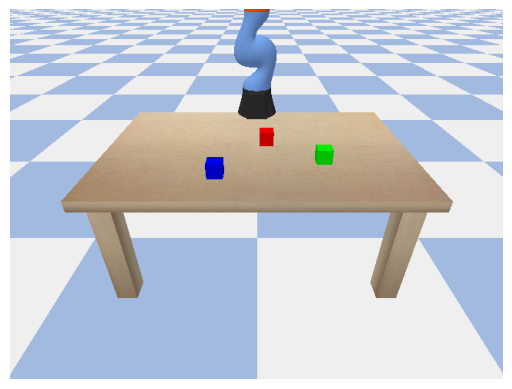

Intention: Grasp red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


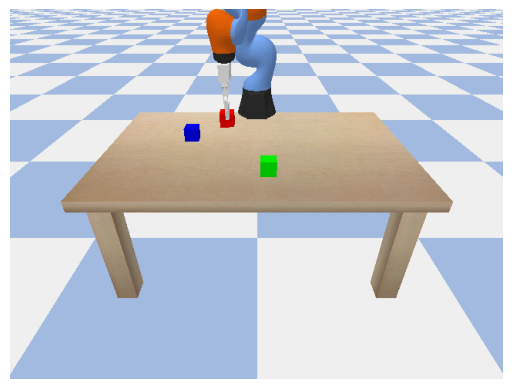

Intention: Lift red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


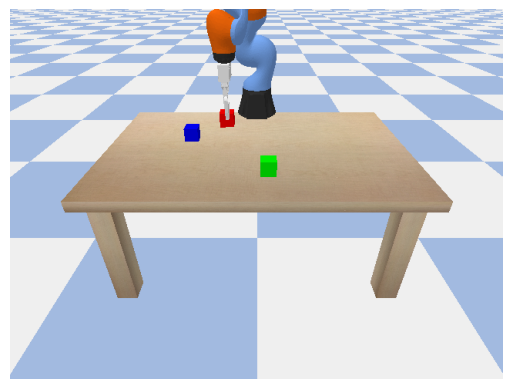

Intention: Lift red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


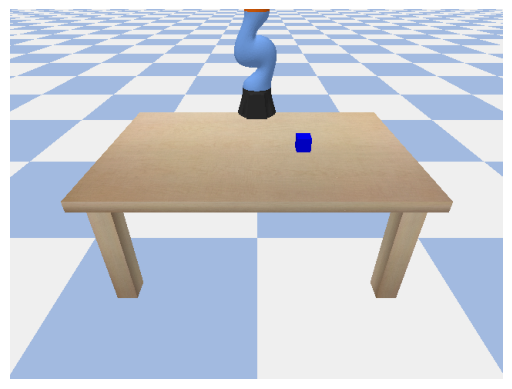

Intention: Raise blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))
Intention: Raise blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction
Intention: Hold blue; Reward: -1; Reason: extraction


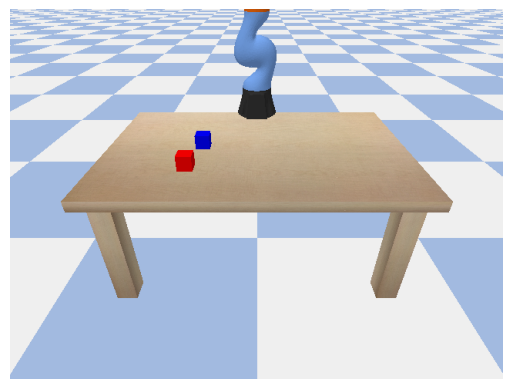

Intention: Seize red; Reward: -1; Reason: exception (unindent does not match any outer indentation level (<unknown>, line 4))


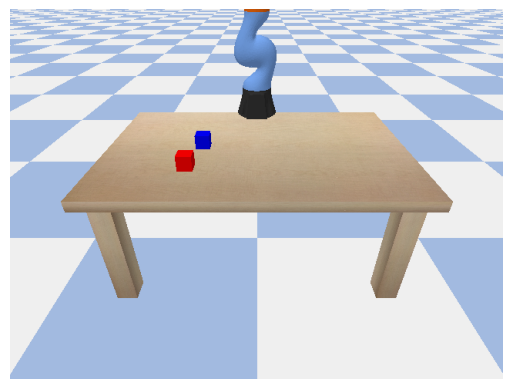

Intention: Seize red; Reward: -1; Reason: exception ('(' was never closed (<unknown>, line 3))


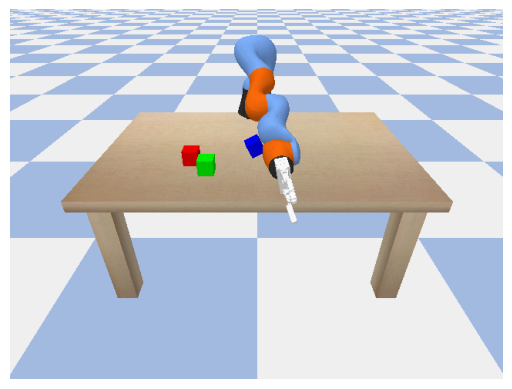

Intention: Carry blue; Reward: -1; Reason: timeout


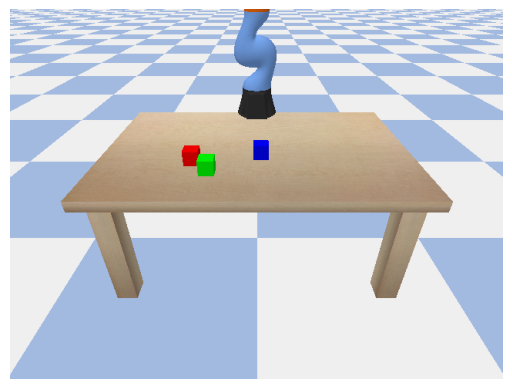

Intention: Carry blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


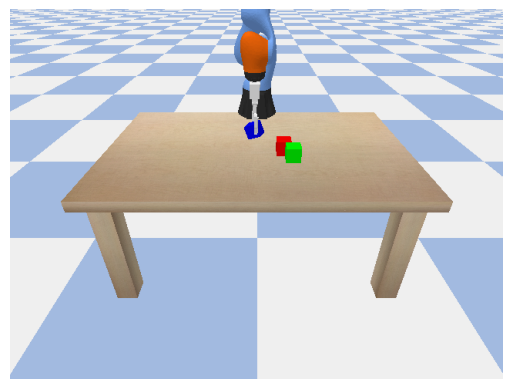

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


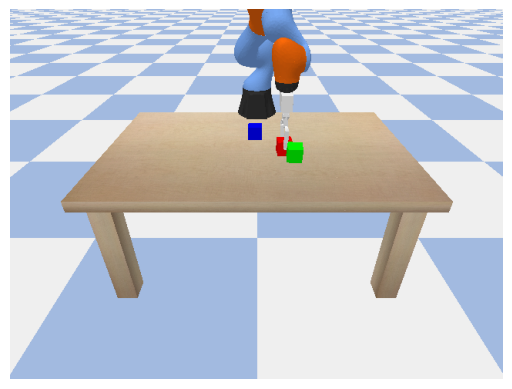

Intention: Acquire red; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


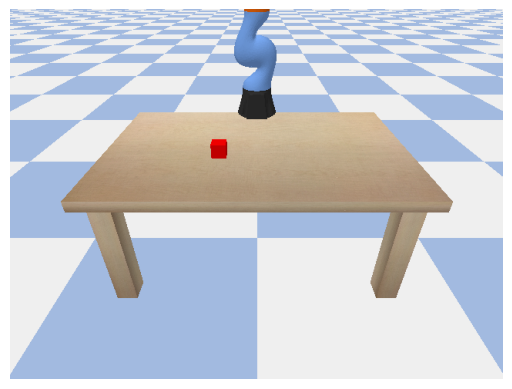

Intention: Collect red; Reward: -1; Reason: exception (expected ':' (<unknown>, line 2))


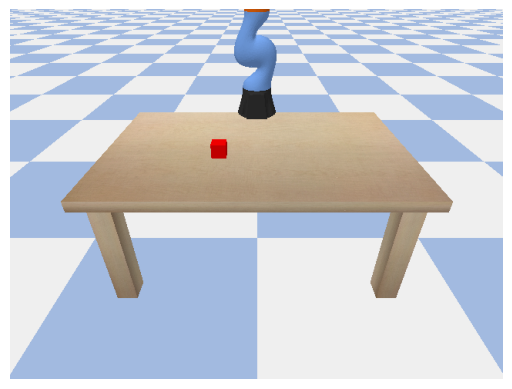

Intention: Collect red; Reward: -1; Reason: exception (unmatched ')' (<unknown>, line 3))


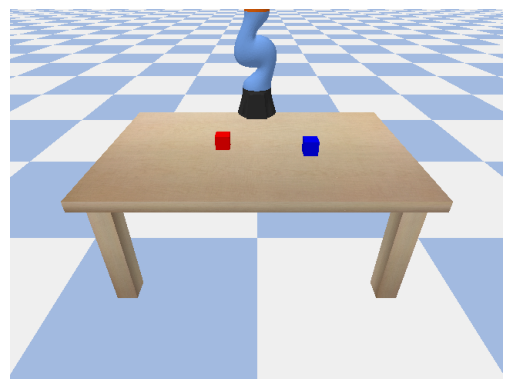

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


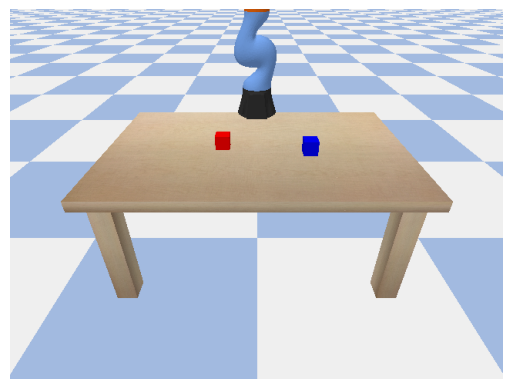

Intention: Fetch blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))
Intention: Hoist green; Reward: -1; Reason: extraction


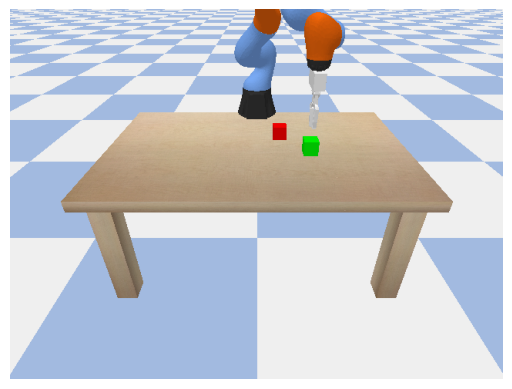

Intention: Hoist green; Reward: 0; Reason: vlm (No need to the ``**Question: 
``````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


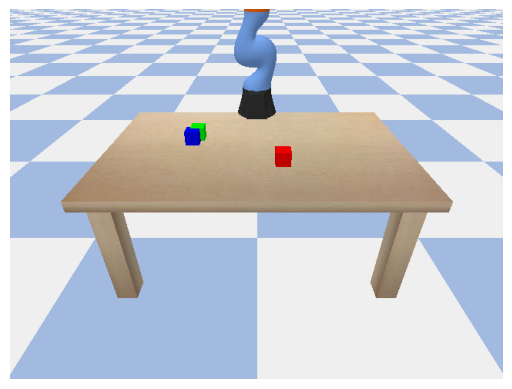

Intention: Carry red; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


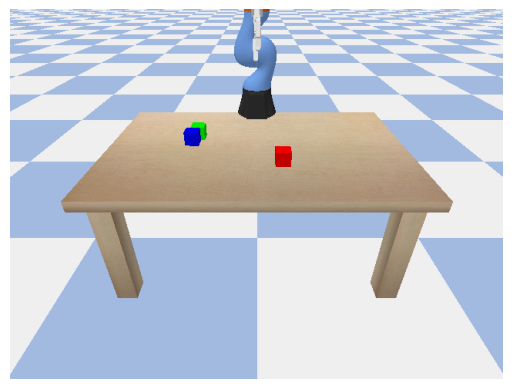

Intention: Carry red; Reward: -1; Reason: exception (name 'pick_up_robot_carton' is not defined)


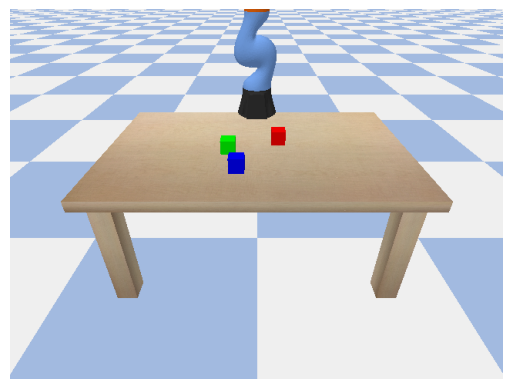

Intention: Get blue; Reward: 1; Reason: None


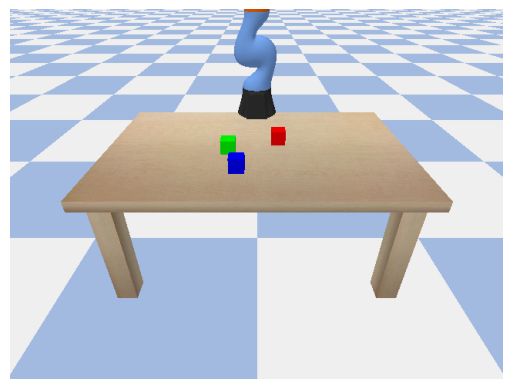

Intention: Get blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 2))


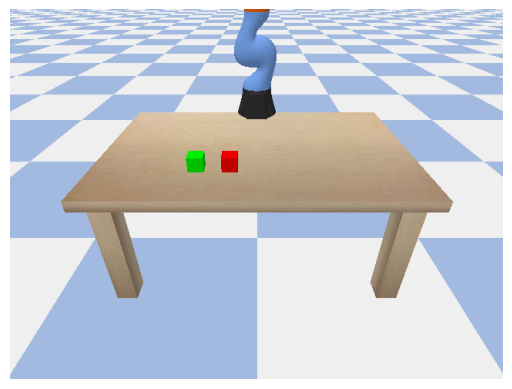

Intention: Retrieve green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


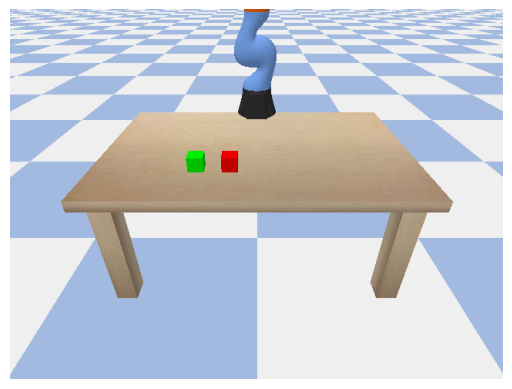

Intention: Retrieve green; Reward: 1; Reason: None


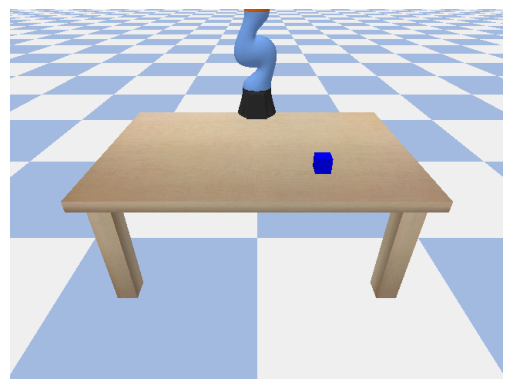

Intention: Grasp blue; Reward: -1; Reason: exception (unexpected indent (<unknown>, line 4))


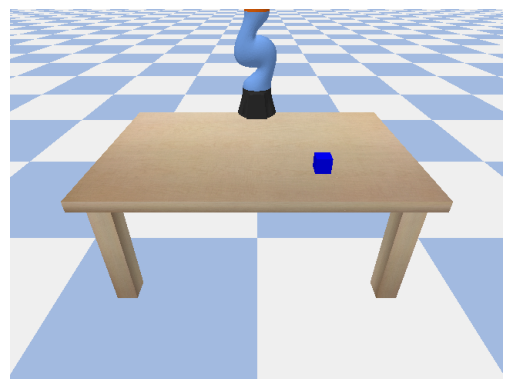

Intention: Grasp blue; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


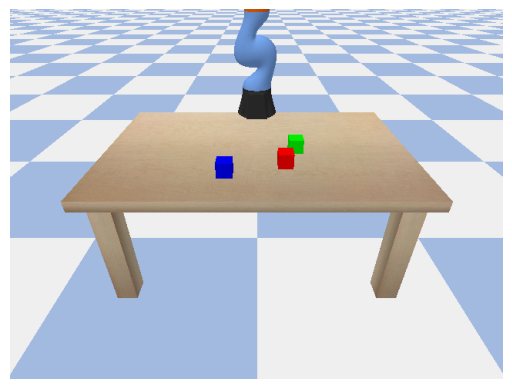

Intention: Acquire red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


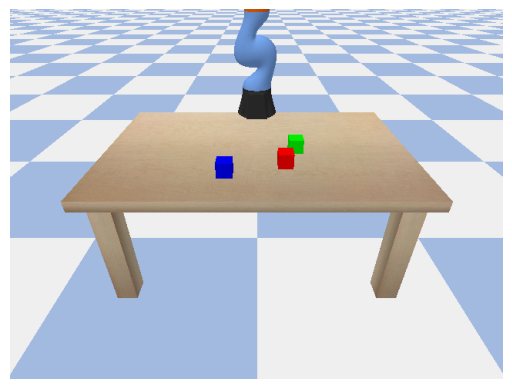

Intention: Acquire red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


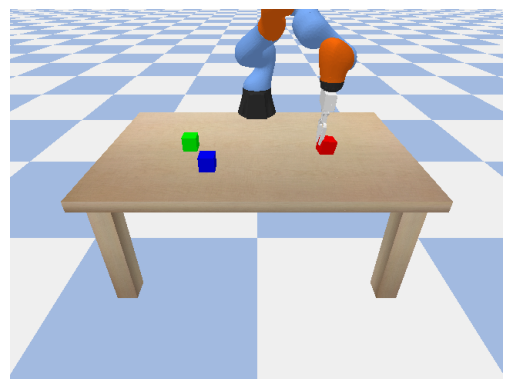

Intention: Raise red; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


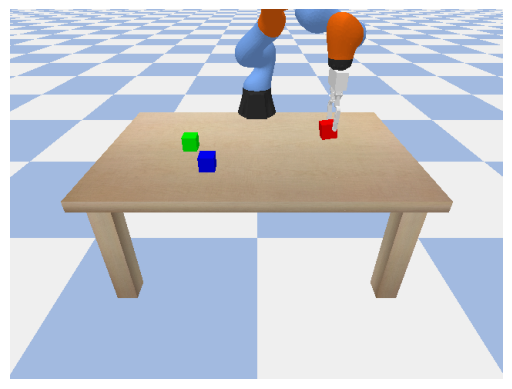

Intention: Raise red; Reward: 1; Reason: None


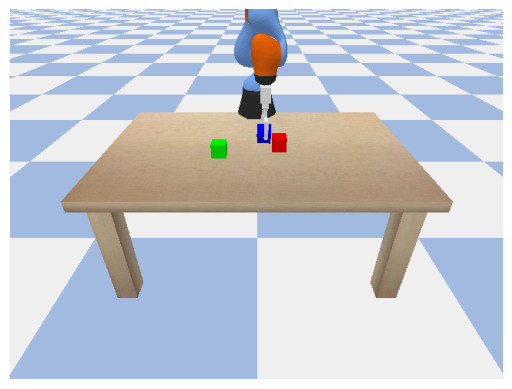

Intention: Collect blue; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


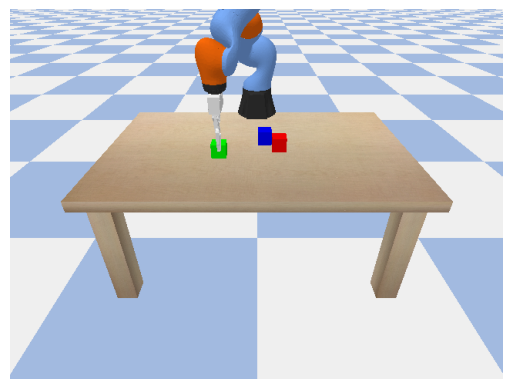

Intention: Collect blue; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


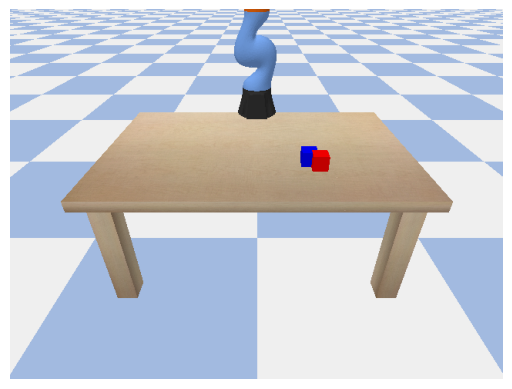

Intention: Grab blue; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


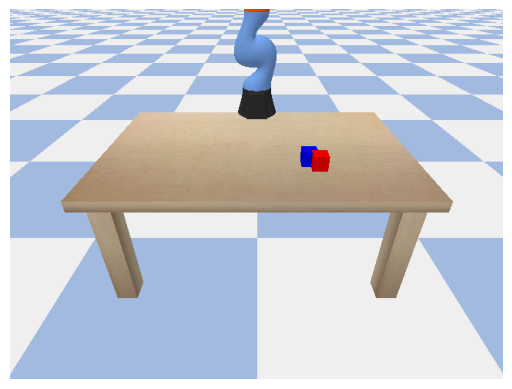

Intention: Grab blue; Reward: -1; Reason: exception (closing parenthesis ']' does not match opening parenthesis '(' (<unknown>, line 8))
Intention: Hold green; Reward: -1; Reason: extraction
Intention: Hold green; Reward: -1; Reason: extraction


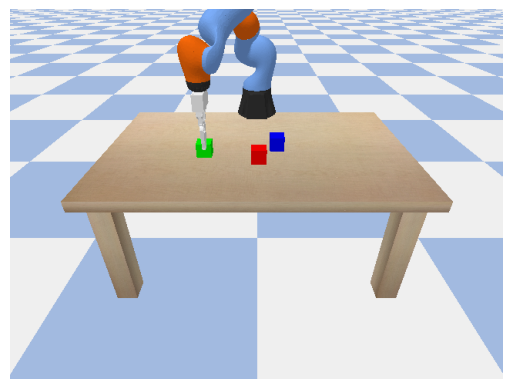

Intention: Pick green; Reward: 1; Reason: None


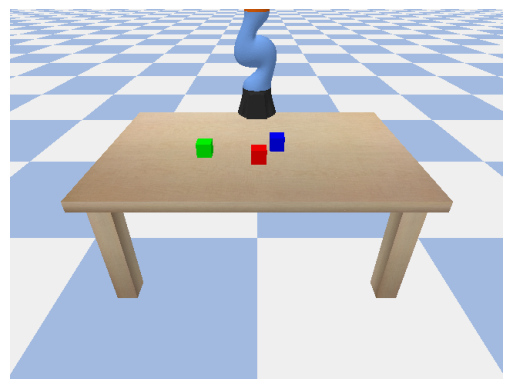

Intention: Pick green; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


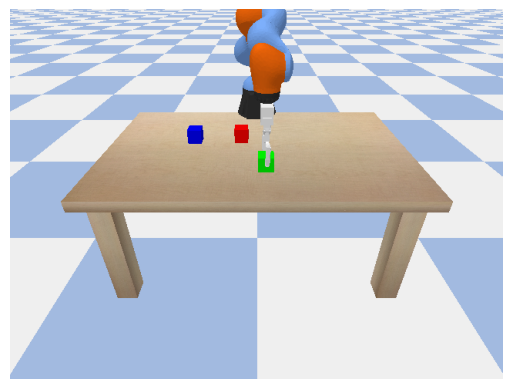

Intention: Take green; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)


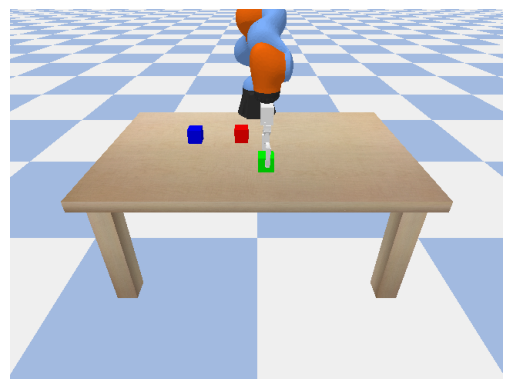

Intention: Take green; Reward: 0; Reason: vlm (No need to 
````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````````)
Intention: Seize green; Reward: -1; Reason: extraction


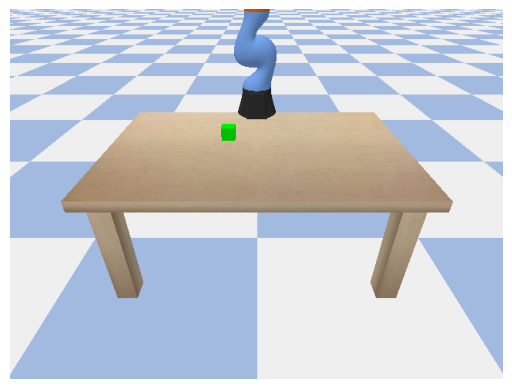

Intention: Seize green; Reward: -1; Reason: exception (expected an indented block after function definition on line 1 (<string>, line 1))


In [7]:
with PyBulletContext(False):
    base = Base()

    generated_dataset = generate_train_dataset()
    train_dataset = tokenize_dataset(tokenizer, generated_dataset)

    #trainer = RLOOTrainer(
    #    model=model,
    #    args=training_args,
    #    reward_funcs=[reward_function],
    #    train_dataset=train_dataset,
    #    processing_class=tokenizer
    #)

    trainer = GRPOTrainer(
        model=model,
        processing_class=tokenizer,
        args=training_args,
        reward_funcs=[reward_function],
        train_dataset=train_dataset,
    )

    trainer.train()

In [8]:
train_dataset[0]

{'method_args': {'intention': 'Lift blue',
  'intention_object': 'blue',
  'intention_verb': 'Lift {}',
  'objects': [{'color': 'blue', 'position': [-0.08, 0.19, 0.66], 'size': 0.07},
   {'color': 'red', 'position': [-0.07, 0.32, 0.66], 'size': 0.07}]},
 'prompt': '<|im_start|>system\n\nYou are a Python 3 code generator. You are the controller of an robotic arm, that uses Python for interaction.\nPlease write and call your written Python 3 function with the name main for the command. \nProvide the code using python``` and ```.\n\nExample:\n    World:\n    cube [blue] (size=[0.07, 0.07, 0.07]; center_position=[0.07, 0.11, 0.66])\n\n    Intention:\n    Lift blue\n\n    Output:\n    python```\n    def main():\n        move_gripper_to((0.07, 0.11, 0.66))\n        close_gripper()\n        move_gripper_to((0.07, 0.11, 0.75))\n\n    main()\n    ```\n\nUse only the provided functions.\nFunctions:\nfunction open_gripper(): void\nfunction close_gripper(): void\nfunction move_gripper_to(position:

In [9]:
trainer.state.log_history

[{'loss': -0.0788,
  'grad_norm': 2.046875,
  'learning_rate': 1e-06,
  'num_tokens': 6567.0,
  'completions/mean_length': 49.9375,
  'completions/min_length': 6.0,
  'completions/max_length': 108.0,
  'completions/clipped_ratio': 0.0,
  'completions/mean_terminated_length': 49.9375,
  'completions/min_terminated_length': 6.0,
  'completions/max_terminated_length': 108.0,
  'rewards/reward_function/mean': -0.4375,
  'rewards/reward_function/std': 0.7274384498596191,
  'reward': -0.4375,
  'reward_std': 0.2651650309562683,
  'frac_reward_zero_std': 0.625,
  'entropy': 0.48383890092372894,
  'clip_ratio/low_mean': 0.0,
  'clip_ratio/low_min': 0.0,
  'clip_ratio/high_mean': 0.0,
  'clip_ratio/high_max': 0.0,
  'clip_ratio/region_mean': 0.0,
  'epoch': 0.3333333333333333,
  'step': 1},
 {'loss': -0.0561,
  'grad_norm': 5.375,
  'learning_rate': 9.666666666666666e-07,
  'num_tokens': 12370.0,
  'completions/mean_length': 29.9375,
  'completions/min_length': 2.0,
  'completions/max_length': 